# Libraries, data and installs

In [1]:
import tensorflow as tf
tf.config.list_physical_devices("GPU")


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [1]:
#!pip3 install visualkeras
!pip3 install -U numpy==1.18.5


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 10.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  error: subprocess-exited-with-error
  
  × Building wheel for numpy (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for numpy
Failed to build numpy
ERROR: Could not build wheels for numpy, which is required to install pyproject.toml-based projects


In [12]:
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
from keras.layers import Input, Dense, Dropout
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Add, Multiply
from keras.layers import ELU, PReLU, LeakyReLU
from keras.models import Model
from keras.utils.vis_utils import plot_model
from tensorflow.keras import optimizers
from keras.optimizers import SGD
from keras.optimizers import Adagrad
from keras import metrics
from sklearn.metrics import r2_score
from keras.callbacks import EarlyStopping
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.layers.experimental.preprocessing import Normalization
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.densenet import DenseNet121

from tensorflow.keras.layers import GlobalAveragePooling2D


from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import StandardScaler

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import math as m
import numpy as np
import seaborn as sns
sns.set_style("darkgrid")
edgecolors=None



In [1]:
'''
Nomenclature:

<DATASET-INITIALS><FRUIT-INITIAL><TEST-INITIAL>.csv|.pkl

DATASET-INITIALS:
CG = Classic Geometry
F = Form
C = Color
A = All
CI = Cropped Images

FRUIT-INITIAL:
B = Blueberry
R = Raspberry
S = Strawberry

TEST-INITIAL:
R = Raw
Y = YOLO
D = Detectron2

---------------------

EXAMPLES

CLASSIC GEOMETRY of RASPBERRIES from RAW test
CGRR.csv

CROPPED IMAGES of BLUEBERRIES from YOLO test
CIBY.pkl

---------------------

Cropped images are the only datasets that are saved in a pickle file


'''

#-----------------Blueberries------------------
###############################################
#Blueberries - RAW
#ClassicGeometry
!wget -O CGBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
#Form
!wget -O FBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
#Color
!wget -O CBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsBlueberriesRaw.csv
#All
!wget -O ABR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesBlueberriesRaw.csv
#Images
!wget -O CIBR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesRaw.pkl
###############################################
#Blueberries - YOLO
#ClassicGeometry
!wget -O CGBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLOBlue.csv
#Form
!wget -O FBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLOBlue.csv
#Color
!wget -O CBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLOBlue.csv
#All
!wget -O ABY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLOBlue.csv
#Images
!wget -O CIBY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesYOLO.pkl
###############################################
#Blueberries - Detectron2
#ClassicGeometry
!wget -O CGBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2blue.csv
#Form
!wget -O FBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2blue.csv
#Color
!wget -O CBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2blue.csv
#All
!wget -O ABD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2blue.csv
#Images
!wget -O CIBD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Raspberries------------------
###############################################
#Raspberries - RAW
#ClassicGeometry
!wget -O CGRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryRaspberriesRaw.csv
#Form
!wget -O FRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsRaspberriesRaw.csv
#Color
!wget -O CRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsRaspberriesRaw.csv
#All
!wget -O ARR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesRaspberriesRaw.csv
#Images
!wget -O CIRR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesRaw.pkl
###############################################
#Raspberries - YOLO
#ClassicGeometry
!wget -O CGRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLORasp.csv
#Form
!wget -O FRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLORasp.csv
#Color
!wget -O CRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLORasp.csv
#All
!wget -O ARY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLORasp.csv
#Images
!wget -O CIRY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesYOLO.pkl
###############################################
#Raspberries - Detectron2
#ClassicGeometry
!wget -O CGRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2rasp.csv
#Form
!wget -O FRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2rasp.csv
#Color
!wget -O CRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2rasp.csv
#All
!wget -O ARD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2rasp.csv
#Images
!wget -O CIRD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Strawberries------------------
###############################################
#Strawberries - RAW
#ClassicGeometry
!wget -O CGSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesRaw.csv
#Form
!wget -O FSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesRaw.csv
#Color
!wget -O CSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesRaw.csv
#All
!wget -O ASR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesRaw.csv
#Images
!wget -O CISR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesRaw.pkl
###############################################
#Strawberries - YOLO
#ClassicGeometry
!wget -O CGSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesYOLO.csv
#Form
!wget -O FSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesYOLO.csv
#Color
!wget -O CSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesYOLO.csv
#All
!wget -O ASY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesYOLO.csv
#Images
!wget -O CISY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesYOLO.pkl
###############################################
#Strawberries - Detectron2
#ClassicGeometry
!wget -O CGSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2straw.csv
#Form
!wget -O FSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2straw.csv
#Color
!wget -O CSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2straw.csv
#All
!wget -O ASD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2straw.csv
#Images
!wget -O CISD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================

%mkdir figures


--2023-05-02 00:20:06--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8002::154, 2606:50c0:8003::154, 2606:50c0:8000::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8002::154|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3559 (3.5K) [text/plain]
Saving to: ‘CGBR.csv’

CGBR.csv            100%[===================>]   3.48K  --.-KB/s    in 0.001s  

2023-05-02 00:20:06 (2.84 MB/s) - ‘CGBR.csv’ saved [3559/3559]

--2023-05-02 00:20:06--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 2606:50c0:8003::154, 2606:50c0:8000::154, 2606:50c0:8001::154, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|2606:50c0:8003::154|:443... connected.
HTTP request sent, awaiting re

# Data analysis

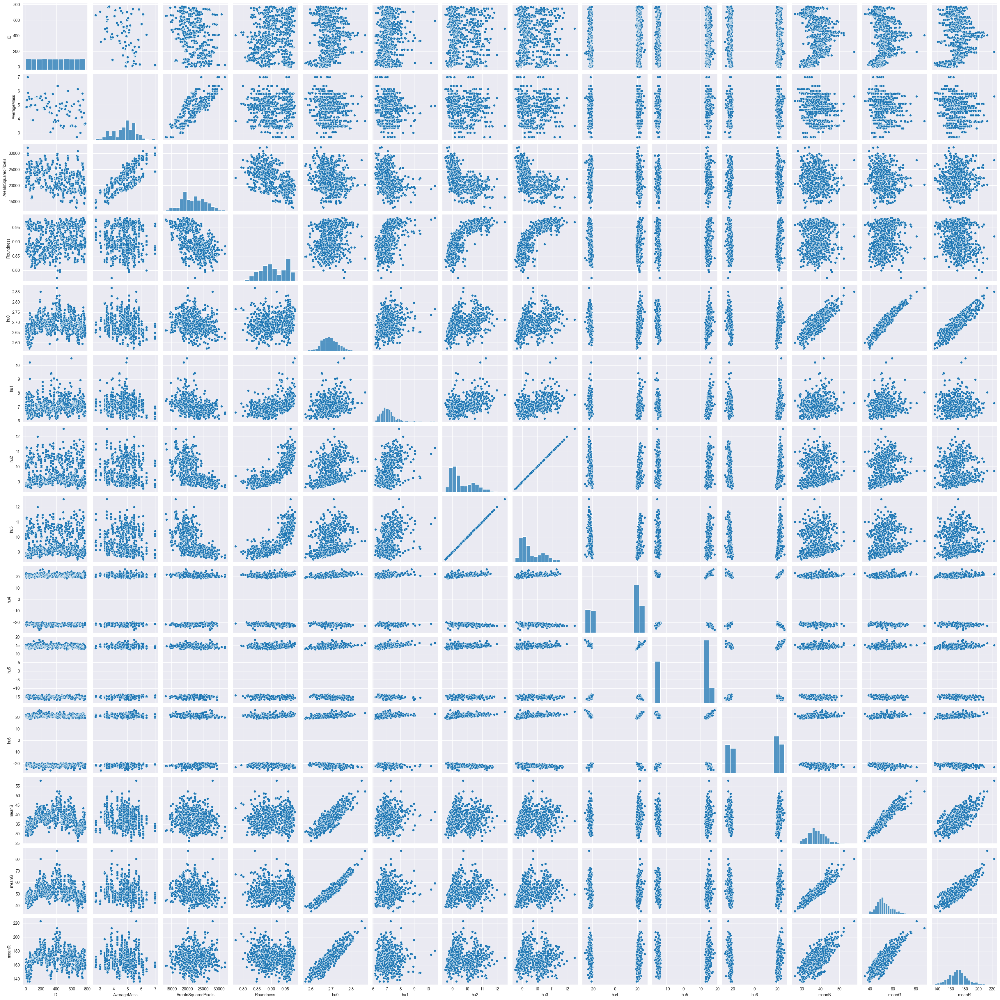

In [5]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")

sns.pairplot(testdf)


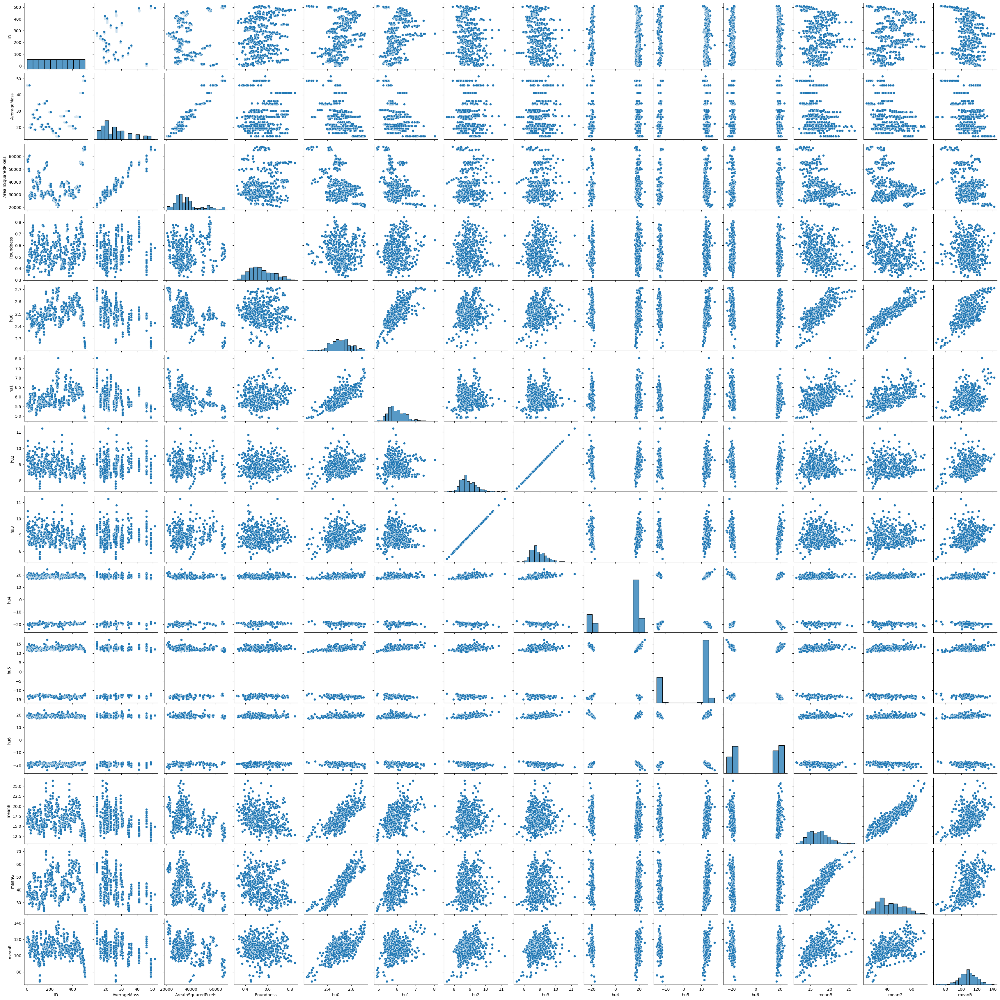

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

sns.pairplot(testdf)


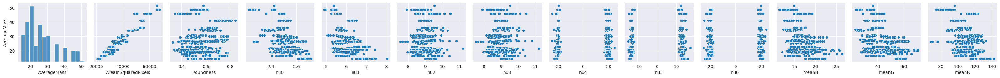

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

testdf = testdf.drop(['ID'], axis=1)

pp = sns.pairplot(data=testdf,
                  y_vars=['AverageMass'])

plt.savefig("./figures/StrawberriesPairplotAverageMass", dpi=300)




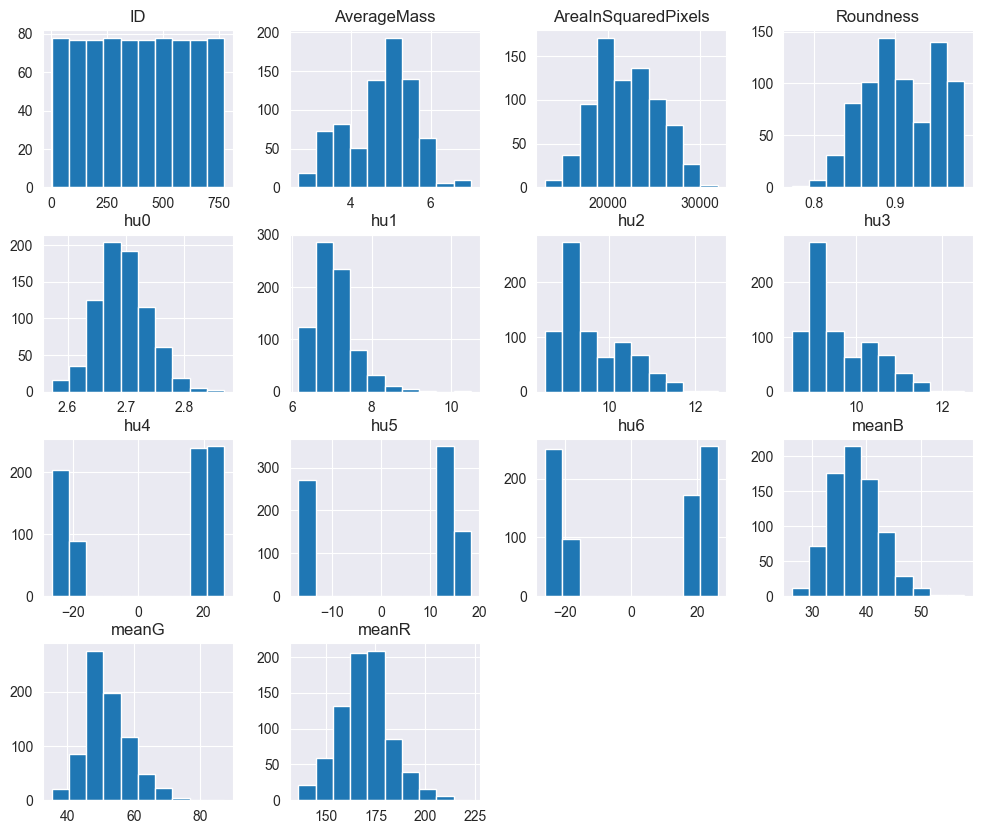

In [6]:
testdf.hist(figsize = (12,10))
plt.show()

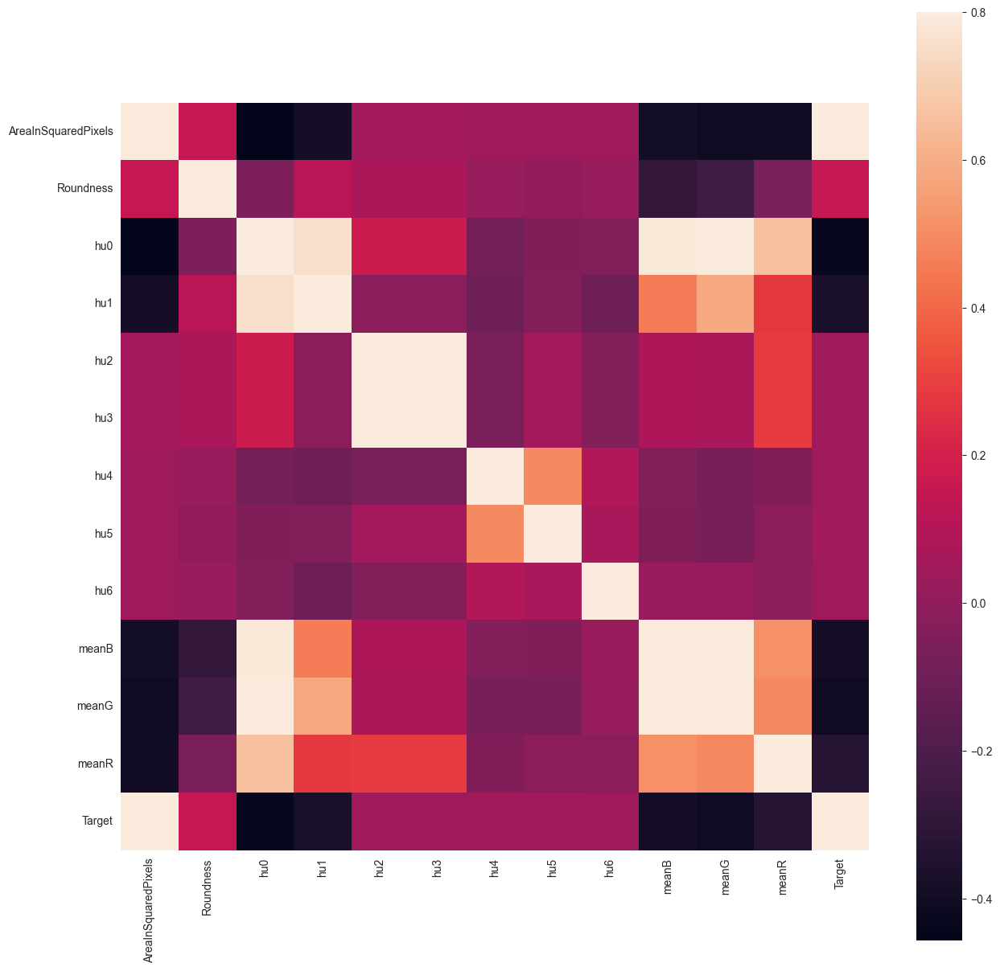

In [7]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)

testdf['Target'] = testdf['AverageMass']
testdf = testdf.drop(["AverageMass"], axis = 1)
C_mat = testdf.corr()
fig = plt.figure(figsize = (15,15))

sns.heatmap(C_mat, vmax = .8, square = True)
plt.show()

<AxesSubplot: >

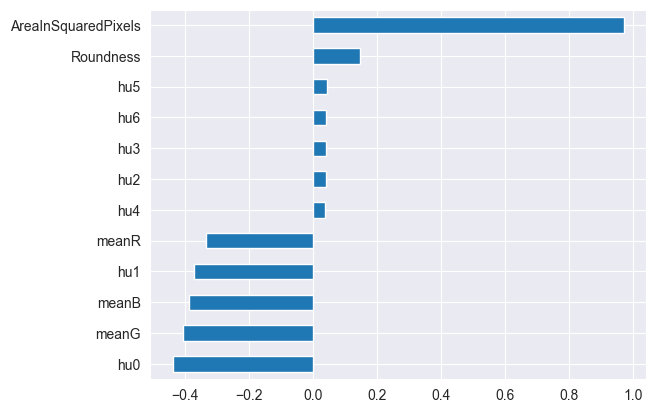

In [8]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

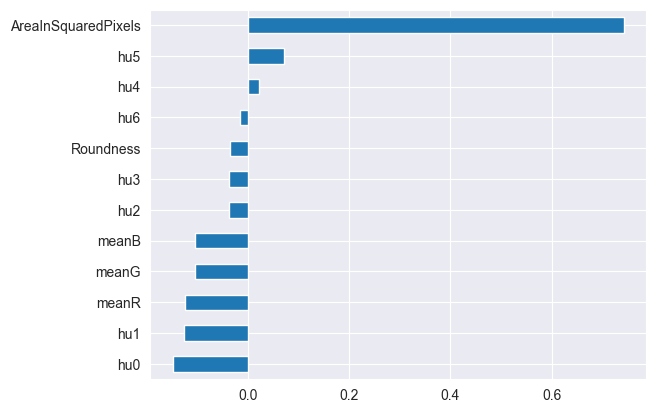

In [9]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

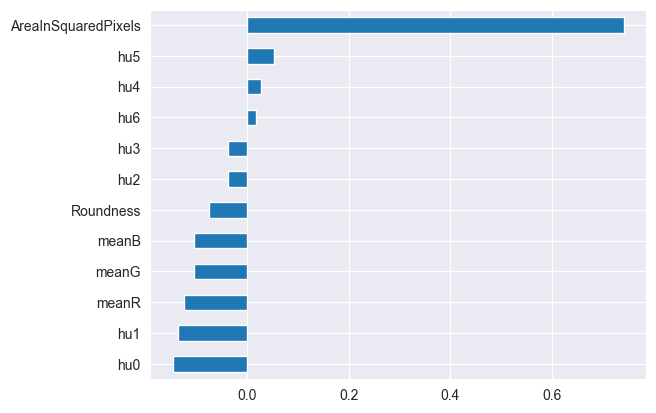

In [10]:
testdf = pd.read_csv("allfeaturesYOLORasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

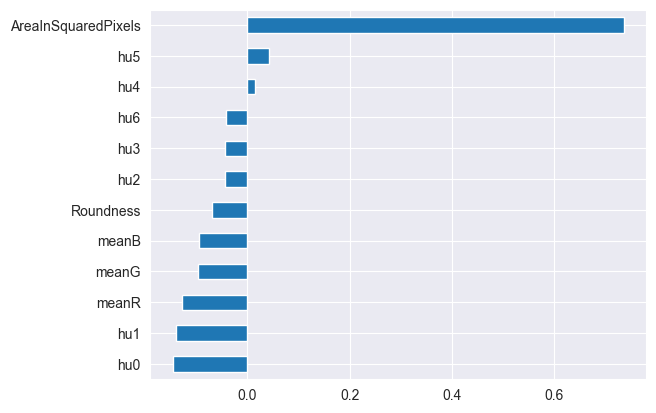

In [11]:
testdf = pd.read_csv("allfeaturesDetectron2rasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()



<AxesSubplot: >

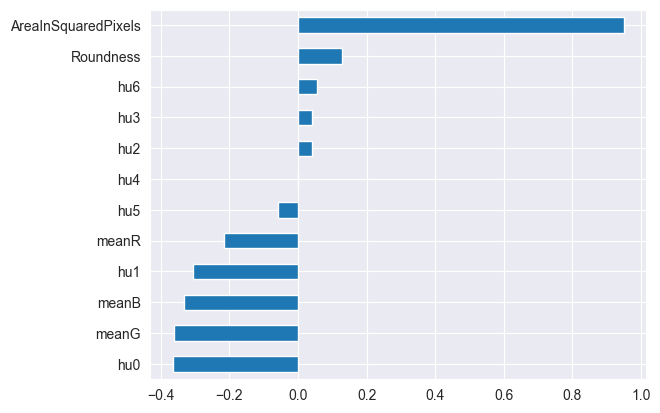

In [12]:
#checando correlacion no lineal con spearman
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr(method= 'spearman')["AverageMass"].sort_values()[:-1].plot.barh()


In [13]:
testdf.corr().style.background_gradient(cmap='coolwarm')


,AverageMass,AreaInSquaredPixels,Roundness,hu0,hu1,hu2,hu3,hu4,hu5,hu6,meanB,meanG,meanR
AverageMass,1.000000,0.971616,0.147975,-0.436478,-0.372183,0.041011,0.041011,0.037208,0.045287,0.041830,-0.386290,-0.404366,-0.333780
AreaInSquaredPixels,0.971616,1.000000,0.148809,-0.456898,-0.384775,0.054358,0.054358,0.037499,0.042792,0.035218,-0.389722,-0.406470,-0.399383
Roundness,0.147975,0.148809,1.000000,-0.055411,0.117716,0.070617,0.070617,0.016065,0.003740,0.016817,-0.289358,-0.244875,-0.065841
hu0,-0.436478,-0.456898,-0.055411,1.000000,0.756037,0.172867,0.172867,-0.085603,-0.049323,-0.041409,0.788042,0.893985,0.654910
hu1,-0.372183,-0.384775,0.117716,0.756037,1.000000,-0.019207,-0.019207,-0.102314,-0.034972,-0.104948,0.460615,0.580435,0.276126
hu2,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu3,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu4,0.037208,0.037499,0.016065,-0.085603,-0.102314,-0.067787,-0.067787,1.000000,0.493780,0.096488,-0.040366,-0.072974,-0.049212
hu5,0.045287,0.042792,0.003740,-0.049323,-0.034972,0.052346,0.052346,0.493780,1.000000,0.064254,-0.045144,-0.072504,-0.015929
hu6,0.041830,0.035218,0.016817,-0.041409,-0.104948,-0.043903,-0.043903,0.096488,0.064254,1.000000,0.027822,0.018287,-0.019152


<AxesSubplot: >

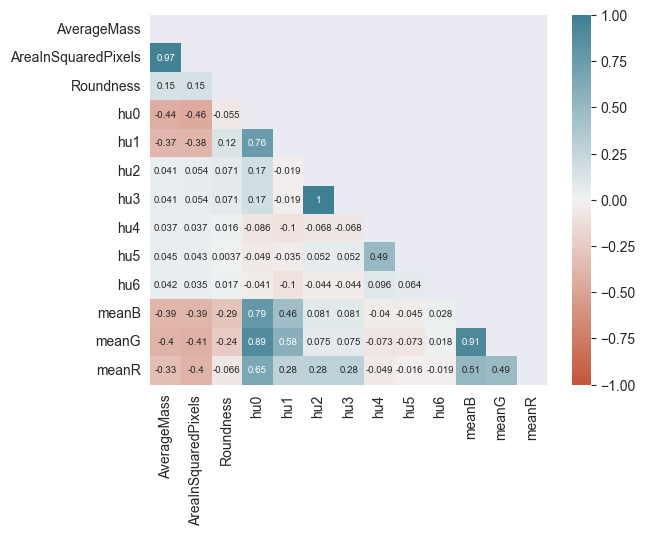

In [14]:

corrmat = testdf.corr()
mask= np.zeros_like(corrmat)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrmat,
            vmax=1, vmin=-1,
            annot=True, annot_kws={'fontsize':7},
            mask=mask,
            cmap=sns.diverging_palette(20,220,as_cmap=True))

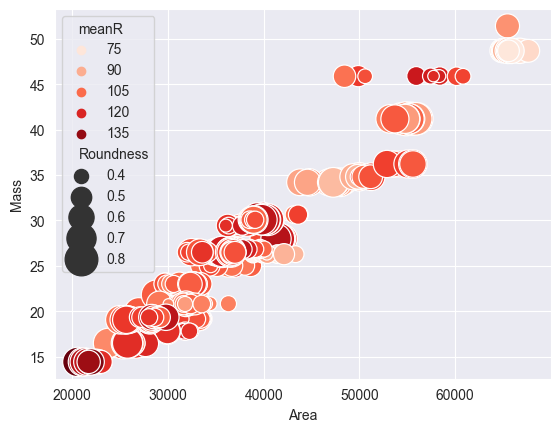

In [15]:
sns.scatterplot(data = testdf, x=testdf['AreaInSquaredPixels'], y=testdf['AverageMass'],
               size=testdf['Roundness'], hue=testdf['meanR'],
               sizes=(20,600),
               palette='Reds')

plt.xlabel('Area')
plt.ylabel('Mass')
plt.savefig("./figures/StrawberriesRawAreaVsMassAndRoundnessAndMeanRed", dpi=300)


# Deep learning

In [3]:
print(tf.__version__)
!pip3 install tensorflow_addons


2.9.0
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [4]:
!pip3 install tensorflow-addons==0.16.1


Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [5]:
#%reload_ext tensorboard

#%rm -rf "logs/fit"

import tensorflow_addons as tfa
from tensorflow_addons.metrics import RSquare


/Users/pablo/Library/Python/3.9/lib/python/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.6.0 and strictly below 2.9.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.9.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [6]:
!pip3 install pydot

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


# MASTER CLASS

In [36]:
class AutomaticLearning:



  def __init__(self , dataframe, title, model_name):

    print(dataframe.head(2))

    self.df = dataframe
    self.model_name = model_name
    self.input_shape = None
    self.num_classes = None
    self.epochs = None
    self.model = None
    self.X = None
    self.y = None
    self.X_train = None
    self.X_test = None
    self.y_train = None
    self.y_test = None
    self.run_name = "run"
    self.history = None
    self.r2 = None
    self.loss = None
    self.mse = None
    self.mae = None
    self.rmse = None
    self.library = None
    self.title = title
    return


  def plotA(self):
    pd.DataFrame(self.history.history).plot(figsize=(8,5))
    plt.show()
    return

  def plotLinear(self):
    # plot the data and the predictions

    #print(self.X_test)
    predictions = self.model.predict(self.X_test)

    plt.xlabel('Area (pixels^2)')
    plt.ylabel('Mass (g)')

    plt.scatter(self.X_test, self.y_test)
    if(self.model_name == "SVR"):
      plt.scatter(self.X_test, predictions, color='red', marker="x")
    else:
      plt.plot(self.X_test, predictions, color='red')

    plt.show()
    print(f'R-squared value: {self.r2:.4f}')


    plt.scatter(self.y_test, predictions)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.show()
    return

  def plotLoss(self):
    fig, ax = plt.subplots()
    ax.set(title='Loss')
    ax.plot(self.history.history['loss'], label='Loss')
    ax.plot(self.history.history['val_loss'], label='Val loss')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='MSE')
    ax.plot(self.history.history['mse'], label='MSE')
    ax.plot(self.history.history['val_mse'], label='Val MSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
    

  def plotMAE(self):
    fig, ax = plt.subplots()
    ax.set(title='MAE')
    ax.plot(self.history.history['mae'], label='MAE')
    ax.plot(self.history.history['val_mae'], label='Val MAE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotRMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='RMSE')
    ax.plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax.plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
  
  def plotPredictions(self):
    predictions = self.model(self.X_test)
    self.r2 = r2_score(self.y_test, predictions)
    print(f'R-squared value: {self.r2:.4f}')
    plt.scatter(self.y_test, predictions)
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.title(self.title)
    plt.show()

  def plotAll(self):

    fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15,15))
   
    fig.suptitle(self.title, size = 35)   

    ax[0][0].set(title='Loss')
    ax[0][0].plot(self.history.history['loss'], label='Loss')
    ax[0][0].plot(self.history.history['val_loss'], label='Val loss')
    ax[0][0].set_xlabel('Epoch')
    ax[0][0].set_ylabel('Values')
    ax[0][0].legend()


    ax[0][1].set(title='MSE')
    ax[0][1].plot(self.history.history['mse'], label='MSE')
    ax[0][1].plot(self.history.history['val_mse'], label='Val MSE')
    ax[0][1].set_xlabel('Epoch')
    ax[0][1].set_ylabel('Values')
    ax[0][1].legend()

   

    ax[1][0].set(title='MAE')
    ax[1][0].plot(self.history.history['mae'], label='MAE')
    ax[1][0].plot(self.history.history['val_mae'], label='Val MAE')
    ax[1][0].set_xlabel('Epoch')
    ax[1][0].set_ylabel('Values')
    ax[1][0].legend()

    ax[1][1].set(title='RMSE')
    ax[1][1].plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax[1][1].plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax[1][1].set_xlabel('Epoch')
    ax[1][1].set_ylabel('Values')
    ax[1][1].legend()

    
    plt.show()

  def plotNonLinear(self):

    self.plotAll()
    self.plotPredictions()
    #self.plotLoss()
    #self.plotMAE()
    #self.plotMSE()
    #self.plotRMSE()
    return

  def plot(self):
    if(self.library == "Tensorflow"):
      self.plotNonLinear()
    elif(self.library == "scikit"):
      print("plotting linear")
      self.plotLinear()


  def train(self, epochs = 2):

    self.epochs = epochs


    if(self.library == "Tensorflow"):
      opt = optimizers.Adam(learning_rate=0.01)
      sgd = optimizers.SGD(learning_rate=0.01, momentum=0.9, nesterov=True)

      
      self.model.compile(loss=tf.keras.losses.MeanSquaredError(), optimizer = opt, metrics=['mse', 'mae', tf.keras.metrics.RootMeanSquaredError()])
      early_stop = EarlyStopping(monitor='val_loss', patience=250, verbose=1)

      self.history = self.model.fit(self.X_train, self.y_train, batch_size=32, epochs = self.epochs, validation_split=0.2, shuffle = True,callbacks=[early_stop], verbose = 1)
      #['loss', 'mse', 'mae', 'root_mean_squared_error']
      results = self.model.evaluate(self.X_test, self.y_test)
      self.loss = results[0]
      self.mse = results[1]
      self.mae = results[2]
      self.rmse = results[3]
      print("Test loss:", results)
      print(self.model.metrics_names)

    elif(self.library == "scikit"):


      self.model.fit(self.X_train, self.y_train)
      self.y_pred = self.model.predict(self.X_test)


      self.predictions = self.model.predict(self.X_test)

      self.r2 = r2_score(self.y_test, self.y_pred)

      #self.r2 = self.model.score(self.X, self.y)
      self.mse = mean_squared_error(self.y_test, self.y_pred)
      self.mae = mean_absolute_error(self.y_test, self.y_pred)
      self.rmse = np.sqrt(self.mse)
      
    return
  def buildData(self):

    normalizer = Normalization()
    if(self.model_name == "linear" or self.model_name == "SVR"):
      self.df = self.df.drop(["Roundness"], axis = 1)

    if(self.model_name == 'CNN' or self.model_name == 'ResNet' or self.model_name == 'MobileNet'):
      print("entrando")
      self.X = np.array(self.df['img'].tolist())
      self.y = np.array(self.df['AverageMass'].tolist())
      self.X = self.X / 255.0

    else:
      self.X = self.df.drop(columns=['AverageMass', 'ID'])
      self.y = self.df['AverageMass']
        
      
    if(self.library == "Tensorflow" and self.model_name != 'CNN'):
      #self.X = scaler.fit_transform(self.X)
      normalizer.adapt(self.X)
      self.X = normalizer(self.X)

    #print(self.X.head(10))
  
    self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X, self.y, test_size=0.2)


    if(self.model_name != 'CNN' or self.model_name != 'ResNet' or self.model_name != 'MobileNet'):
      self.X_train = np.array(self.X_train)
      self.y_train = np.array(self.y_train)
      self.X_test = np.array(self.X_test)
      self.y_test = np.array(self.y_test)

    # Define the input shape and number of classes
    self.input_shape = (self.X_train.shape[1],)
    #print(self.input_shape)
    num_classes = 1
    return

  def buildModel(self):

    if(self.model_name == "FCNN"): 
      # FCNN
      self.library = "Tensorflow"
      self.model = keras.Sequential(
          [
          tf.keras.layers.Dense(64, activation='relu', input_shape = self.input_shape),
          tf.keras.layers.Dense(32, activation='relu'),
          tf.keras.layers.Dense(16, activation='linear'),
          tf.keras.layers.Dense(1)
          ]
      )
    elif(self.model_name == "DeepSVM"):

      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Dense(128, activation='linear', input_shape=self.input_shape, kernel_regularizer=tf.keras.regularizers.l2(0.01)),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "CNN"):
      # Autoencoder
      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(140, 140, 3)),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(64, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(128, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Flatten(),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "ResNet"):
      self.library = "Tensorflow"
      base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False


    elif(self.model_name == "DenseNet"):
      self.library = "Tensorflow"

      base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "MobileNet"):
      self.library = "Tensorflow"

      base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "linear"):
      self.library = "scikit"
      self.model = LinearRegression()

    elif(self.model_name == "SVR"):
      self.library = "scikit"
      # Create an SVR object and fit the training data
      self.model = SVR(kernel='rbf', C=100, epsilon=0.01)

    elif(self.model_name == "MLP"):
      # MLP
      self.library = "Tensorflow"
      self.model = Sequential([
          Dense(64, activation='relu', input_shape=self.input_shape),
          Dropout(0.2),
          Dense(32, activation='relu'),
          Dropout(0.2),
          Dense(1, activation='linear')
      ])


    if(self.library == "Tensorflow"):
      print(self.model.summary())
      plot_model(self.model, to_file= self.model_name + "-" + self.run_name + "-" + self.title + '.png', show_shapes=True, show_layer_names=False)
      #plot_model(self.model, show_shapes=True, show_layer_names=False)

      img = mpimg.imread(self.model_name + "-" + self.run_name + "-" + self.title + '.png')
      imgplot = plt.imshow(img)
      #imgplot = plt.imshow(img2)
      plt.show()
    return




In [19]:

RawExperiments = {
    "Blueberries": {
        "Tests" : {
                "DeepLearning": {
                        "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                        "Extention" : ".csv",
                        "Models" : ["MLP", "FCNN", "DeepSVM"],
                        "Epochs" : [100, 400, 1000, 2000]
                },
                "MachineLearning": {
                        "Datasets" : ["CGBR"],
                        "Extention" : ".csv",
                        "Models" : ["Linear", "SVR"],
                        "Epochs" : [1]
                },
                "Images" : {
                        "Datasets" : ["CIBR"],
                        "Extention" : ".pkl",
                        "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                        "Epochs" : [50, 200, 1000, 4000]
                }
        }
    }
}

RawExperiments = {
    "Blueberries": {
        "Tests" : {
                "DeepLearning": {
                        "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                        "Extention" : ".csv",
                        "Models" : ["MLP", "FCNN", "DeepSVM"],
                        "Epochs" : [1, 4, 10, 20]
                },
                "MachineLearning": {
                        "Datasets" : ["CGBR"],
                        "Extention" : ".csv",
                        "Models" : ["Linear", "SVR"],
                        "Epochs" : [1]
                },
                "Images" : {
                        "Datasets" : ["CIBR"],
                        "Extention" : ".pkl",
                        "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                        "Epochs" : [2, 2, 1, 4]
                }
        }
    }
}


YOLOExperiments = {}
DetectronExperiments = {}


Running experiments for Blueberries...
Running DeepLearning tests...
Running tests on CGBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_49"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_147 (Dense)           (None, 64)                192       
                                                                 
 dropout_34 (Dropout)        (None, 64)                0         
                                                                 
 dense_148 (Dense)           (None, 32)                2080      
                                                                 
 dropout_35 (Dropout)        (None, 32)                0         
                                                                 


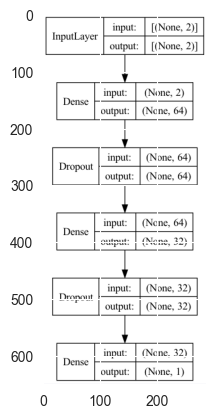

2023-05-02 02:03:31.199110: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 202ms/step - loss: 3035729.2500 - mse: 3035729.2500 - mae: 1396.6533 - root_mean_squared_error: 1742.3345 - val_loss: 12282.2061 - val_mse: 12282.2061 - val_mae: 105.5817 - val_root_mean_squared_error: 110.8251


2023-05-02 02:03:31.920700: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 63ms/step - loss: 11608.3877 - mse: 11608.3877 - mae: 102.4534 - root_mean_squared_error: 107.7422
Test loss: [11608.3876953125, 11608.3876953125, 102.45342254638672, 107.74222564697266]
['loss', 'mse', 'mae', 'root_mean_squared_error']


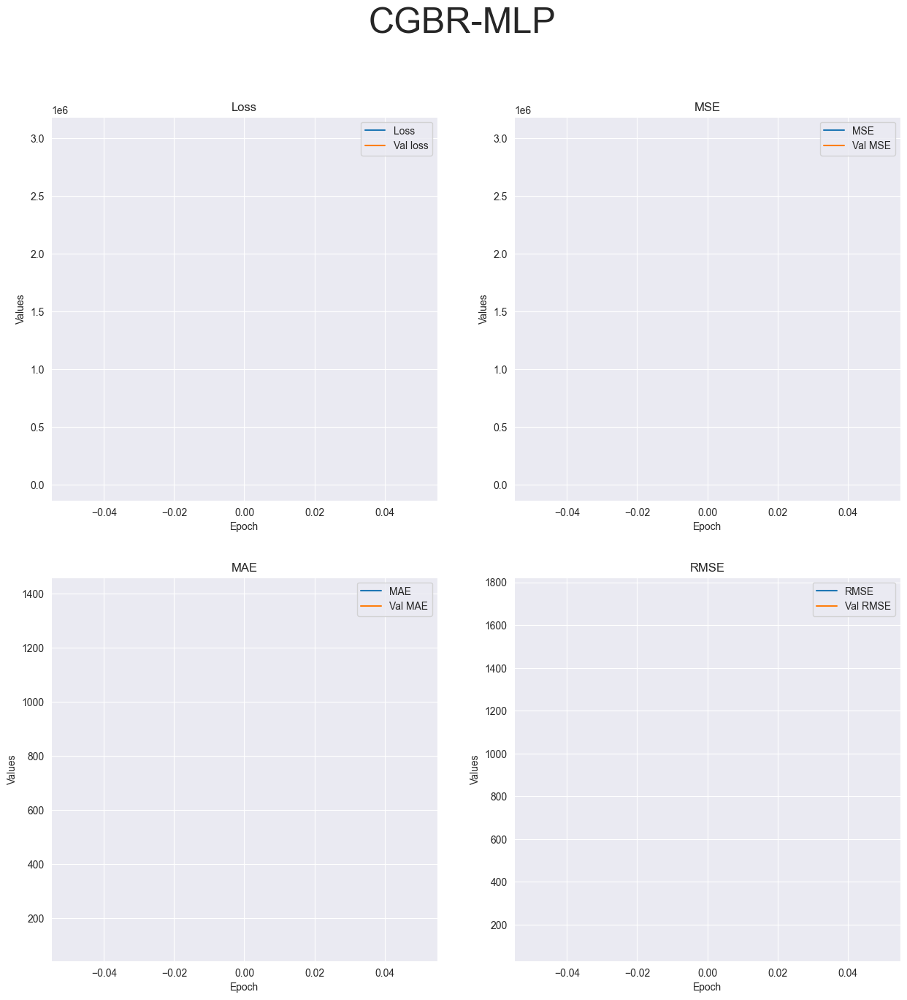

R-squared value: -69499.2506


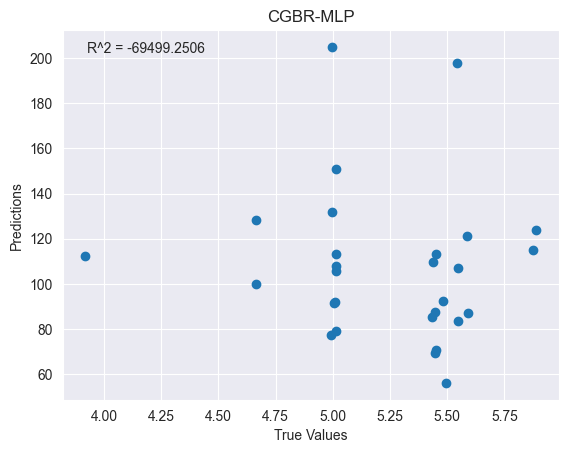

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_150 (Dense)           (None, 64)                192       
                                                                 
 dropout_36 (Dropout)        (None, 64)                0         
                                                                 
 dense_151 (Dense)           (None, 32)                2080      
                                                                 
 dropout_37 (Dropout)        (None, 32)                0         
                                                                 
 dense_152 (Dense)           (None, 1)                 33        
                                                                 
T

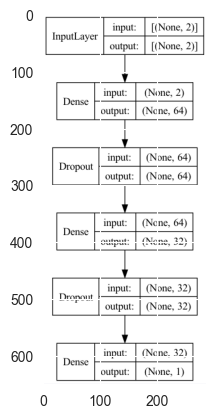

Epoch 1/4


2023-05-02 02:03:33.156508: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 171ms/step - loss: 1631657.7500 - mse: 1631657.7500 - mae: 999.6910 - root_mean_squared_error: 1277.3636 - val_loss: 30.9703 - val_mse: 30.9703 - val_mae: 4.7427 - val_root_mean_squared_error: 5.5651
Epoch 2/4
3/3 [==============================] - 0s 36ms/step - loss: 198121.4844 - mse: 198121.4844 - mae: 347.7719 - root_mean_squared_error: 445.1084 - val_loss: 1798.7130 - val_mse: 1798.7130 - val_mae: 41.1866 - val_root_mean_squared_error: 42.4112
Epoch 3/4


2023-05-02 02:03:33.679354: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 22ms/step - loss: 93938.0078 - mse: 93938.0078 - mae: 230.6494 - root_mean_squared_error: 306.4931 - val_loss: 16340.1006 - val_mse: 16340.1006 - val_mae: 122.5725 - val_root_mean_squared_error: 127.8284
Epoch 4/4
1/1 [==============================] - 0s 99ms/step - loss: 17880.3086 - mse: 17880.3086 - mae: 127.7412 - root_mean_squared_error: 133.7173
Test loss: [17880.30859375, 17880.30859375, 127.74116516113281, 133.71726989746094]
['loss', 'mse', 'mae', 'root_mean_squared_error']


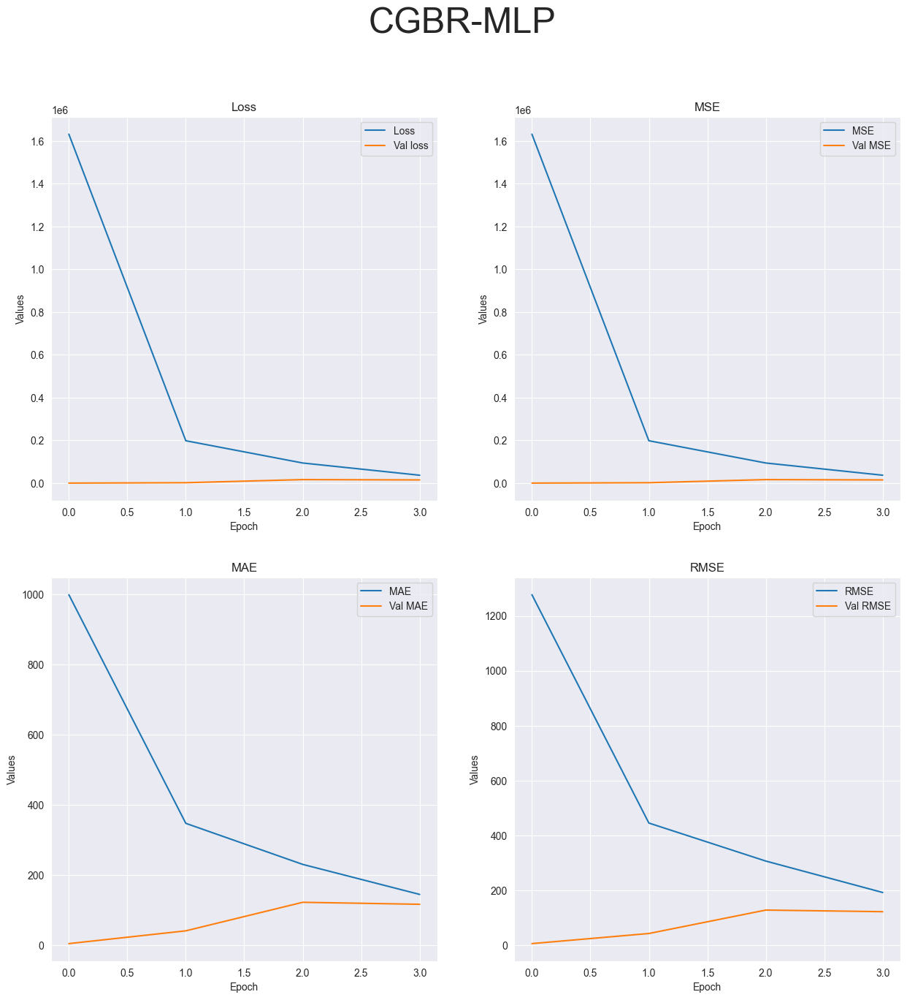

R-squared value: -31664.6351


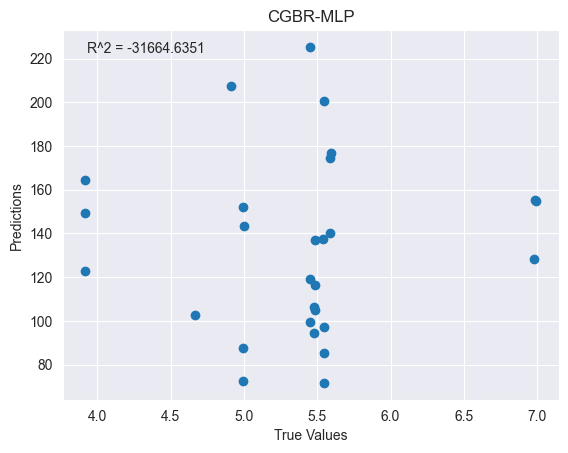

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_51"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_153 (Dense)           (None, 64)                192       
                                                                 
 dropout_38 (Dropout)        (None, 64)                0         
                                                                 
 dense_154 (Dense)           (None, 32)                2080      
                                                                 
 dropout_39 (Dropout)        (None, 32)                0         
                                                                 
 dense_155 (Dense)           (None, 1)                 33        
                                                                 


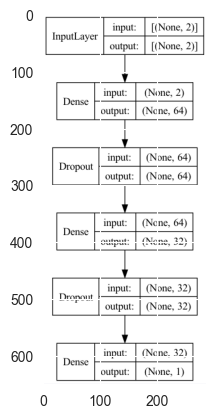

Epoch 1/10


2023-05-02 02:03:35.289648: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 165ms/step - loss: 1996890.2500 - mse: 1996890.2500 - mae: 1150.8423 - root_mean_squared_error: 1413.1136 - val_loss: 126621.6094 - val_mse: 126621.6094 - val_mae: 343.8101 - val_root_mean_squared_error: 355.8393
Epoch 2/10
3/3 [==============================] - 0s 40ms/step - loss: 602149.1875 - mse: 602149.1875 - mae: 594.9058 - root_mean_squared_error: 775.9827 - val_loss: 72738.7969 - val_mse: 72738.7969 - val_mae: 260.6759 - val_root_mean_squared_error: 269.7013
Epoch 3/10


2023-05-02 02:03:35.799153: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 36ms/step - loss: 197378.7188 - mse: 197378.7188 - mae: 342.1738 - root_mean_squared_error: 444.2733 - val_loss: 38580.0859 - val_mse: 38580.0859 - val_mae: 189.1865 - val_root_mean_squared_error: 196.4181
Epoch 4/10
3/3 [==============================] - 0s 20ms/step - loss: 104693.4141 - mse: 104693.4141 - mae: 248.8610 - root_mean_squared_error: 323.5636 - val_loss: 37183.7617 - val_mse: 37183.7617 - val_mae: 185.7243 - val_root_mean_squared_error: 192.8309
Epoch 5/10
3/3 [==============================] - 0s 22ms/step - loss: 79420.7969 - mse: 79420.7969 - mae: 224.1927 - root_mean_squared_error: 281.8170 - val_loss: 24162.3320 - val_mse: 24162.3320 - val_mae: 149.6374 - val_root_mean_squared_error: 155.4424
Epoch 6/10
3/3 [==============================] - 0s 21ms/step - loss: 31163.5430 - mse: 31163.5430 - mae: 143.2583 - root_mean_squared_error: 176.5320 - val_loss: 12529.6035 - val_mse: 12529.6035 - val_mae: 107.6439 - val_root_mean_squ

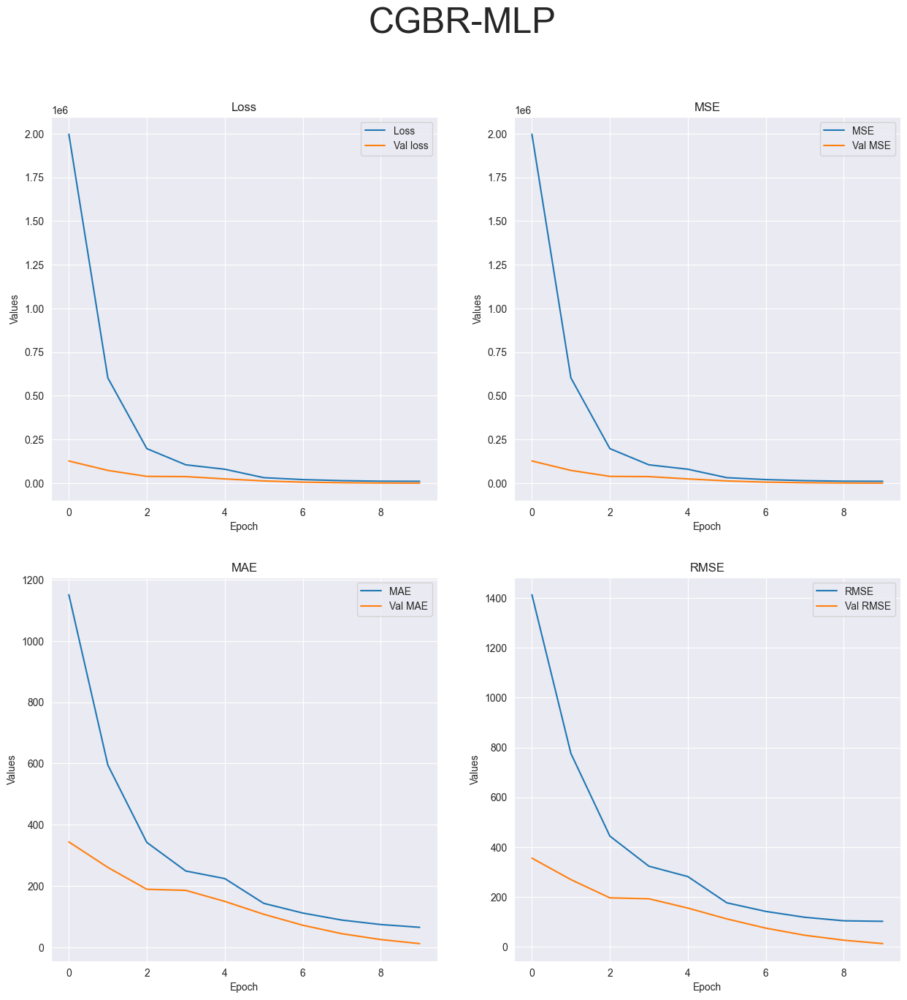

R-squared value: -338.8288


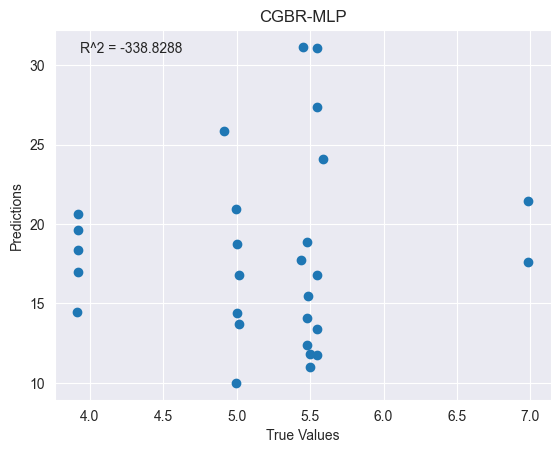

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_156 (Dense)           (None, 64)                192       
                                                                 
 dropout_40 (Dropout)        (None, 64)                0         
                                                                 
 dense_157 (Dense)           (None, 32)                2080      
                                                                 
 dropout_41 (Dropout)        (None, 32)                0         
                                                                 
 dense_158 (Dense)           (None, 1)                 33        
                                                                 


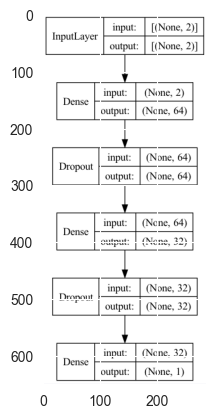

Epoch 1/20


2023-05-02 02:03:38.283341: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 208ms/step - loss: 2636018.2500 - mse: 2636018.2500 - mae: 1286.1884 - root_mean_squared_error: 1623.5819 - val_loss: 109393.6016 - val_mse: 109393.6016 - val_mae: 321.5240 - val_root_mean_squared_error: 330.7470
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 470938.1250 - mse: 470938.1250 - mae: 517.0181 - root_mean_squared_error: 686.2493

2023-05-02 02:03:38.978314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 27ms/step - loss: 558947.7500 - mse: 558947.7500 - mae: 560.5938 - root_mean_squared_error: 747.6281 - val_loss: 161353.0156 - val_mse: 161353.0156 - val_mae: 390.4322 - val_root_mean_squared_error: 401.6877
Epoch 3/20
3/3 [==============================] - 0s 22ms/step - loss: 255360.4219 - mse: 255360.4219 - mae: 393.4412 - root_mean_squared_error: 505.3320 - val_loss: 43748.8164 - val_mse: 43748.8164 - val_mae: 202.8583 - val_root_mean_squared_error: 209.1622
Epoch 4/20
3/3 [==============================] - 0s 26ms/step - loss: 111892.4844 - mse: 111892.4844 - mae: 255.9321 - root_mean_squared_error: 334.5033 - val_loss: 44234.5820 - val_mse: 44234.5820 - val_mae: 203.9859 - val_root_mean_squared_error: 210.3202
Epoch 5/20
3/3 [==============================] - 0s 23ms/step - loss: 69365.3828 - mse: 69365.3828 - mae: 199.8460 - root_mean_squared_error: 263.3731 - val_loss: 12634.7539 - val_mse: 12634.7539 - val_mae: 108.8797 - val_root_mean

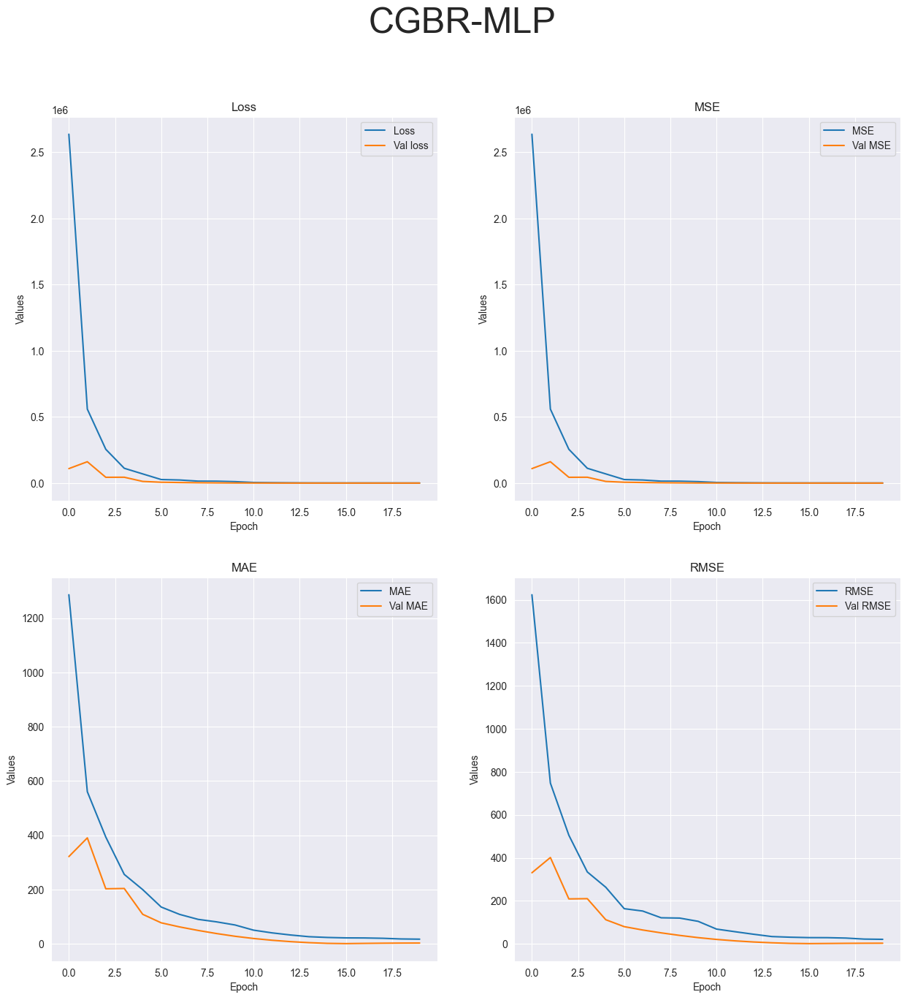

R-squared value: -10.9836


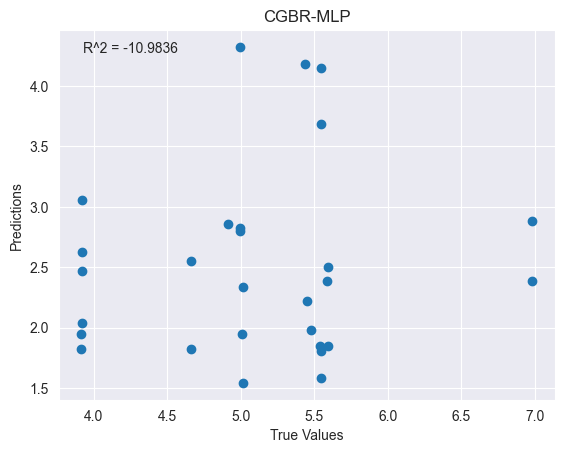

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_159 (Dense)           (None, 64)                192       
                                                                 
 dense_160 (Dense)           (None, 32)                2080      
                                                                 
 dense_161 (Dense)           (None, 16)                528       
                                                                 
 dense_162 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_____________________________________

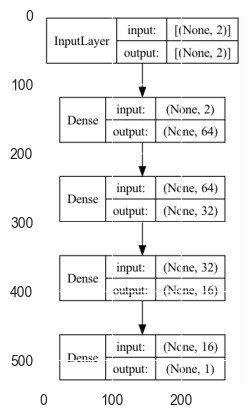

2023-05-02 02:03:41.314101: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 54ms/step - loss: 214542.3281 - mse: 214542.3281 - mae: 445.2108 - root_mean_squared_error: 463.1871


2023-05-02 02:03:41.706002: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [214542.328125, 214542.328125, 445.2107849121094, 463.1871337890625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


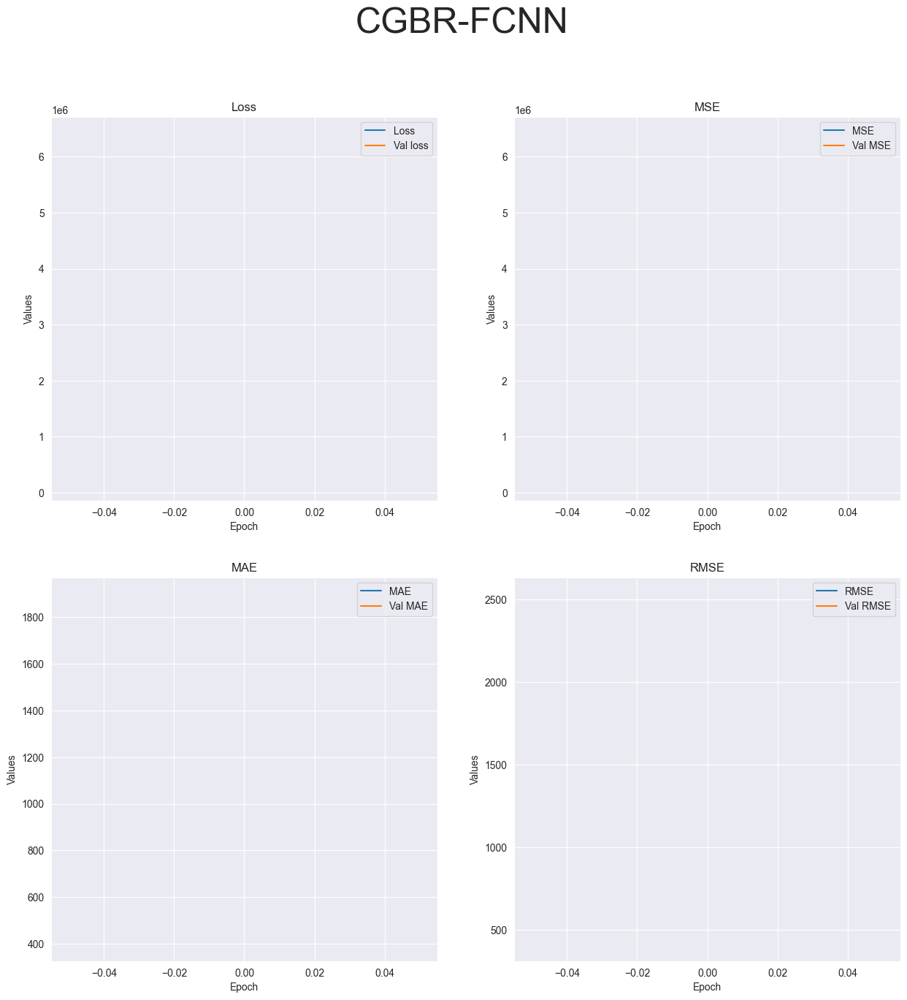

R-squared value: -813451.0368


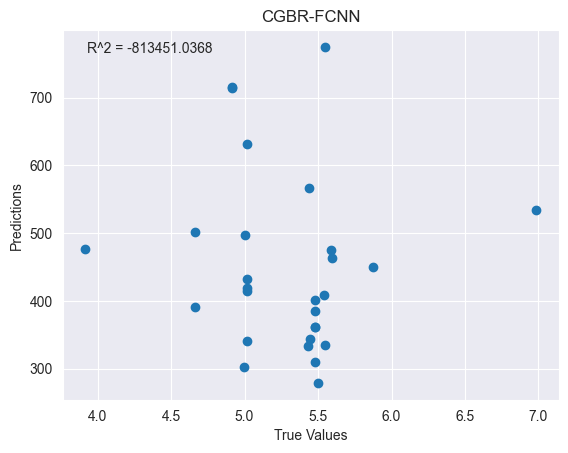

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_163 (Dense)           (None, 64)                192       
                                                                 
 dense_164 (Dense)           (None, 32)                2080      
                                                                 
 dense_165 (Dense)           (None, 16)                528       
                                                                 
 dense_166 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________

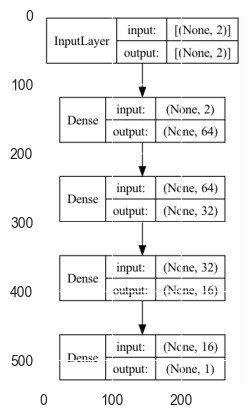

Epoch 1/4


2023-05-02 02:03:42.915671: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 171ms/step - loss: 7712697.5000 - mse: 7712697.5000 - mae: 2000.2861 - root_mean_squared_error: 2777.1743 - val_loss: 154030.6250 - val_mse: 154030.6250 - val_mae: 381.4362 - val_root_mean_squared_error: 392.4673
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 148873.7500 - mse: 148873.7500 - mae: 372.9252 - root_mean_squared_error: 385.8416

2023-05-02 02:03:43.366303: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 37ms/step - loss: 2014070.2500 - mse: 2014070.2500 - mae: 1187.5348 - root_mean_squared_error: 1419.1794 - val_loss: 2216731.7500 - val_mse: 2216731.7500 - val_mae: 1447.7946 - val_root_mean_squared_error: 1488.8693
Epoch 3/4
3/3 [==============================] - 0s 24ms/step - loss: 1775835.1250 - mse: 1775835.1250 - mae: 1240.8024 - root_mean_squared_error: 1332.6046 - val_loss: 201400.6562 - val_mse: 201400.6562 - val_mae: 436.2030 - val_root_mean_squared_error: 448.7769
Epoch 4/4
1/1 [==============================] - 0s 51ms/step - loss: 58521.9570 - mse: 58521.9570 - mae: 237.3579 - root_mean_squared_error: 241.9131
Test loss: [58521.95703125, 58521.95703125, 237.35787963867188, 241.91311645507812]
['loss', 'mse', 'mae', 'root_mean_squared_error']


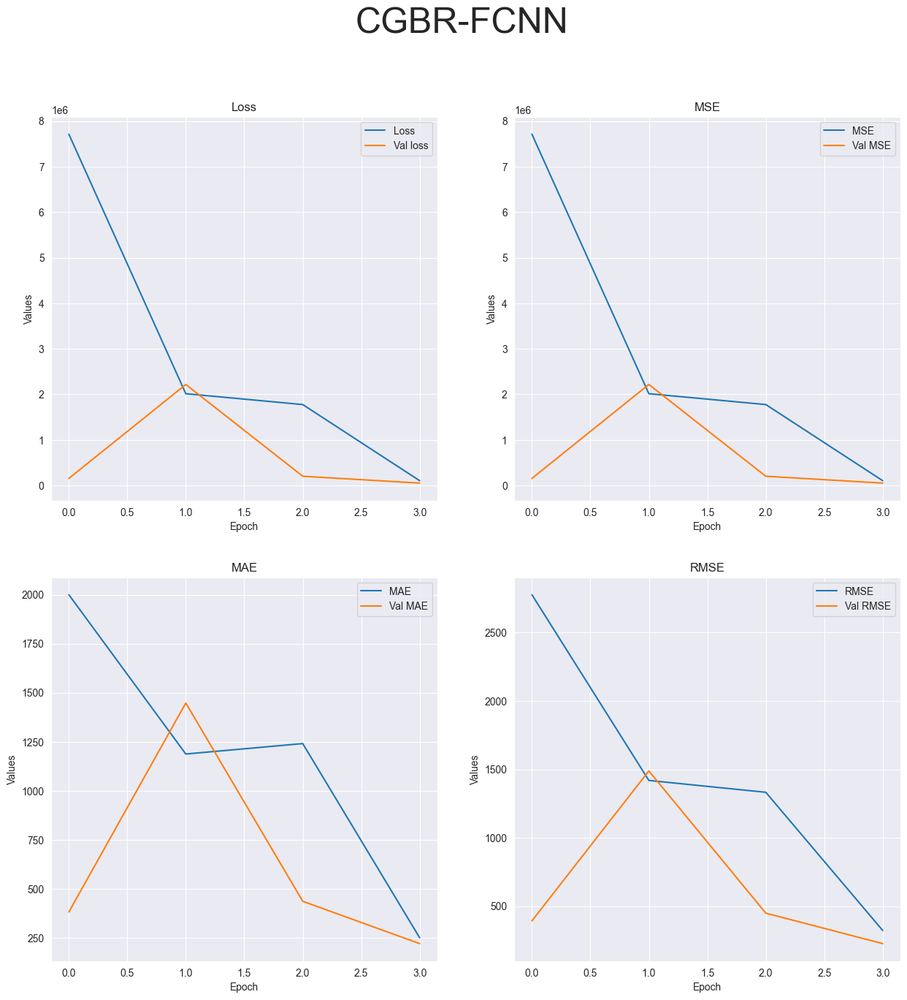

R-squared value: -154860.5228


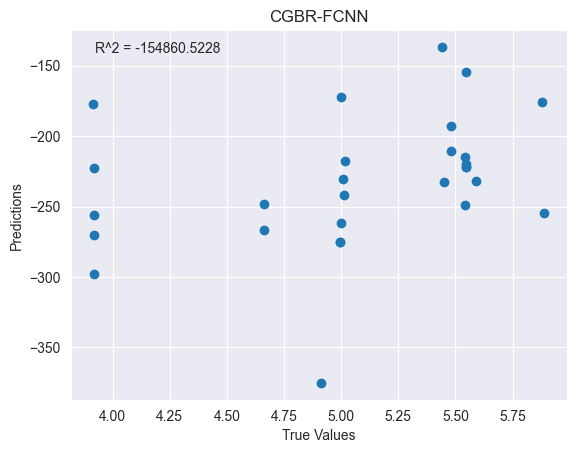

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_55"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_167 (Dense)           (None, 64)                192       
                                                                 
 dense_168 (Dense)           (None, 32)                2080      
                                                                 
 dense_169 (Dense)           (None, 16)                528       
                                                                 
 dense_170 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
________________________________________________________________

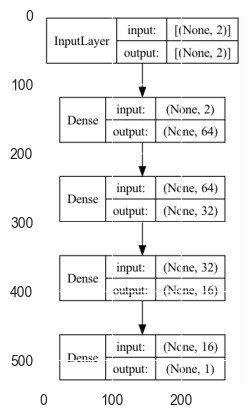

Epoch 1/10


2023-05-02 02:03:44.855825: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 146ms/step - loss: 6087354.0000 - mse: 6087354.0000 - mae: 1890.0214 - root_mean_squared_error: 2467.2563 - val_loss: 223207.8750 - val_mse: 223207.8750 - val_mae: 459.4304 - val_root_mean_squared_error: 472.4488
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 247840.9375 - mse: 247840.9375 - mae: 472.2889 - root_mean_squared_error: 497.8362

2023-05-02 02:03:45.281269: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 77ms/step - loss: 1884039.0000 - mse: 1884039.0000 - mae: 1197.3154 - root_mean_squared_error: 1372.6030 - val_loss: 2147396.2500 - val_mse: 2147396.2500 - val_mae: 1425.5530 - val_root_mean_squared_error: 1465.3997
Epoch 3/10
3/3 [==============================] - 0s 31ms/step - loss: 1579963.1250 - mse: 1579963.1250 - mae: 1147.2212 - root_mean_squared_error: 1256.9658 - val_loss: 105493.8984 - val_mse: 105493.8984 - val_mae: 315.7692 - val_root_mean_squared_error: 324.7982
Epoch 4/10
3/3 [==============================] - 0s 21ms/step - loss: 58501.5156 - mse: 58501.5156 - mae: 189.3148 - root_mean_squared_error: 241.8709 - val_loss: 106189.1719 - val_mse: 106189.1719 - val_mae: 317.3102 - val_root_mean_squared_error: 325.8668
Epoch 5/10
3/3 [==============================] - 0s 26ms/step - loss: 192246.5469 - mse: 192246.5469 - mae: 413.3775 - root_mean_squared_error: 438.4593 - val_loss: 231596.0469 - val_mse: 231596.0469 - val_mae: 468.48

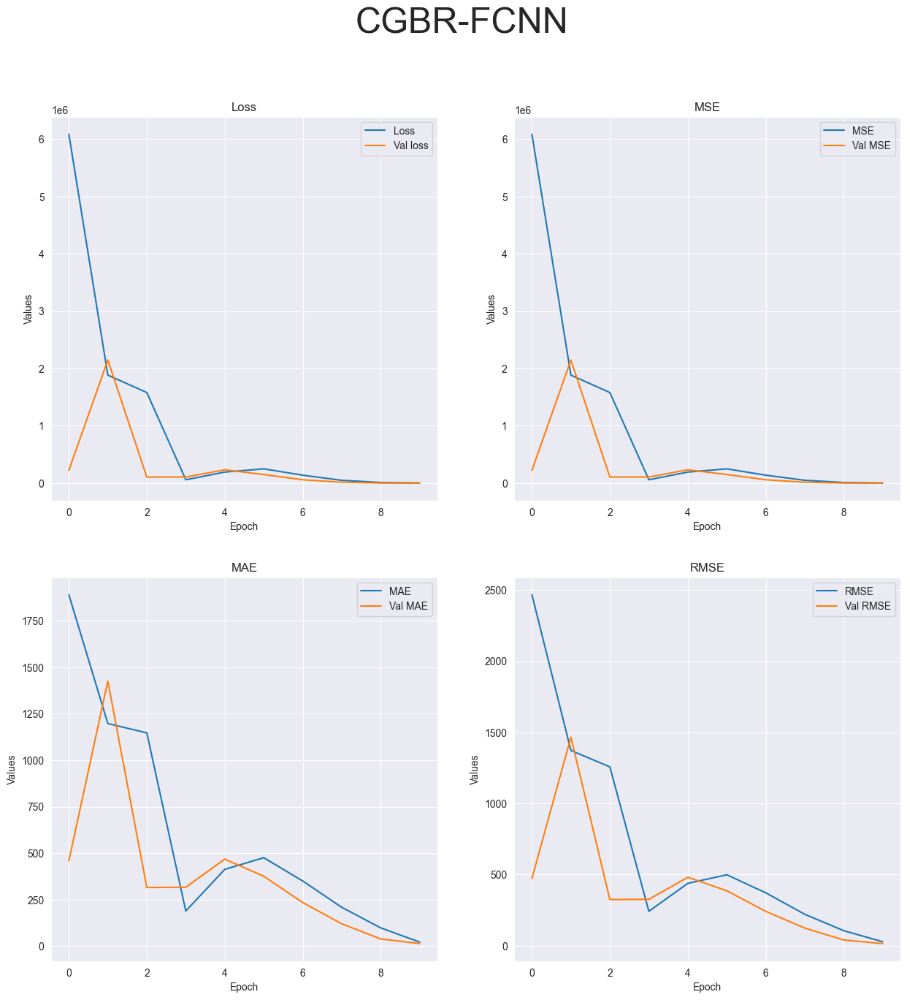

R-squared value: -367.7138


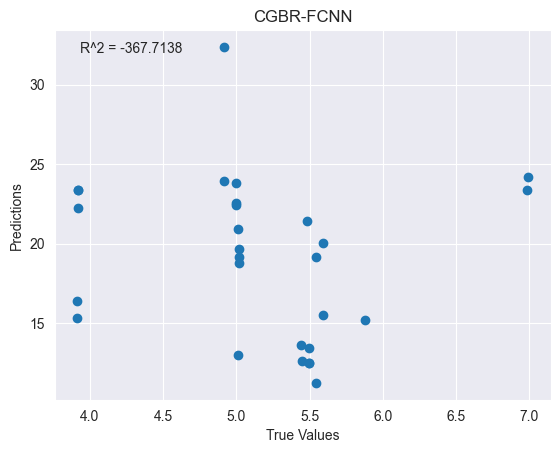

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_171 (Dense)           (None, 64)                192       
                                                                 
 dense_172 (Dense)           (None, 32)                2080      
                                                                 
 dense_173 (Dense)           (None, 16)                528       
                                                                 
 dense_174 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
________________________________________________________________

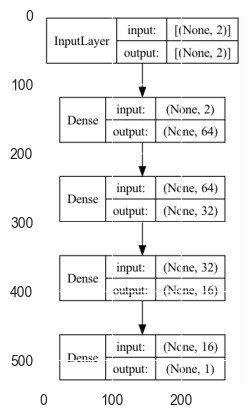

Epoch 1/20


2023-05-02 02:03:47.892854: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 150ms/step - loss: 7127780.0000 - mse: 7127780.0000 - mae: 1915.9261 - root_mean_squared_error: 2669.7903 - val_loss: 230686.3906 - val_mse: 230686.3906 - val_mae: 467.4828 - val_root_mean_squared_error: 480.2982
Epoch 2/20
3/3 [==============================] - 0s 29ms/step - loss: 1550029.5000 - mse: 1550029.5000 - mae: 1071.1213 - root_mean_squared_error: 1245.0018 - val_loss: 3474308.2500 - val_mse: 3474308.2500 - val_mae: 1814.9449 - val_root_mean_squared_error: 1863.9496
Epoch 3/20


2023-05-02 02:03:48.369158: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 26ms/step - loss: 1652322.7500 - mse: 1652322.7500 - mae: 1213.1707 - root_mean_squared_error: 1285.4271 - val_loss: 442614.5312 - val_mse: 442614.5312 - val_mae: 647.6392 - val_root_mean_squared_error: 665.2928
Epoch 4/20
3/3 [==============================] - 0s 28ms/step - loss: 135493.8594 - mse: 135493.8594 - mae: 283.3000 - root_mean_squared_error: 368.0949 - val_loss: 42651.4609 - val_mse: 42651.4609 - val_mae: 201.3692 - val_root_mean_squared_error: 206.5223
Epoch 5/20
3/3 [==============================] - 0s 23ms/step - loss: 88524.1094 - mse: 88524.1094 - mae: 269.8958 - root_mean_squared_error: 297.5300 - val_loss: 264108.3438 - val_mse: 264108.3438 - val_mae: 500.7236 - val_root_mean_squared_error: 513.9147
Epoch 6/20
3/3 [==============================] - 0s 26ms/step - loss: 197034.0625 - mse: 197034.0625 - mae: 425.6258 - root_mean_squared_error: 443.8852 - val_loss: 264562.5625 - val_mse: 264562.5625 - val_mae: 501.1540 - val_r

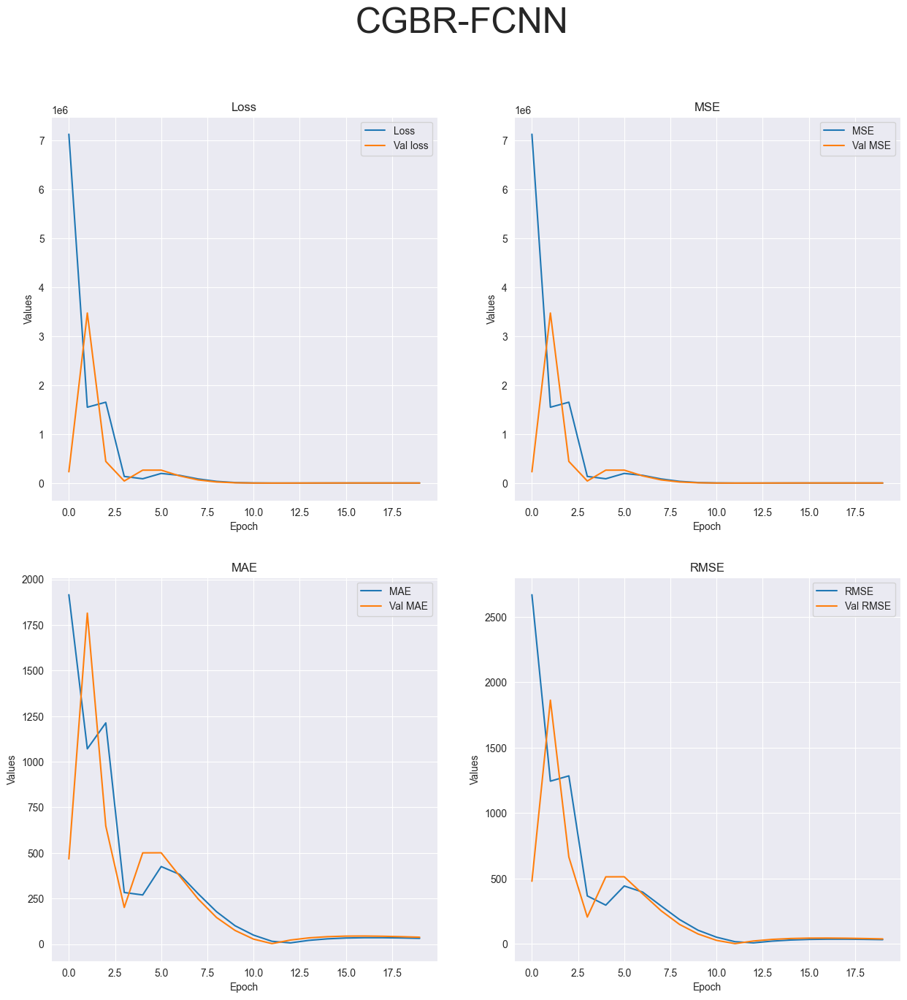

R-squared value: -2076.4973


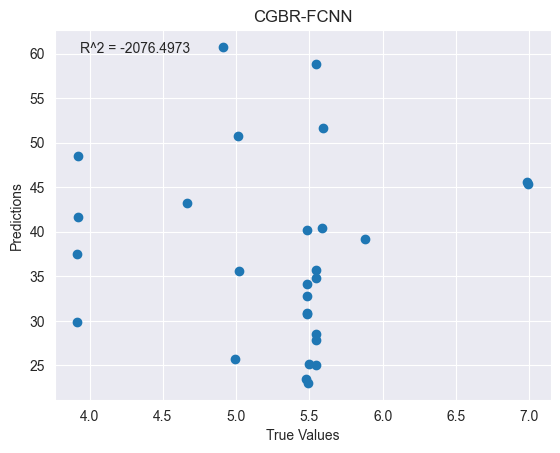

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_57"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_175 (Dense)           (None, 128)               384       
                                                                 
 dense_176 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


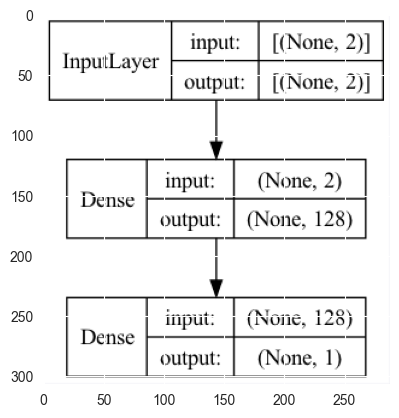

2023-05-02 02:03:50.840789: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 48ms/step - loss: 322014400.0000 - mse: 322014400.0000 - mae: 17157.5488 - root_mean_squared_error: 17944.7598


2023-05-02 02:03:51.282580: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [322014400.0, 322014400.0, 17157.548828125, 17944.759765625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


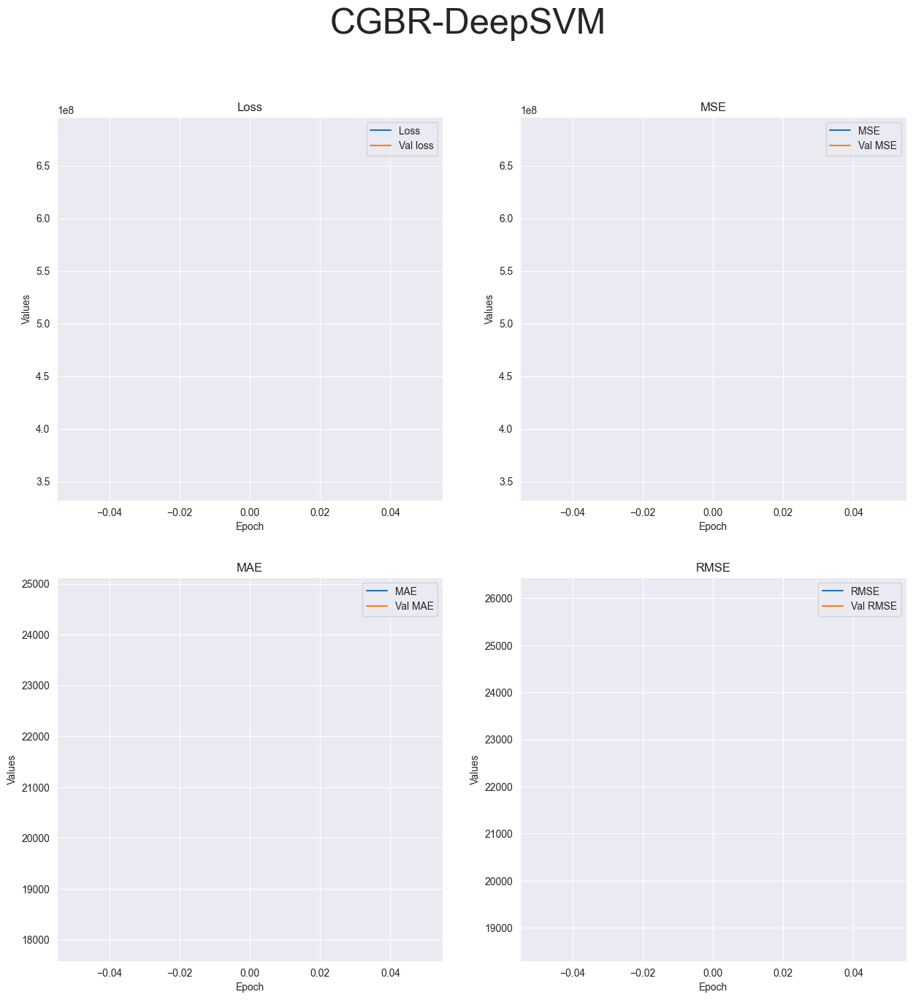

R-squared value: -1110365977.9916


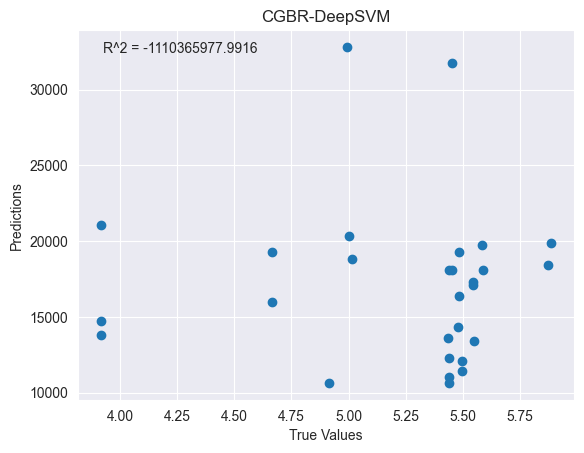

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_58"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_177 (Dense)           (None, 128)               384       
                                                                 
 dense_178 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


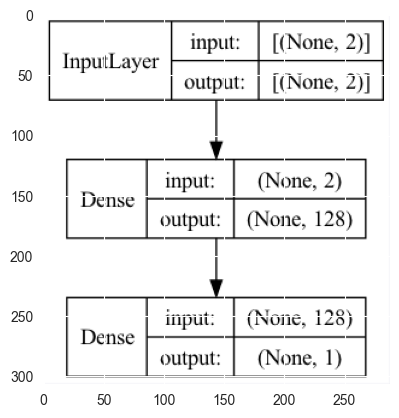

Epoch 1/4


2023-05-02 02:03:52.535857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 148ms/step - loss: 677205696.0000 - mse: 677205696.0000 - mae: 24704.1133 - root_mean_squared_error: 26023.1758 - val_loss: 286578368.0000 - val_mse: 286578368.0000 - val_mae: 16350.5459 - val_root_mean_squared_error: 16928.6250
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 386060224.0000 - mse: 386060224.0000 - mae: 18937.6680 - root_mean_squared_error: 19648.4160

2023-05-02 02:03:52.914143: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 32ms/step - loss: 274694176.0000 - mse: 274694176.0000 - mae: 15730.3584 - root_mean_squared_error: 16573.9004 - val_loss: 112345856.0000 - val_mse: 112345856.0000 - val_mae: 10237.2158 - val_root_mean_squared_error: 10599.3330
Epoch 3/4
3/3 [==============================] - 0s 25ms/step - loss: 107613832.0000 - mse: 107613832.0000 - mae: 9840.3691 - root_mean_squared_error: 10373.7090 - val_loss: 44089820.0000 - val_mse: 44089820.0000 - val_mae: 6413.0054 - val_root_mean_squared_error: 6640.0166
Epoch 4/4
1/1 [==============================] - 0s 86ms/step - loss: 22614094.0000 - mse: 22614094.0000 - mae: 4604.9644 - root_mean_squared_error: 4755.4277
Test loss: [22614094.0, 22614094.0, 4604.96435546875, 4755.427734375]
['loss', 'mse', 'mae', 'root_mean_squared_error']


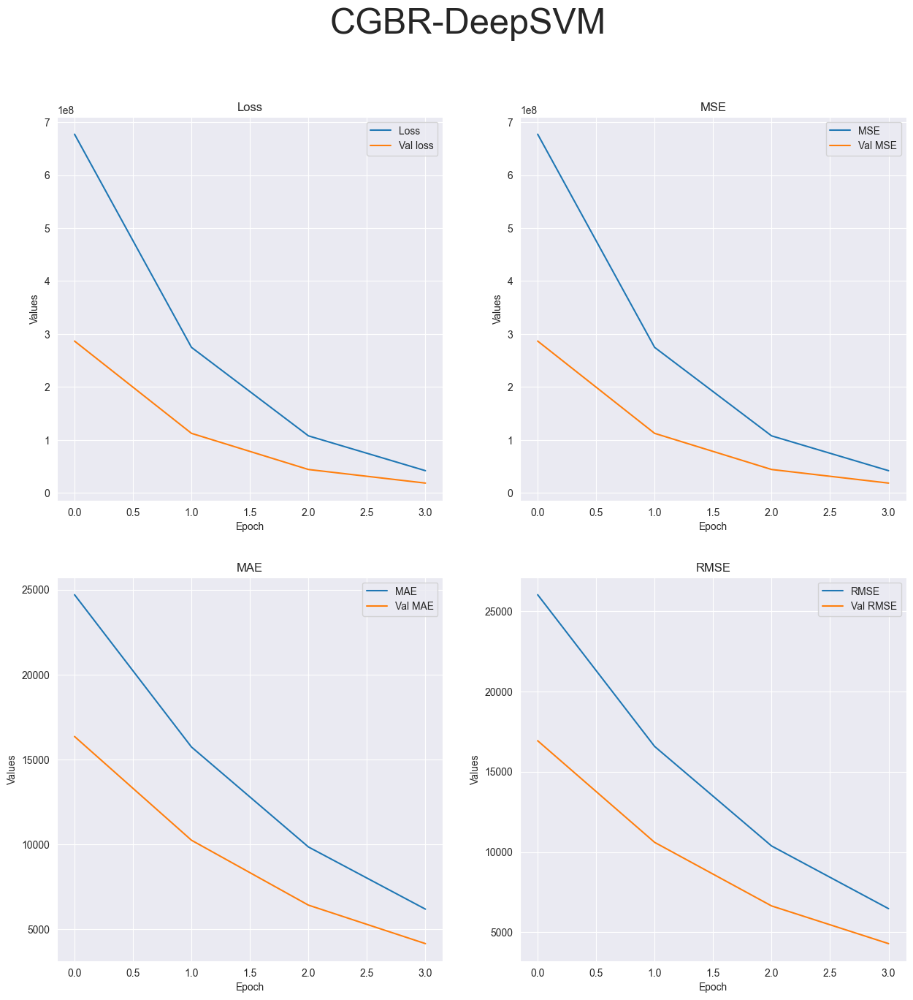

R-squared value: -41462554.3592


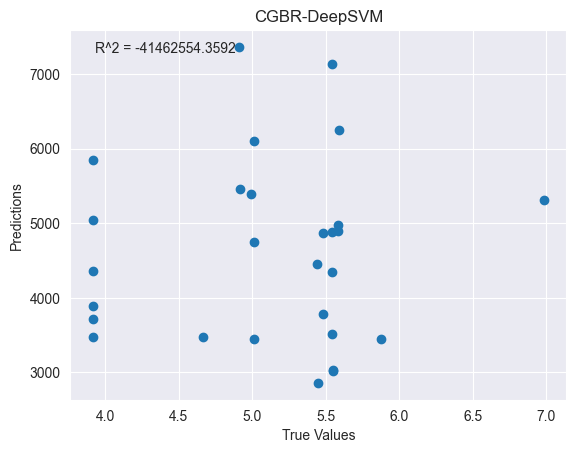

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_59"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_179 (Dense)           (None, 128)               384       
                                                                 
 dense_180 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


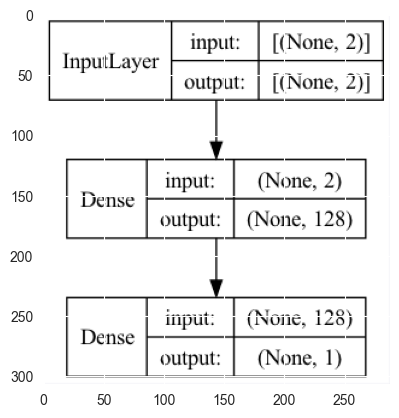

Epoch 1/10


2023-05-02 02:03:54.538344: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 152ms/step - loss: 615612864.0000 - mse: 615612864.0000 - mae: 23858.0723 - root_mean_squared_error: 24811.5469 - val_loss: 346182528.0000 - val_mse: 346182528.0000 - val_mae: 17614.6035 - val_root_mean_squared_error: 18605.9805
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 287898880.0000 - mse: 287898880.0000 - mae: 16446.3203 - root_mean_squared_error: 16967.5840

2023-05-02 02:03:54.967540: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 39ms/step - loss: 243213232.0000 - mse: 243213232.0000 - mae: 15033.2920 - root_mean_squared_error: 15595.2949 - val_loss: 133817568.0000 - val_mse: 133817568.0000 - val_mae: 10951.3262 - val_root_mean_squared_error: 11567.9541
Epoch 3/10
3/3 [==============================] - 0s 26ms/step - loss: 92897656.0000 - mse: 92897656.0000 - mae: 9312.8896 - root_mean_squared_error: 9638.3428 - val_loss: 51741992.0000 - val_mse: 51741992.0000 - val_mae: 6809.5161 - val_root_mean_squared_error: 7193.1904
Epoch 4/10
3/3 [==============================] - 0s 23ms/step - loss: 37262668.0000 - mse: 37262668.0000 - mae: 5859.5684 - root_mean_squared_error: 6104.3154 - val_loss: 21125556.0000 - val_mse: 21125556.0000 - val_mae: 4350.8784 - val_root_mean_squared_error: 4596.2544
Epoch 5/10
3/3 [==============================] - 0s 19ms/step - loss: 15744640.0000 - mse: 15744640.0000 - mae: 3806.1050 - root_mean_squared_error: 3967.9517 - val_loss: 9675322.0000

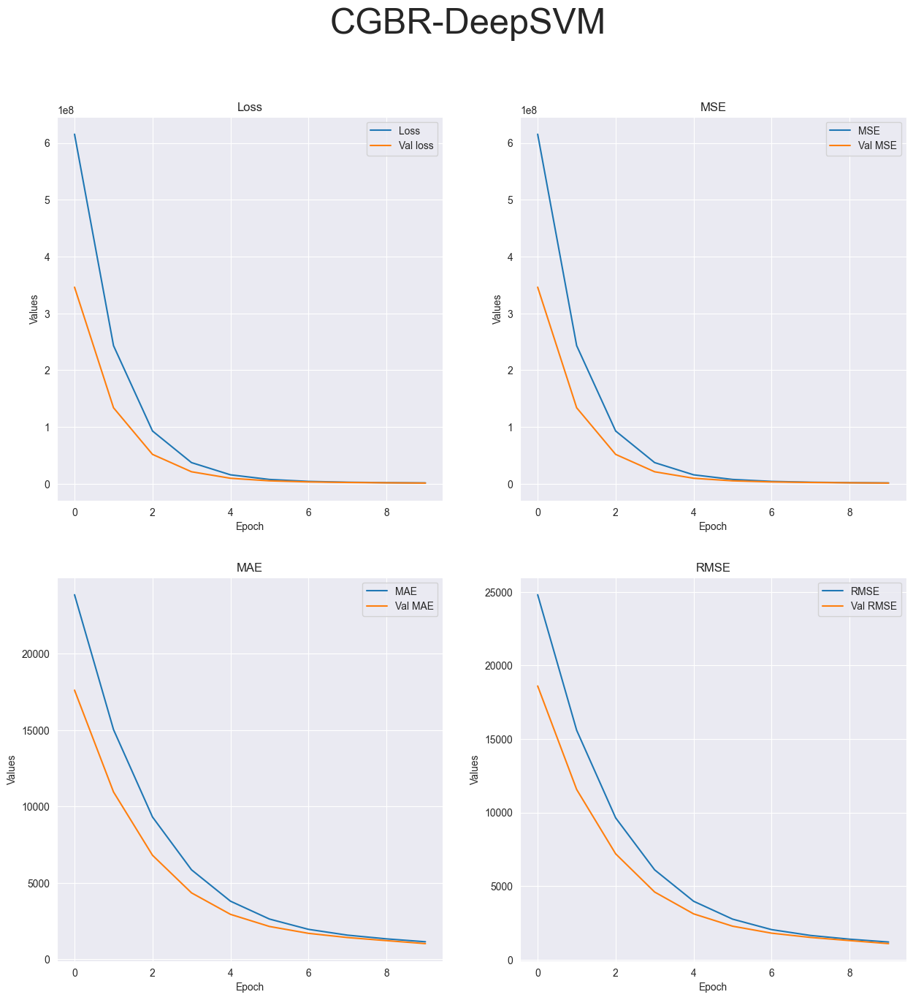

R-squared value: -5552441.3390


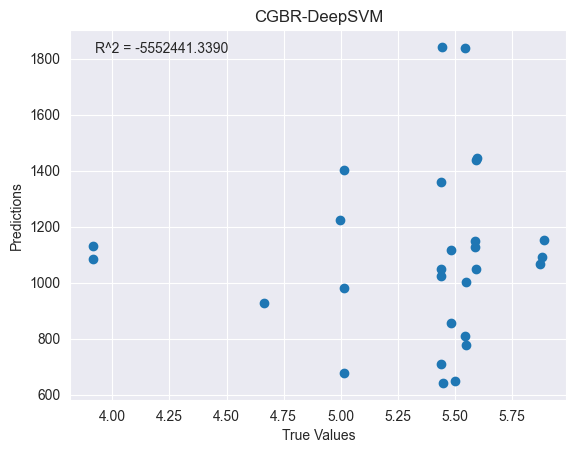

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_181 (Dense)           (None, 128)               384       
                                                                 
 dense_182 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


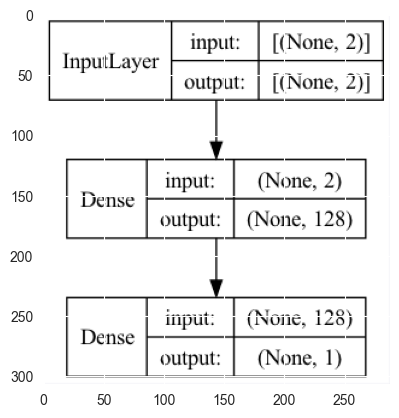

Epoch 1/20


2023-05-02 02:03:57.265938: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 153ms/step - loss: 648561728.0000 - mse: 648561728.0000 - mae: 24267.1973 - root_mean_squared_error: 25466.8750 - val_loss: 319092160.0000 - val_mse: 319092160.0000 - val_mae: 17381.1523 - val_root_mean_squared_error: 17863.1504
Epoch 2/20
3/3 [==============================] - 0s 29ms/step - loss: 261030240.0000 - mse: 261030240.0000 - mae: 15469.8936 - root_mean_squared_error: 16156.4307 - val_loss: 126650232.0000 - val_mse: 126650232.0000 - val_mae: 10950.1035 - val_root_mean_squared_error: 11253.8984
Epoch 3/20


2023-05-02 02:03:57.705799: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 50ms/step - loss: 104256936.0000 - mse: 104256936.0000 - mae: 9749.9492 - root_mean_squared_error: 10210.6289 - val_loss: 50121696.0000 - val_mse: 50121696.0000 - val_mae: 6888.4282 - val_root_mean_squared_error: 7079.6680
Epoch 4/20
3/3 [==============================] - 0s 23ms/step - loss: 40852840.0000 - mse: 40852840.0000 - mae: 6144.6694 - root_mean_squared_error: 6391.6226 - val_loss: 21035394.0000 - val_mse: 21035394.0000 - val_mae: 4462.4307 - val_root_mean_squared_error: 4586.4360
Epoch 5/20
3/3 [==============================] - 0s 18ms/step - loss: 17857272.0000 - mse: 17857272.0000 - mae: 4043.0740 - root_mean_squared_error: 4225.7866 - val_loss: 9752238.0000 - val_mse: 9752238.0000 - val_mae: 3038.3245 - val_root_mean_squared_error: 3122.8574
Epoch 6/20
3/3 [==============================] - 0s 17ms/step - loss: 8544186.0000 - mse: 8544186.0000 - mae: 2804.8298 - root_mean_squared_error: 2923.0439 - val_loss: 5181932.0000 - val_ms

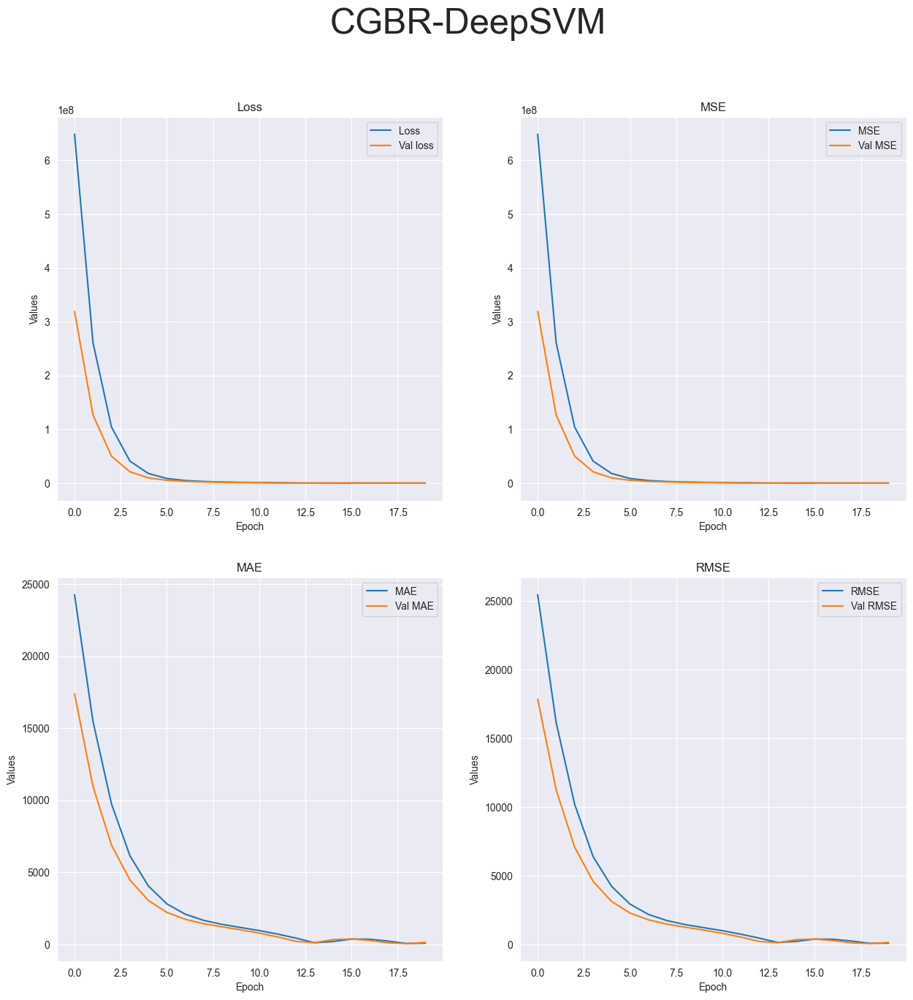

R-squared value: -48318.2006


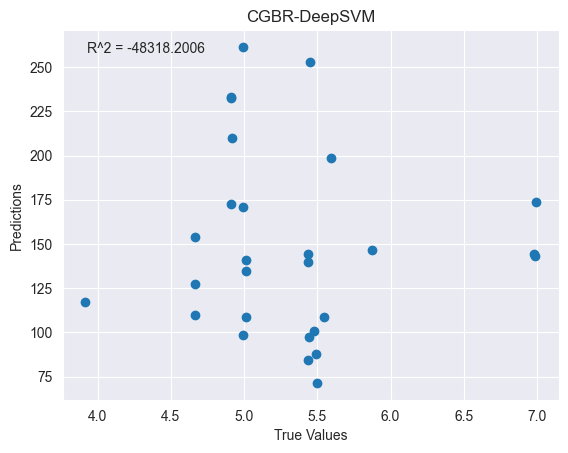

Running tests on FBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_183 (Dense)           (None, 64)                512       
                                                                 
 dropout_42 (Dropout)        (None, 64)                0         
                                                                 
 dense_184 (Dense)           (None, 32)                2080      
                                                                 
 dropout_43 (Dropout)        (None, 32)            

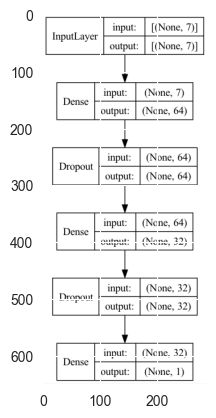

2023-05-02 02:04:00.197648: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 59ms/step - loss: 4.5673 - mse: 4.5673 - mae: 1.7416 - root_mean_squared_error: 2.1371


2023-05-02 02:04:00.686169: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [4.5673322677612305, 4.5673322677612305, 1.7416197061538696, 2.137131690979004]
['loss', 'mse', 'mae', 'root_mean_squared_error']


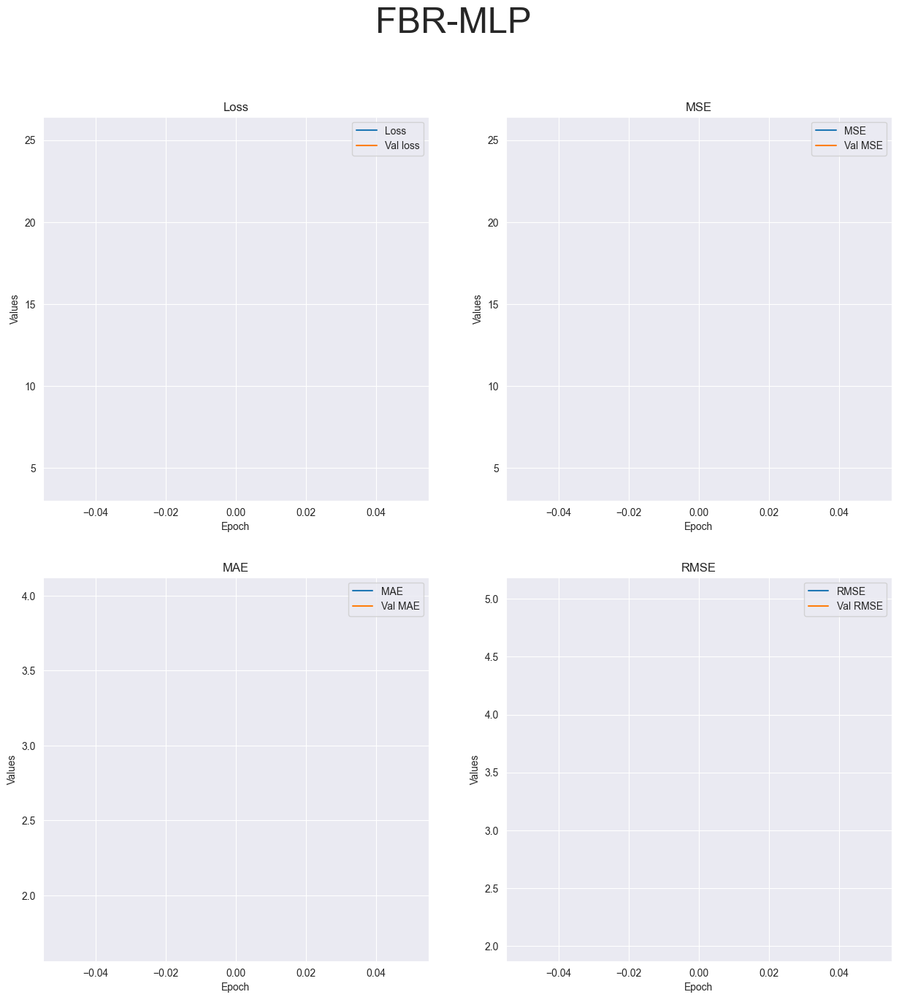

R-squared value: -14.7843


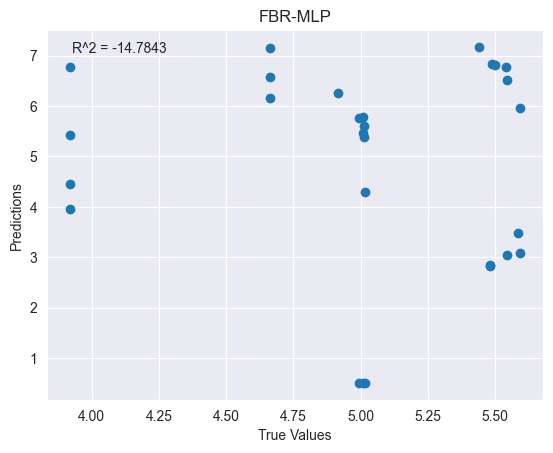

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_62"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_186 (Dense)           (None, 64)                512       
                                                                 
 dropout_44 (Dropout)        (None, 64)                0         
                                                                 
 dense_187 (Dense)           (None, 32)                2080      
                                                                 
 dropout_45 (Dropout)        (None, 32)                0         
                                                

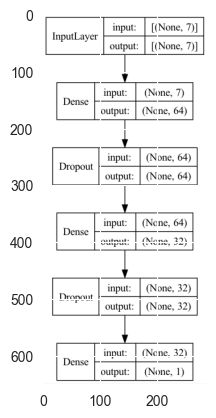

Epoch 1/4


2023-05-02 02:04:01.941621: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 158ms/step - loss: 30.1495 - mse: 30.1495 - mae: 4.7939 - root_mean_squared_error: 5.4909 - val_loss: 2.2544 - val_mse: 2.2544 - val_mae: 1.2954 - val_root_mean_squared_error: 1.5015
Epoch 2/4
3/3 [==============================] - ETA: 0s - loss: 10.6463 - mse: 10.6463 - mae: 2.5835 - root_mean_squared_error: 3.2629

2023-05-02 02:04:02.432118: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 46ms/step - loss: 10.6463 - mse: 10.6463 - mae: 2.5835 - root_mean_squared_error: 3.2629 - val_loss: 6.9078 - val_mse: 6.9078 - val_mae: 2.2211 - val_root_mean_squared_error: 2.6283
Epoch 3/4
3/3 [==============================] - 0s 47ms/step - loss: 9.1889 - mse: 9.1889 - mae: 2.4147 - root_mean_squared_error: 3.0313 - val_loss: 2.8686 - val_mse: 2.8686 - val_mae: 1.3933 - val_root_mean_squared_error: 1.6937
Epoch 4/4
1/1 [==============================] - 0s 45ms/step - loss: 1.0373 - mse: 1.0373 - mae: 0.7984 - root_mean_squared_error: 1.0185
Test loss: [1.0373269319534302, 1.0373269319534302, 0.7983947396278381, 1.0184924602508545]
['loss', 'mse', 'mae', 'root_mean_squared_error']


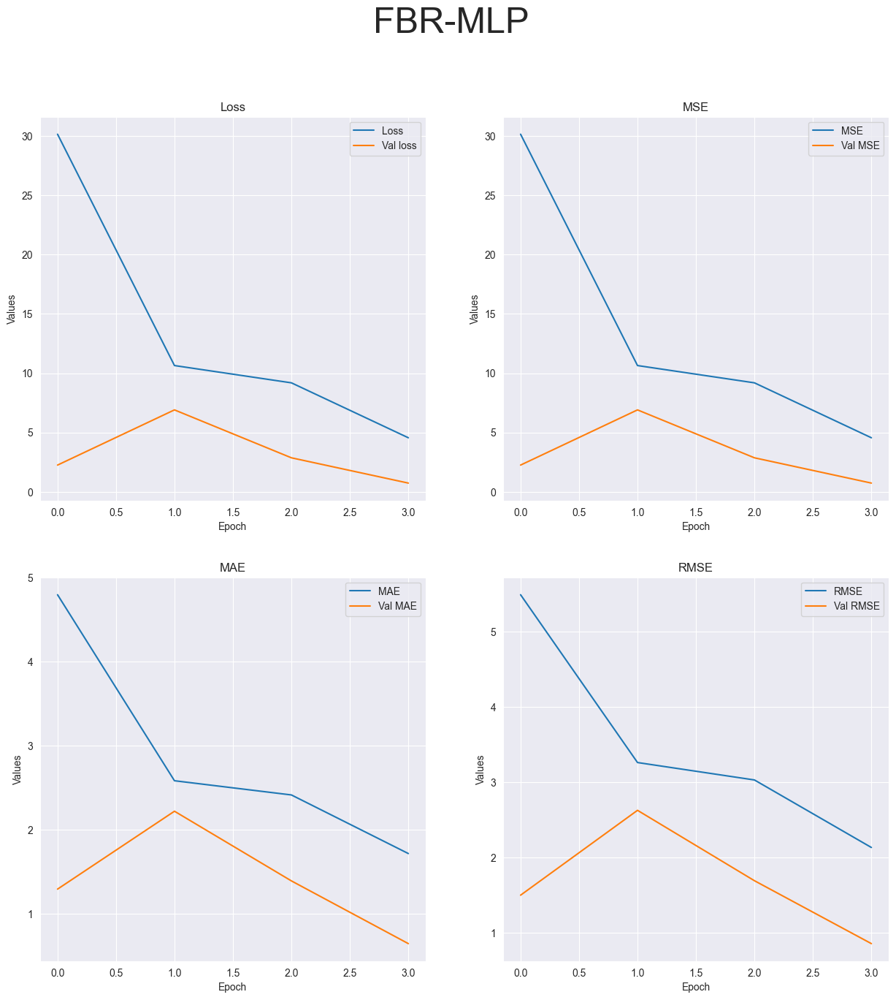

R-squared value: -0.9262


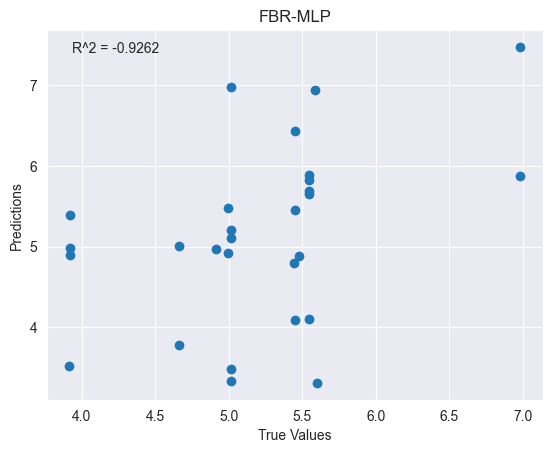

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_63"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_189 (Dense)           (None, 64)                512       
                                                                 
 dropout_46 (Dropout)        (None, 64)                0         
                                                                 
 dense_190 (Dense)           (None, 32)                2080      
                                                                 
 dropout_47 (Dropout)        (None, 32)                0         
                                               

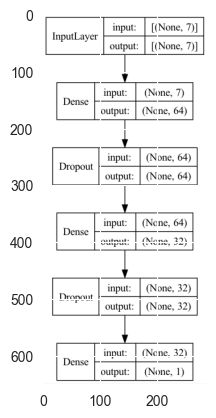

Epoch 1/10


2023-05-02 02:04:03.973452: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 177ms/step - loss: 24.5445 - mse: 24.5445 - mae: 3.9963 - root_mean_squared_error: 4.9542 - val_loss: 1.7308 - val_mse: 1.7308 - val_mae: 1.0969 - val_root_mean_squared_error: 1.3156
Epoch 2/10
3/3 [==============================] - ETA: 0s - loss: 8.0276 - mse: 8.0276 - mae: 2.2660 - root_mean_squared_error: 2.8333

2023-05-02 02:04:04.512400: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 41ms/step - loss: 8.0276 - mse: 8.0276 - mae: 2.2660 - root_mean_squared_error: 2.8333 - val_loss: 3.3101 - val_mse: 3.3101 - val_mae: 1.5988 - val_root_mean_squared_error: 1.8194
Epoch 3/10
3/3 [==============================] - 0s 45ms/step - loss: 6.0575 - mse: 6.0575 - mae: 2.0038 - root_mean_squared_error: 2.4612 - val_loss: 2.1057 - val_mse: 2.1057 - val_mae: 1.1244 - val_root_mean_squared_error: 1.4511
Epoch 4/10
3/3 [==============================] - 0s 31ms/step - loss: 3.9102 - mse: 3.9102 - mae: 1.6350 - root_mean_squared_error: 1.9774 - val_loss: 2.4021 - val_mse: 2.4021 - val_mae: 1.3132 - val_root_mean_squared_error: 1.5499
Epoch 5/10
3/3 [==============================] - 0s 22ms/step - loss: 3.2419 - mse: 3.2419 - mae: 1.4685 - root_mean_squared_error: 1.8005 - val_loss: 0.9276 - val_mse: 0.9276 - val_mae: 0.7097 - val_root_mean_squared_error: 0.9631
Epoch 6/10
3/3 [==============================] - 0s 19ms/step - loss: 2.6969 -

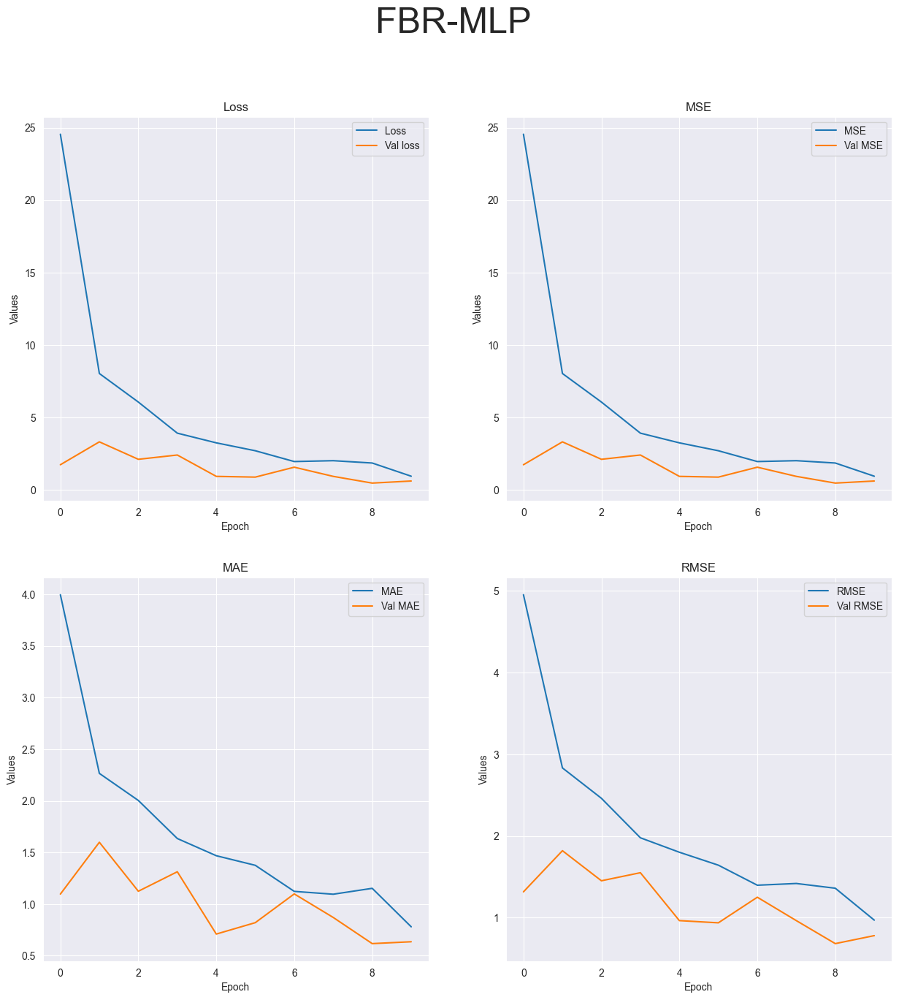

R-squared value: -0.5987


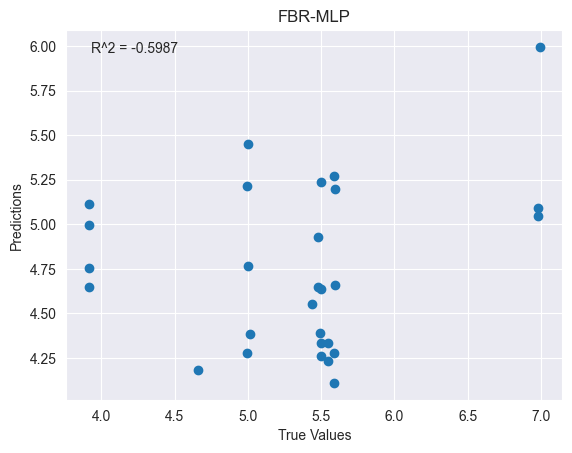

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_64"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_192 (Dense)           (None, 64)                512       
                                                                 
 dropout_48 (Dropout)        (None, 64)                0         
                                                                 
 dense_193 (Dense)           (None, 32)                2080      
                                                                 
 dropout_49 (Dropout)        (None, 32)                0         
                                               

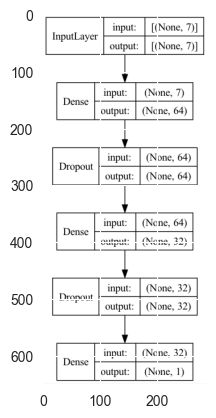

Epoch 1/20


2023-05-02 02:04:06.967989: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 199ms/step - loss: 19.8172 - mse: 19.8172 - mae: 3.6099 - root_mean_squared_error: 4.4516 - val_loss: 5.1745 - val_mse: 5.1745 - val_mae: 1.7783 - val_root_mean_squared_error: 2.2747
Epoch 2/20
3/3 [==============================] - ETA: 0s - loss: 14.1372 - mse: 14.1372 - mae: 2.9189 - root_mean_squared_error: 3.7599

2023-05-02 02:04:07.603471: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 45ms/step - loss: 14.1372 - mse: 14.1372 - mae: 2.9189 - root_mean_squared_error: 3.7599 - val_loss: 6.1763 - val_mse: 6.1763 - val_mae: 1.8408 - val_root_mean_squared_error: 2.4852
Epoch 3/20
3/3 [==============================] - 0s 24ms/step - loss: 5.8606 - mse: 5.8606 - mae: 1.9824 - root_mean_squared_error: 2.4209 - val_loss: 1.6185 - val_mse: 1.6185 - val_mae: 1.0053 - val_root_mean_squared_error: 1.2722
Epoch 4/20
3/3 [==============================] - 0s 25ms/step - loss: 2.6974 - mse: 2.6974 - mae: 1.2951 - root_mean_squared_error: 1.6424 - val_loss: 1.2992 - val_mse: 1.2992 - val_mae: 0.9752 - val_root_mean_squared_error: 1.1398
Epoch 5/20
3/3 [==============================] - 0s 26ms/step - loss: 3.3124 - mse: 3.3124 - mae: 1.4193 - root_mean_squared_error: 1.8200 - val_loss: 1.0483 - val_mse: 1.0483 - val_mae: 0.7755 - val_root_mean_squared_error: 1.0239
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 2.2272

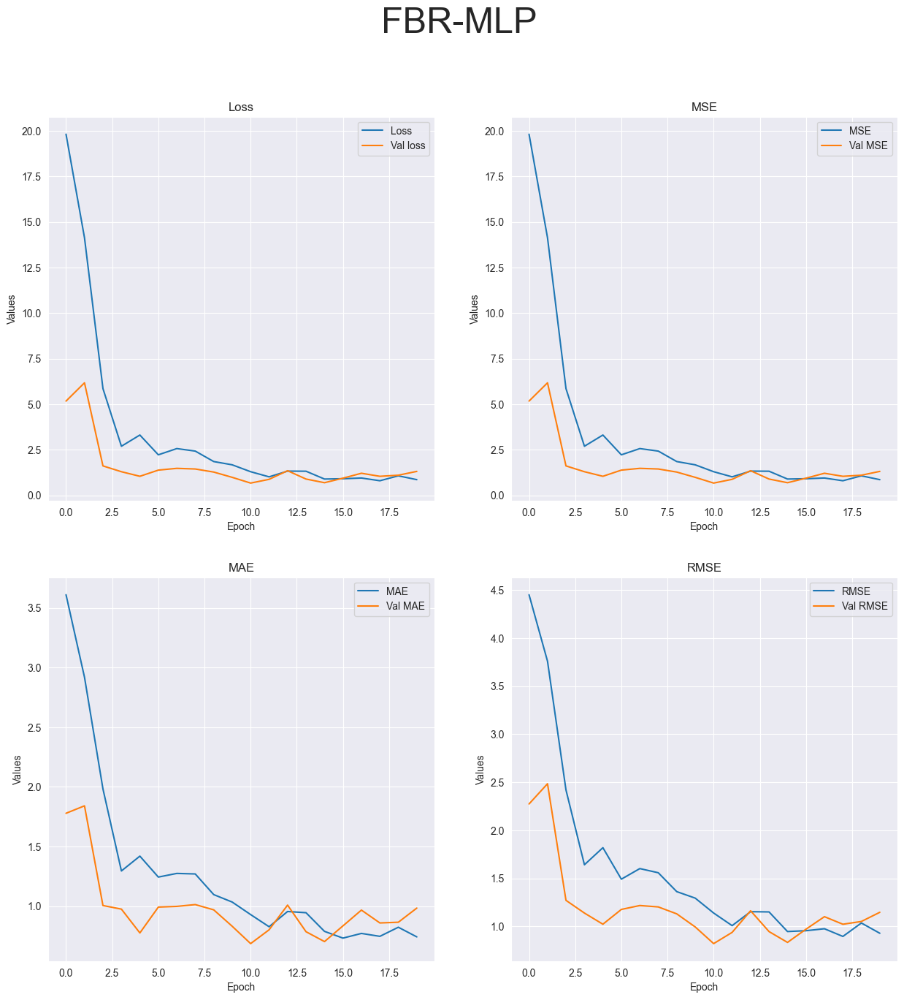

R-squared value: -1.3057


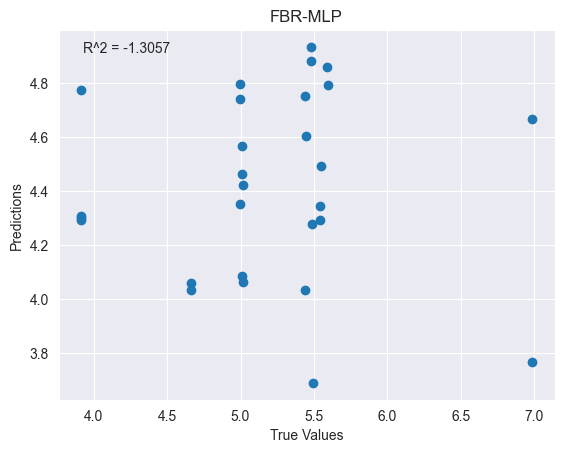

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_195 (Dense)           (None, 64)                512       
                                                                 
 dense_196 (Dense)           (None, 32)                2080      
                                                                 
 dense_197 (Dense)           (None, 16)                528       
                                                                 
 dense_198 (Dense)           (None, 1)                 17        
                    

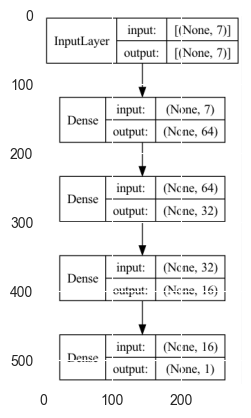

2023-05-02 02:04:10.203808: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 56ms/step - loss: 4.0082 - mse: 4.0082 - mae: 1.7156 - root_mean_squared_error: 2.0020


2023-05-02 02:04:10.690268: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [4.0082011222839355, 4.0082011222839355, 1.7155570983886719, 2.002049207687378]
['loss', 'mse', 'mae', 'root_mean_squared_error']


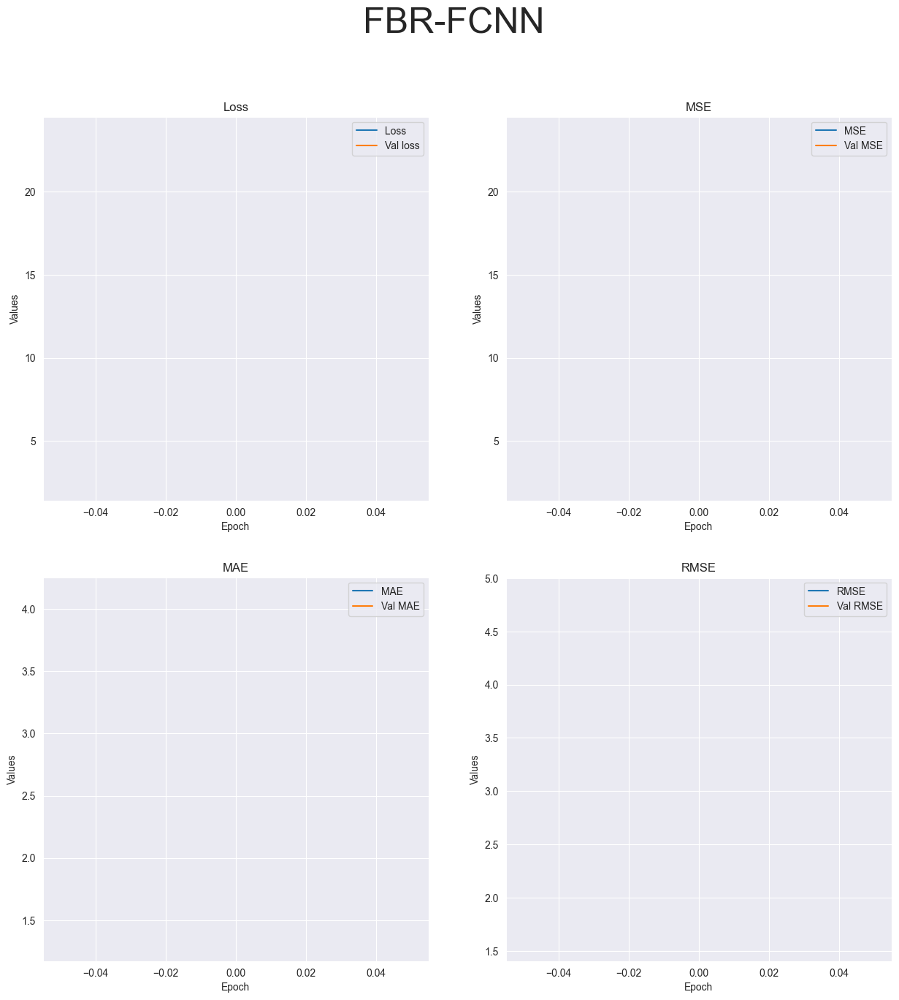

R-squared value: -7.5798


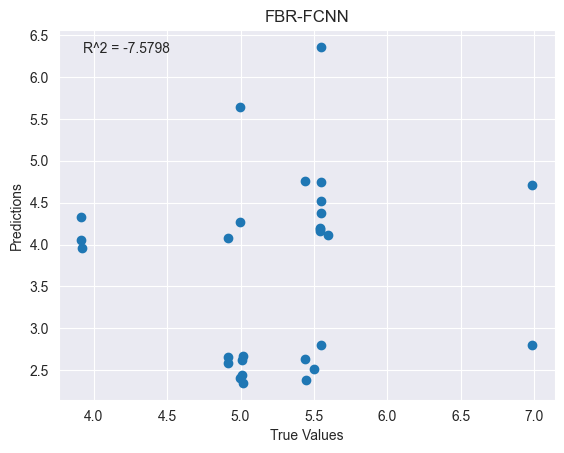

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_66"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_199 (Dense)           (None, 64)                512       
                                                                 
 dense_200 (Dense)           (None, 32)                2080      
                                                                 
 dense_201 (Dense)           (None, 16)                528       
                                                                 
 dense_202 (Dense)           (None, 1)                 17        
                                                

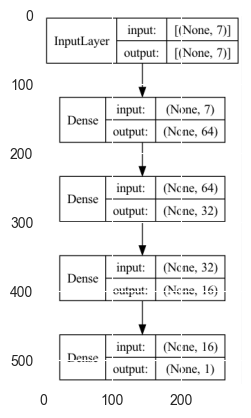

Epoch 1/4


2023-05-02 02:04:11.967393: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 182ms/step - loss: 30.4871 - mse: 30.4871 - mae: 4.9613 - root_mean_squared_error: 5.5215 - val_loss: 1.4830 - val_mse: 1.4830 - val_mae: 0.9405 - val_root_mean_squared_error: 1.2178
Epoch 2/4
3/3 [==============================] - 0s 32ms/step - loss: 4.2710 - mse: 4.2710 - mae: 1.6013 - root_mean_squared_error: 2.0666 - val_loss: 11.3091 - val_mse: 11.3091 - val_mae: 2.8575 - val_root_mean_squared_error: 3.3629
Epoch 3/4


2023-05-02 02:04:12.464018: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 49ms/step - loss: 7.7304 - mse: 7.7304 - mae: 2.2907 - root_mean_squared_error: 2.7804 - val_loss: 3.5935 - val_mse: 3.5935 - val_mae: 1.5328 - val_root_mean_squared_error: 1.8957
Epoch 4/4
1/1 [==============================] - 0s 58ms/step - loss: 1.5370 - mse: 1.5370 - mae: 1.0382 - root_mean_squared_error: 1.2398
Test loss: [1.537000060081482, 1.537000060081482, 1.038177251815796, 1.239758014678955]
['loss', 'mse', 'mae', 'root_mean_squared_error']


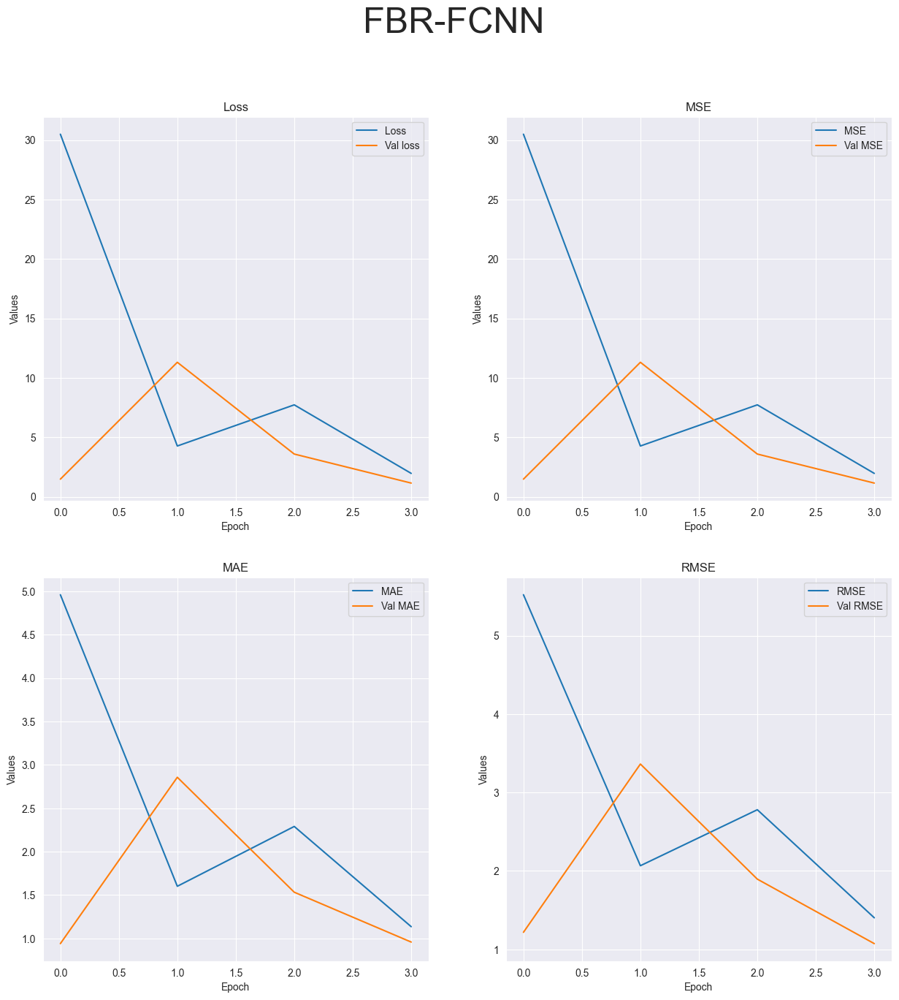

R-squared value: -1.9994


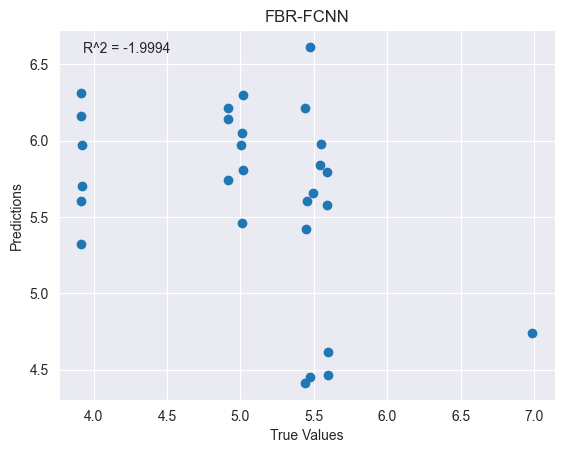

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_67"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_203 (Dense)           (None, 64)                512       
                                                                 
 dense_204 (Dense)           (None, 32)                2080      
                                                                 
 dense_205 (Dense)           (None, 16)                528       
                                                                 
 dense_206 (Dense)           (None, 1)                 17        
                                               

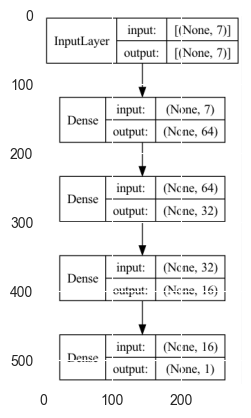

Epoch 1/10


2023-05-02 02:04:14.076861: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 182ms/step - loss: 31.4234 - mse: 31.4234 - mae: 4.9581 - root_mean_squared_error: 5.6057 - val_loss: 1.6055 - val_mse: 1.6055 - val_mae: 1.0443 - val_root_mean_squared_error: 1.2671
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 1.8898 - mse: 1.8898 - mae: 1.0211 - root_mean_squared_error: 1.3747

2023-05-02 02:04:14.603269: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 34ms/step - loss: 5.5319 - mse: 5.5319 - mae: 1.8255 - root_mean_squared_error: 2.3520 - val_loss: 12.4072 - val_mse: 12.4072 - val_mae: 2.8695 - val_root_mean_squared_error: 3.5224
Epoch 3/10
3/3 [==============================] - 0s 34ms/step - loss: 7.1076 - mse: 7.1076 - mae: 2.1988 - root_mean_squared_error: 2.6660 - val_loss: 3.9443 - val_mse: 3.9443 - val_mae: 1.5861 - val_root_mean_squared_error: 1.9860
Epoch 4/10
3/3 [==============================] - 0s 28ms/step - loss: 1.8268 - mse: 1.8268 - mae: 1.0771 - root_mean_squared_error: 1.3516 - val_loss: 1.2877 - val_mse: 1.2877 - val_mae: 0.8765 - val_root_mean_squared_error: 1.1348
Epoch 5/10
3/3 [==============================] - 0s 27ms/step - loss: 1.0100 - mse: 1.0100 - mae: 0.7593 - root_mean_squared_error: 1.0050 - val_loss: 0.5366 - val_mse: 0.5366 - val_mae: 0.5678 - val_root_mean_squared_error: 0.7326
Epoch 6/10
3/3 [==============================] - 0s 18ms/step - loss: 0.9787

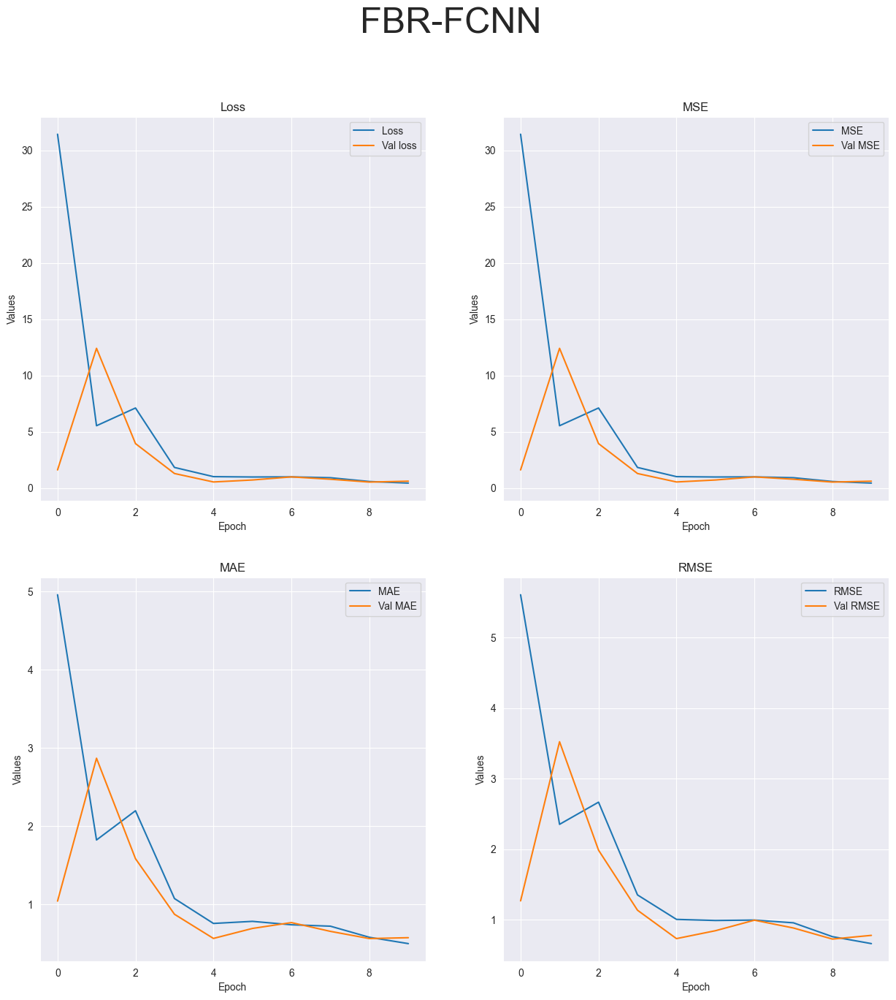

R-squared value: -0.0638


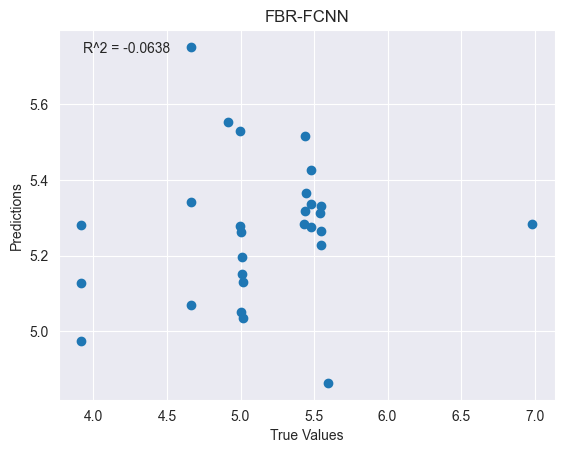

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_68"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_207 (Dense)           (None, 64)                512       
                                                                 
 dense_208 (Dense)           (None, 32)                2080      
                                                                 
 dense_209 (Dense)           (None, 16)                528       
                                                                 
 dense_210 (Dense)           (None, 1)                 17        
                                               

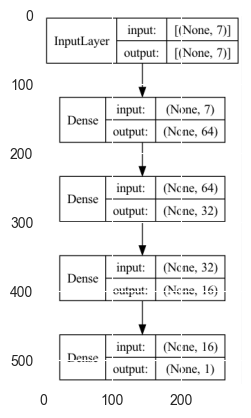

Epoch 1/20


2023-05-02 02:04:17.179709: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 166ms/step - loss: 26.9379 - mse: 26.9379 - mae: 4.4469 - root_mean_squared_error: 5.1902 - val_loss: 1.5120 - val_mse: 1.5120 - val_mae: 0.9382 - val_root_mean_squared_error: 1.2296
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 0.9803 - mse: 0.9803 - mae: 0.8029 - root_mean_squared_error: 0.9901

2023-05-02 02:04:17.739044: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 59ms/step - loss: 5.0455 - mse: 5.0455 - mae: 1.8855 - root_mean_squared_error: 2.2462 - val_loss: 7.0927 - val_mse: 7.0927 - val_mae: 2.4838 - val_root_mean_squared_error: 2.6632
Epoch 3/20
3/3 [==============================] - 0s 27ms/step - loss: 4.8414 - mse: 4.8414 - mae: 1.9110 - root_mean_squared_error: 2.2003 - val_loss: 0.8340 - val_mse: 0.8340 - val_mae: 0.7635 - val_root_mean_squared_error: 0.9133
Epoch 4/20
3/3 [==============================] - 0s 27ms/step - loss: 1.3814 - mse: 1.3814 - mae: 0.9269 - root_mean_squared_error: 1.1753 - val_loss: 1.5534 - val_mse: 1.5534 - val_mae: 1.0792 - val_root_mean_squared_error: 1.2464
Epoch 5/20
3/3 [==============================] - 0s 20ms/step - loss: 1.5883 - mse: 1.5883 - mae: 1.0955 - root_mean_squared_error: 1.2603 - val_loss: 0.8720 - val_mse: 0.8720 - val_mae: 0.7436 - val_root_mean_squared_error: 0.9338
Epoch 6/20
3/3 [==============================] - 0s 22ms/step - loss: 0.6332 -

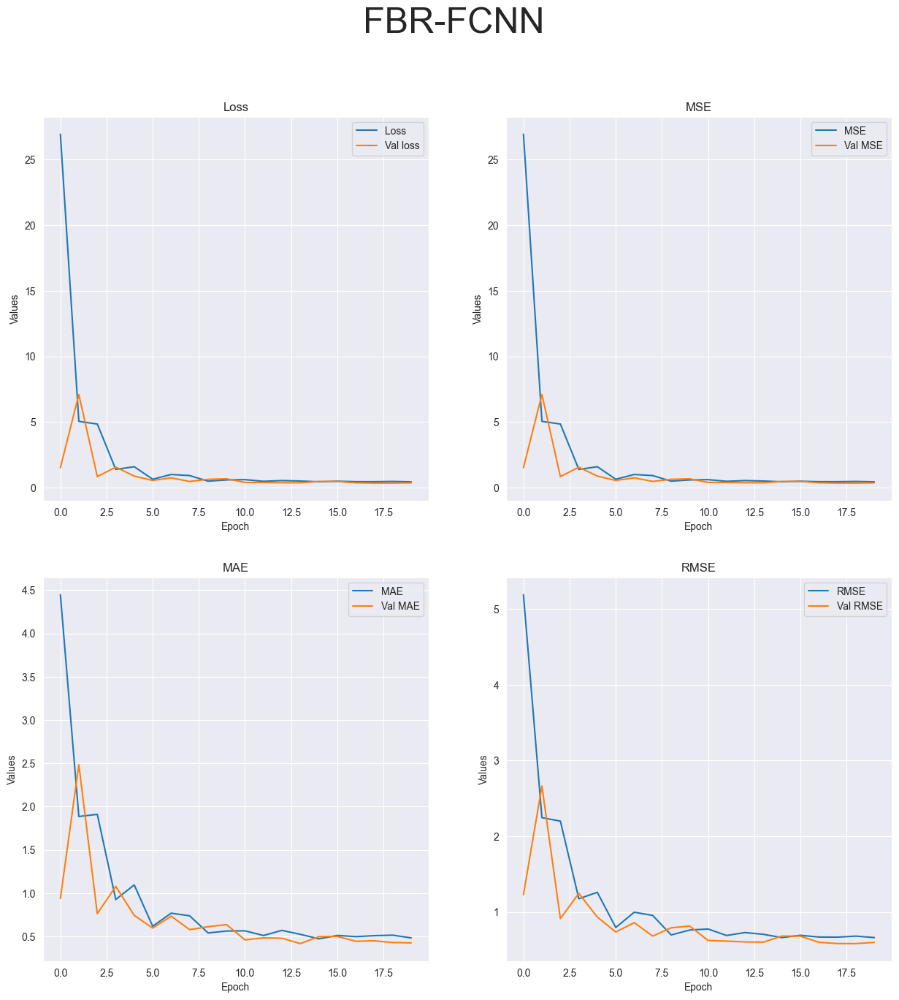

R-squared value: 0.0466


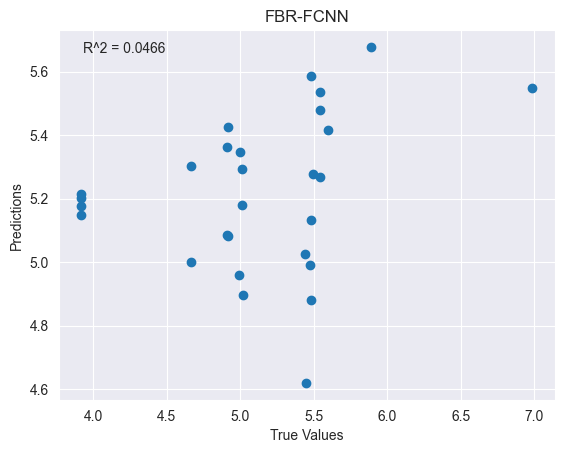

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_69"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_211 (Dense)           (None, 128)               1024      
                                                                 
 dense_212 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


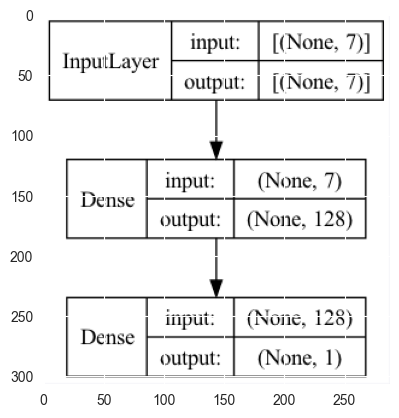

2023-05-02 02:04:20.185177: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 155ms/step - loss: 25.2156 - mse: 25.0800 - mae: 4.2259 - root_mean_squared_error: 5.0080 - val_loss: 1.7386 - val_mse: 1.6043 - val_mae: 1.0690 - val_root_mean_squared_error: 1.2666


2023-05-02 02:04:20.605254: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 65ms/step - loss: 2.7656 - mse: 2.6312 - mae: 1.3787 - root_mean_squared_error: 1.6221
Test loss: [2.7656028270721436, 2.6312310695648193, 1.3786942958831787, 1.6221070289611816]
['loss', 'mse', 'mae', 'root_mean_squared_error']


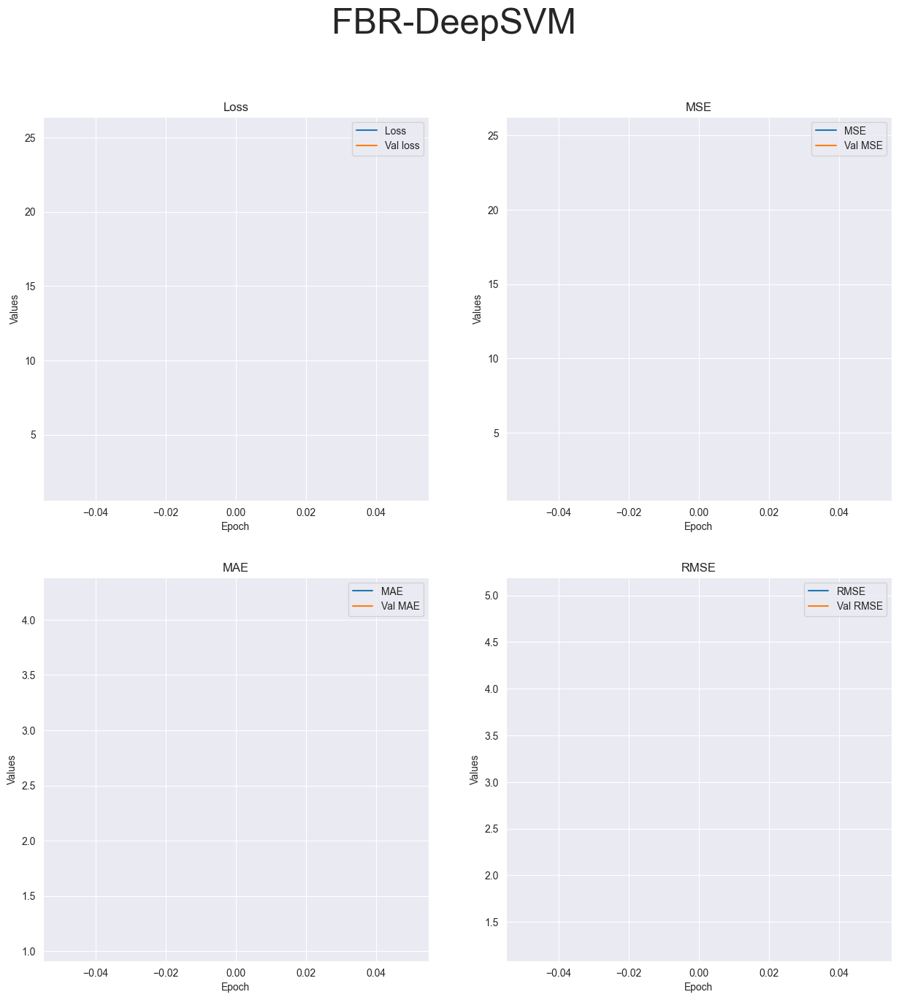

R-squared value: -5.4110


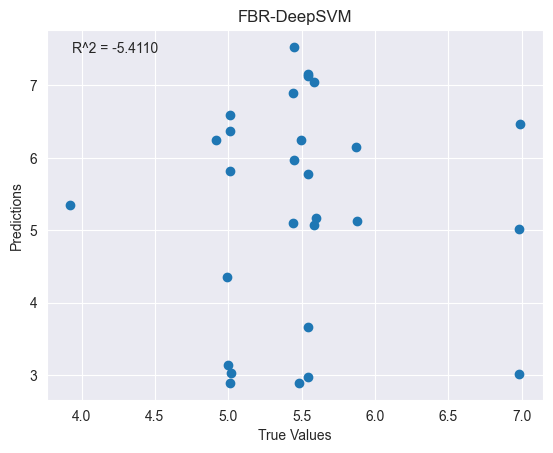

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_70"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_213 (Dense)           (None, 128)               1024      
                                                                 
 dense_214 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


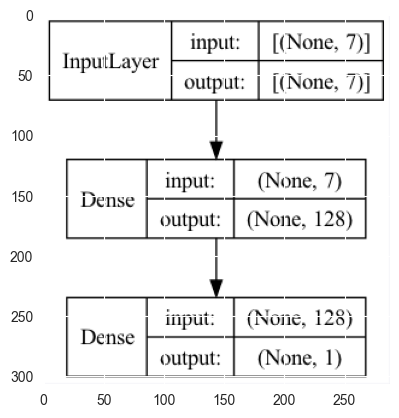

Epoch 1/4


2023-05-02 02:04:21.969481: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 159ms/step - loss: 24.8490 - mse: 24.7132 - mae: 4.2316 - root_mean_squared_error: 4.9712 - val_loss: 3.6747 - val_mse: 3.5396 - val_mae: 1.5950 - val_root_mean_squared_error: 1.8814
Epoch 2/4
3/3 [==============================] - 0s 32ms/step - loss: 7.6417 - mse: 7.5078 - mae: 2.2997 - root_mean_squared_error: 2.7400 - val_loss: 20.5692 - val_mse: 20.4369 - val_mae: 3.8042 - val_root_mean_squared_error: 4.5207
Epoch 3/4


2023-05-02 02:04:22.403572: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 46ms/step - loss: 13.3508 - mse: 13.2185 - mae: 2.8892 - root_mean_squared_error: 3.6357 - val_loss: 2.4157 - val_mse: 2.2828 - val_mae: 1.3284 - val_root_mean_squared_error: 1.5109
Epoch 4/4
1/1 [==============================] - 0s 50ms/step - loss: 9.2898 - mse: 9.1567 - mae: 2.6482 - root_mean_squared_error: 3.0260
Test loss: [9.289780616760254, 9.15672492980957, 2.6481831073760986, 3.026008129119873]
['loss', 'mse', 'mae', 'root_mean_squared_error']


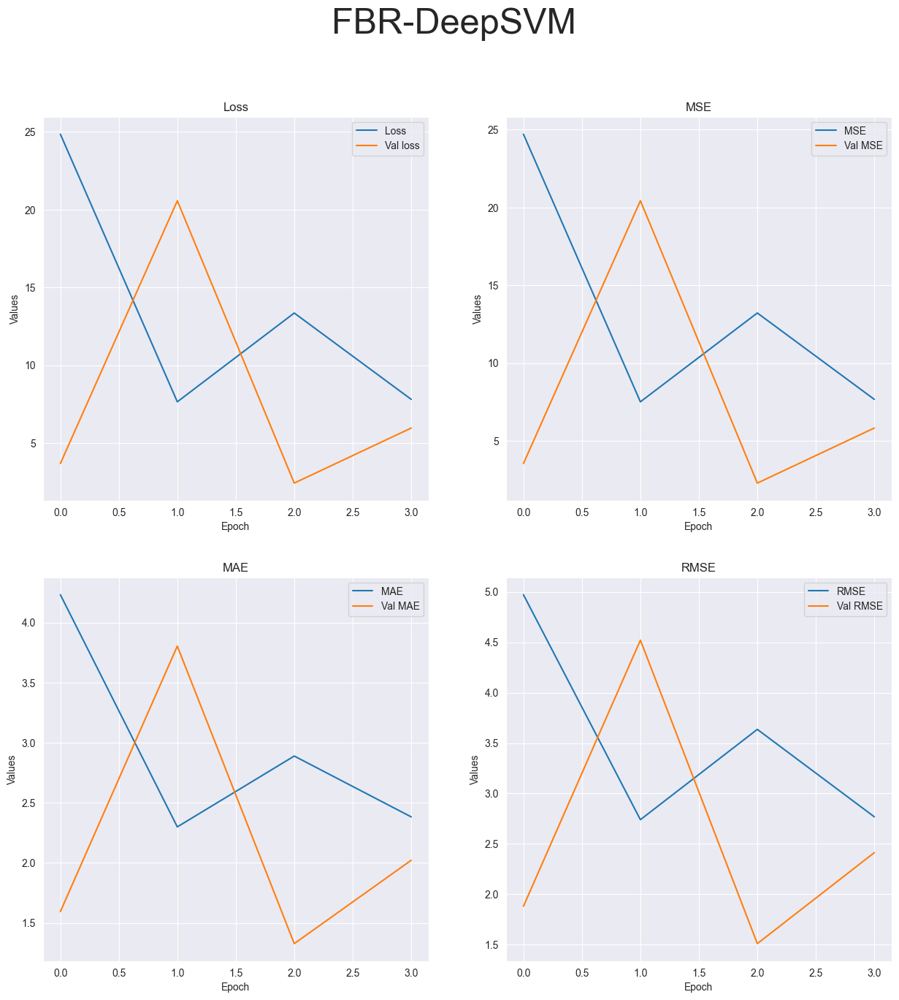

R-squared value: -15.8141


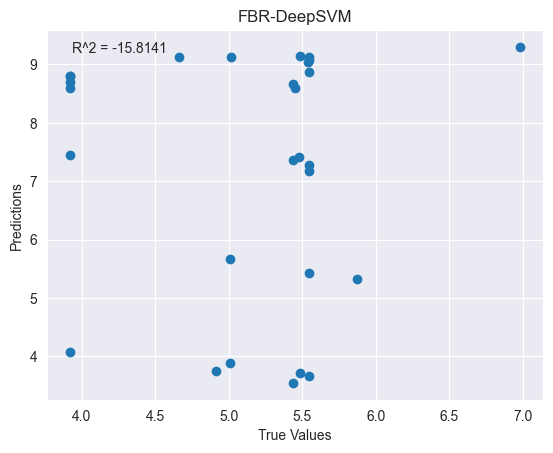

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_71"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_215 (Dense)           (None, 128)               1024      
                                                                 
 dense_216 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


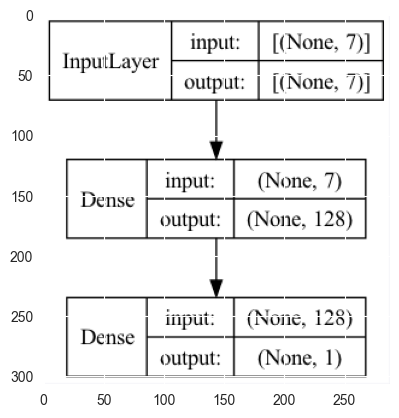

Epoch 1/10


2023-05-02 02:04:23.911584: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 160ms/step - loss: 21.7157 - mse: 21.5802 - mae: 4.0190 - root_mean_squared_error: 4.6454 - val_loss: 6.6660 - val_mse: 6.5317 - val_mae: 1.9503 - val_root_mean_squared_error: 2.5557
Epoch 2/10
3/3 [==============================] - 0s 30ms/step - loss: 18.5159 - mse: 18.3822 - mae: 3.5913 - root_mean_squared_error: 4.2874 - val_loss: 3.5999 - val_mse: 3.4666 - val_mae: 1.6157 - val_root_mean_squared_error: 1.8619
Epoch 3/10


2023-05-02 02:04:24.336686: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 43ms/step - loss: 7.0901 - mse: 6.9565 - mae: 2.2329 - root_mean_squared_error: 2.6375 - val_loss: 7.4398 - val_mse: 7.3063 - val_mae: 2.2303 - val_root_mean_squared_error: 2.7030
Epoch 4/10
3/3 [==============================] - 0s 18ms/step - loss: 8.0779 - mse: 7.9452 - mae: 2.3159 - root_mean_squared_error: 2.8187 - val_loss: 4.7297 - val_mse: 4.5984 - val_mae: 1.6620 - val_root_mean_squared_error: 2.1444
Epoch 5/10
3/3 [==============================] - 0s 23ms/step - loss: 6.8981 - mse: 6.7670 - mae: 2.2333 - root_mean_squared_error: 2.6014 - val_loss: 3.2709 - val_mse: 3.1399 - val_mae: 1.4520 - val_root_mean_squared_error: 1.7720
Epoch 6/10
3/3 [==============================] - 0s 19ms/step - loss: 2.7926 - mse: 2.6614 - mae: 1.3343 - root_mean_squared_error: 1.6314 - val_loss: 4.7747 - val_mse: 4.6430 - val_mae: 1.8256 - val_root_mean_squared_error: 2.1548
Epoch 7/10
3/3 [==============================] - 0s 19ms/step - loss: 5.6213 -

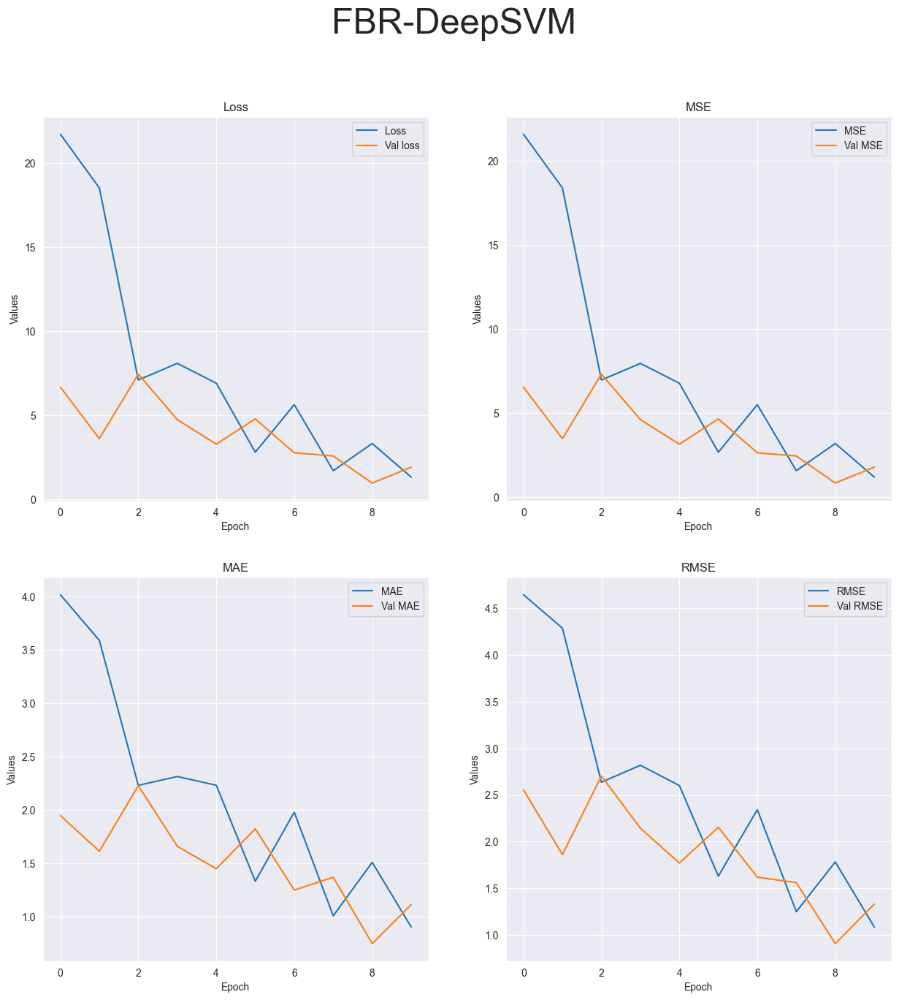

R-squared value: -5.0230


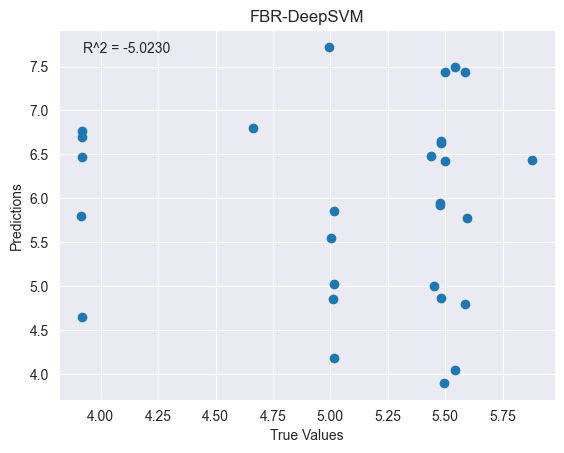

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_72"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_217 (Dense)           (None, 128)               1024      
                                                                 
 dense_218 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


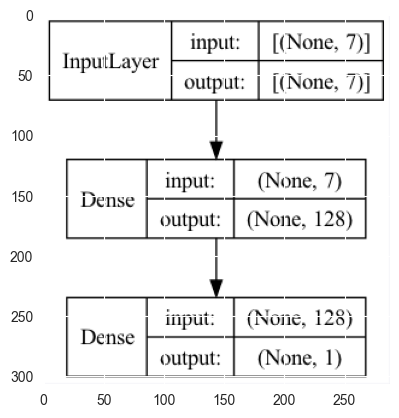

Epoch 1/20


2023-05-02 02:04:26.905163: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 154ms/step - loss: 22.6463 - mse: 22.5105 - mae: 4.0325 - root_mean_squared_error: 4.7445 - val_loss: 6.7683 - val_mse: 6.6328 - val_mae: 2.1378 - val_root_mean_squared_error: 2.5754
Epoch 2/20
3/3 [==============================] - 0s 33ms/step - loss: 11.5473 - mse: 11.4131 - mae: 2.8984 - root_mean_squared_error: 3.3783 - val_loss: 13.3183 - val_mse: 13.1865 - val_mae: 3.1642 - val_root_mean_squared_error: 3.6313
Epoch 3/20
1/3 [=========>....................] - ETA: 0s - loss: 10.3570 - mse: 10.2251 - mae: 2.6290 - root_mean_squared_error: 3.1977

2023-05-02 02:04:27.449249: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 20ms/step - loss: 7.0948 - mse: 6.9632 - mae: 2.1611 - root_mean_squared_error: 2.6388 - val_loss: 6.1552 - val_mse: 6.0235 - val_mae: 2.0581 - val_root_mean_squared_error: 2.4543
Epoch 4/20
3/3 [==============================] - 0s 58ms/step - loss: 8.6309 - mse: 8.4991 - mae: 2.3975 - root_mean_squared_error: 2.9153 - val_loss: 5.9071 - val_mse: 5.7754 - val_mae: 2.0334 - val_root_mean_squared_error: 2.4032
Epoch 5/20
3/3 [==============================] - 0s 23ms/step - loss: 3.1826 - mse: 3.0514 - mae: 1.4090 - root_mean_squared_error: 1.7468 - val_loss: 3.9727 - val_mse: 3.8427 - val_mae: 1.7197 - val_root_mean_squared_error: 1.9603
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 4.5686 - mse: 4.4390 - mae: 1.8141 - root_mean_squared_error: 2.1069 - val_loss: 2.1644 - val_mse: 2.0355 - val_mae: 1.1063 - val_root_mean_squared_error: 1.4267
Epoch 7/20
3/3 [==============================] - 0s 18ms/step - loss: 3.0599 -

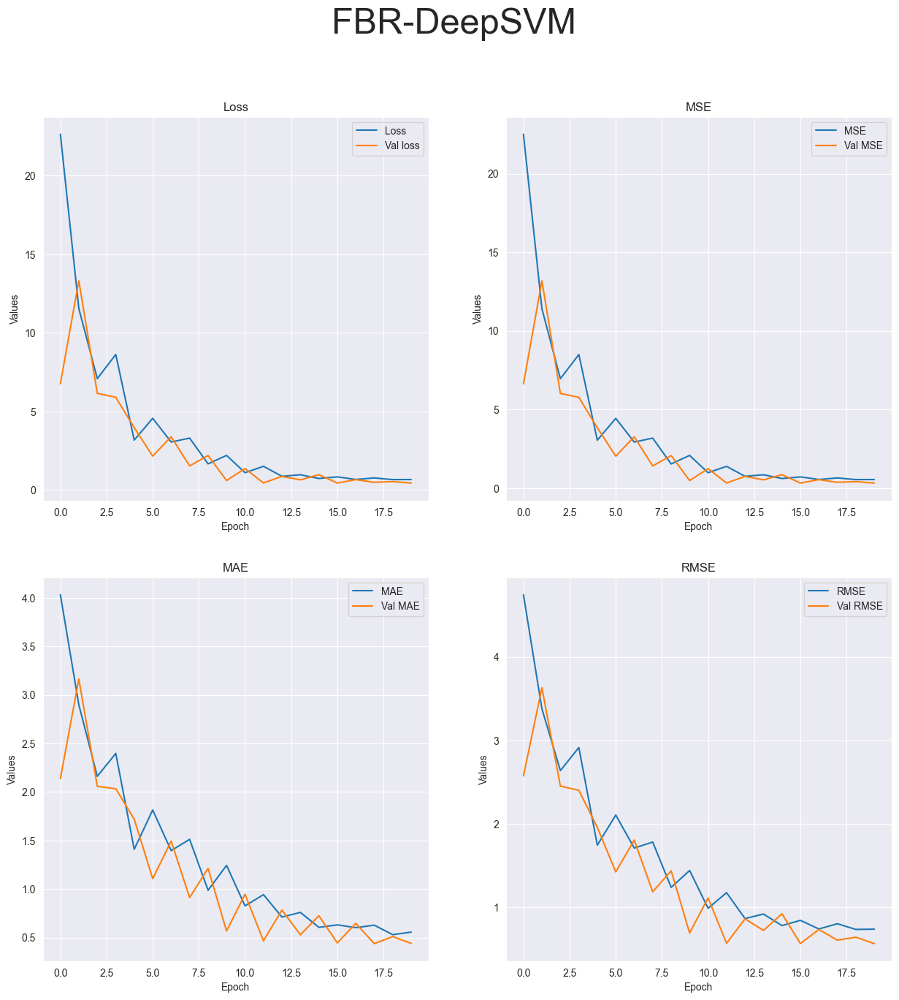

R-squared value: -0.3582


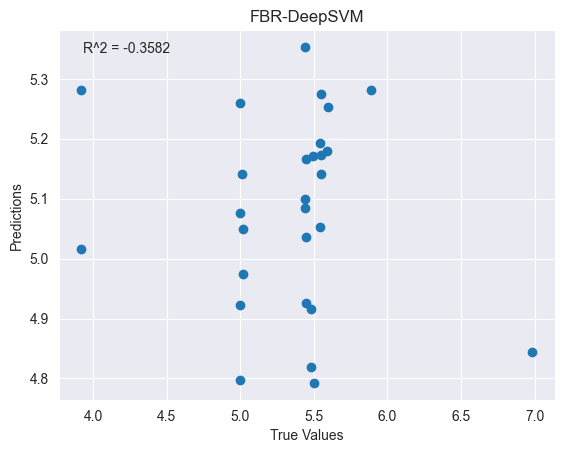

Running tests on CBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_73"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_219 (Dense)           (None, 64)                256       
                                                                 
 dropout_50 (Dropout)        (None, 64)                0         
                                                                 
 dense_220 (Dense)           (None, 32)                2080      
                                                                 
 dropout_51 (Dropout)        (None, 32)                0         
                                                                 
 dense_221 (Dense)           (None, 1)                 33 

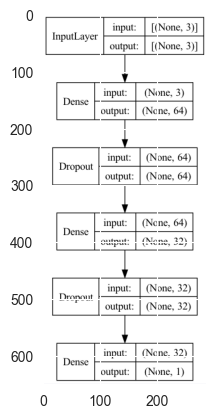

2023-05-02 02:04:29.846142: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 214ms/step - loss: 88.7235 - mse: 88.7235 - mae: 7.8519 - root_mean_squared_error: 9.4193 - val_loss: 7.8710 - val_mse: 7.8710 - val_mae: 2.5713 - val_root_mean_squared_error: 2.8055


2023-05-02 02:04:30.531582: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 79ms/step - loss: 8.3416 - mse: 8.3416 - mae: 2.7071 - root_mean_squared_error: 2.8882
Test loss: [8.341559410095215, 8.341559410095215, 2.7070834636688232, 2.8881757259368896]
['loss', 'mse', 'mae', 'root_mean_squared_error']


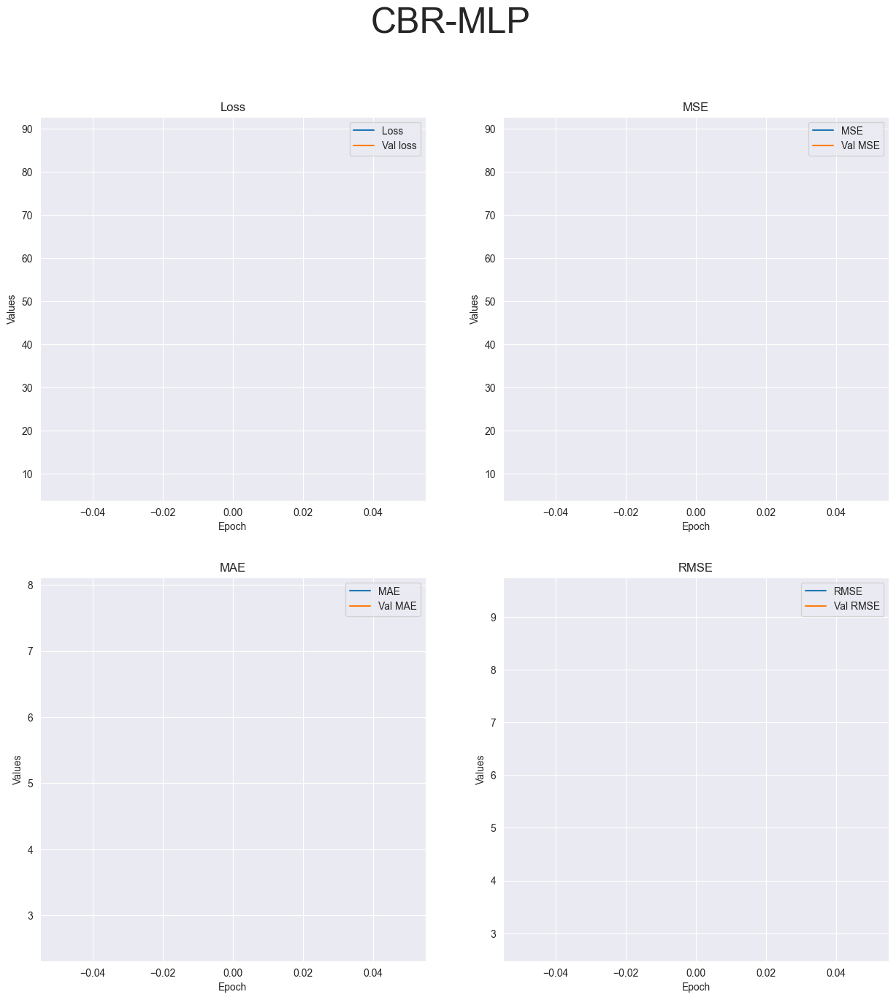

R-squared value: -16.5569


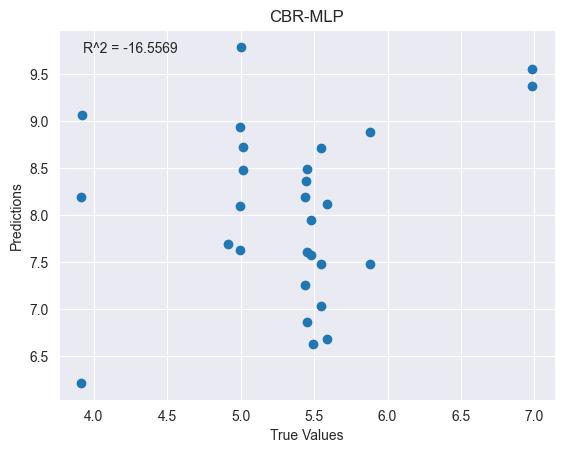

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_74"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_222 (Dense)           (None, 64)                256       
                                                                 
 dropout_52 (Dropout)        (None, 64)                0         
                                                                 
 dense_223 (Dense)           (None, 32)                2080      
                                                                 
 dropout_53 (Dropout)        (None, 32)                0         
                                                                 
 dense_224 (Dense)           (None, 1)                 33        
                                                       

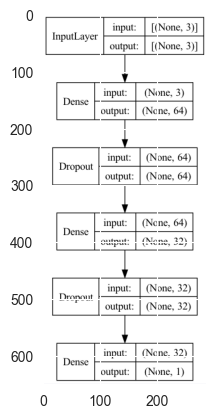

Epoch 1/4


2023-05-02 02:04:31.995502: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 219ms/step - loss: 101.5132 - mse: 101.5132 - mae: 8.1485 - root_mean_squared_error: 10.0754 - val_loss: 1.0855 - val_mse: 1.0855 - val_mae: 0.8321 - val_root_mean_squared_error: 1.0419
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 38.8537 - mse: 38.8537 - mae: 4.9978 - root_mean_squared_error: 6.2333

2023-05-02 02:04:32.654592: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 31ms/step - loss: 51.1154 - mse: 51.1154 - mae: 5.7664 - root_mean_squared_error: 7.1495 - val_loss: 17.4782 - val_mse: 17.4782 - val_mae: 4.1128 - val_root_mean_squared_error: 4.1807
Epoch 3/4
3/3 [==============================] - 0s 38ms/step - loss: 24.1247 - mse: 24.1247 - mae: 3.8965 - root_mean_squared_error: 4.9117 - val_loss: 1.5336 - val_mse: 1.5336 - val_mae: 1.0809 - val_root_mean_squared_error: 1.2384
Epoch 4/4
1/1 [==============================] - 0s 55ms/step - loss: 0.7194 - mse: 0.7194 - mae: 0.7139 - root_mean_squared_error: 0.8482
Test loss: [0.7193742394447327, 0.7193742394447327, 0.7139344811439514, 0.8481593132019043]
['loss', 'mse', 'mae', 'root_mean_squared_error']


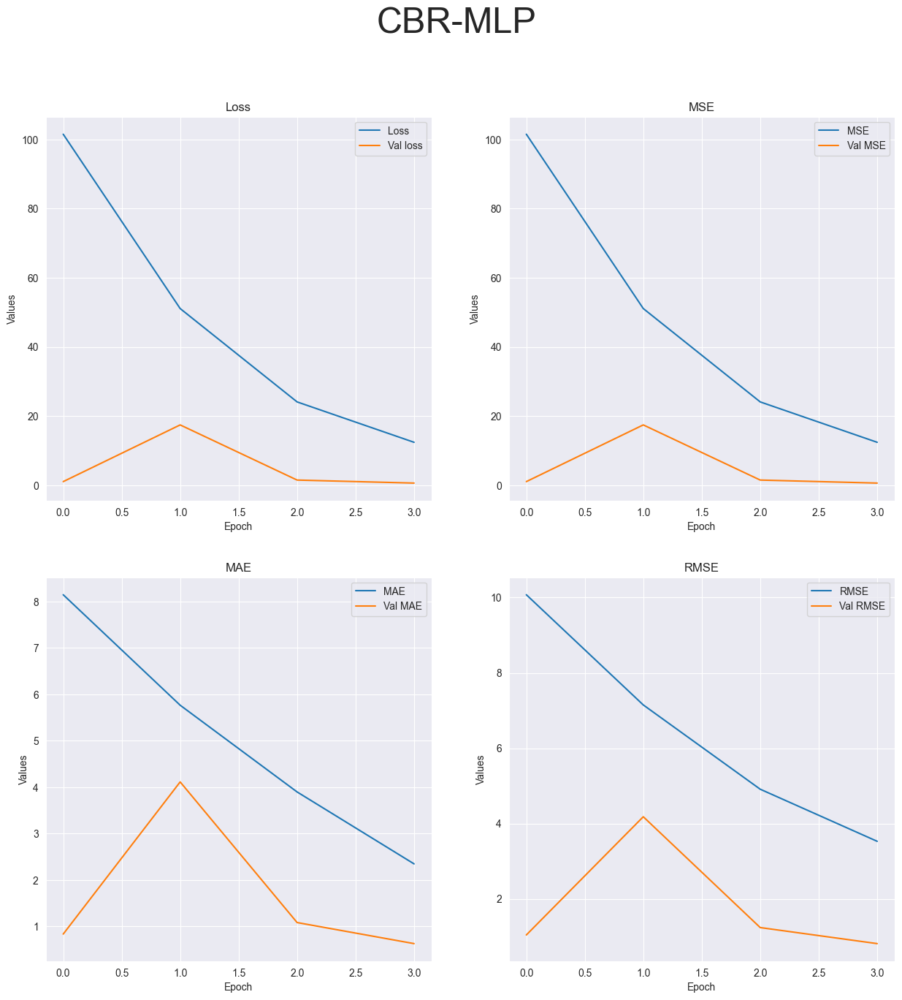

R-squared value: -0.1968


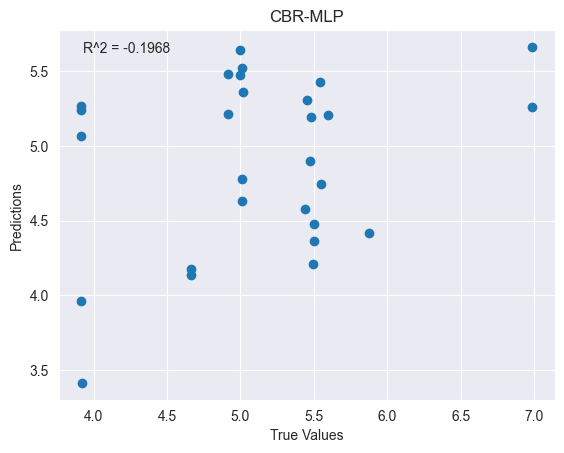

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_75"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_225 (Dense)           (None, 64)                256       
                                                                 
 dropout_54 (Dropout)        (None, 64)                0         
                                                                 
 dense_226 (Dense)           (None, 32)                2080      
                                                                 
 dropout_55 (Dropout)        (None, 32)                0         
                                                                 
 dense_227 (Dense)           (None, 1)                 33        
                                                      

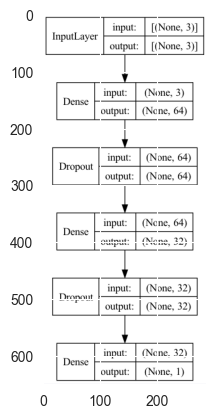

Epoch 1/10


2023-05-02 02:04:34.255103: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 205ms/step - loss: 129.9787 - mse: 129.9787 - mae: 9.2725 - root_mean_squared_error: 11.4008 - val_loss: 19.8792 - val_mse: 19.8792 - val_mae: 4.2960 - val_root_mean_squared_error: 4.4586
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 43.1667 - mse: 43.1667 - mae: 5.6274 - root_mean_squared_error: 6.5701

2023-05-02 02:04:34.832981: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 41ms/step - loss: 40.1281 - mse: 40.1281 - mae: 4.6618 - root_mean_squared_error: 6.3347 - val_loss: 1.1892 - val_mse: 1.1892 - val_mae: 0.9054 - val_root_mean_squared_error: 1.0905
Epoch 3/10
3/3 [==============================] - 0s 33ms/step - loss: 14.0624 - mse: 14.0624 - mae: 2.7875 - root_mean_squared_error: 3.7500 - val_loss: 3.5380 - val_mse: 3.5380 - val_mae: 1.7323 - val_root_mean_squared_error: 1.8809
Epoch 4/10
3/3 [==============================] - 0s 18ms/step - loss: 13.5164 - mse: 13.5164 - mae: 2.1530 - root_mean_squared_error: 3.6765 - val_loss: 2.8301 - val_mse: 2.8301 - val_mae: 1.5042 - val_root_mean_squared_error: 1.6823
Epoch 5/10
3/3 [==============================] - 0s 30ms/step - loss: 9.4178 - mse: 9.4178 - mae: 2.3675 - root_mean_squared_error: 3.0688 - val_loss: 15.5245 - val_mse: 15.5245 - val_mae: 3.8800 - val_root_mean_squared_error: 3.9401
Epoch 6/10
3/3 [==============================] - 0s 31ms/step - loss: 

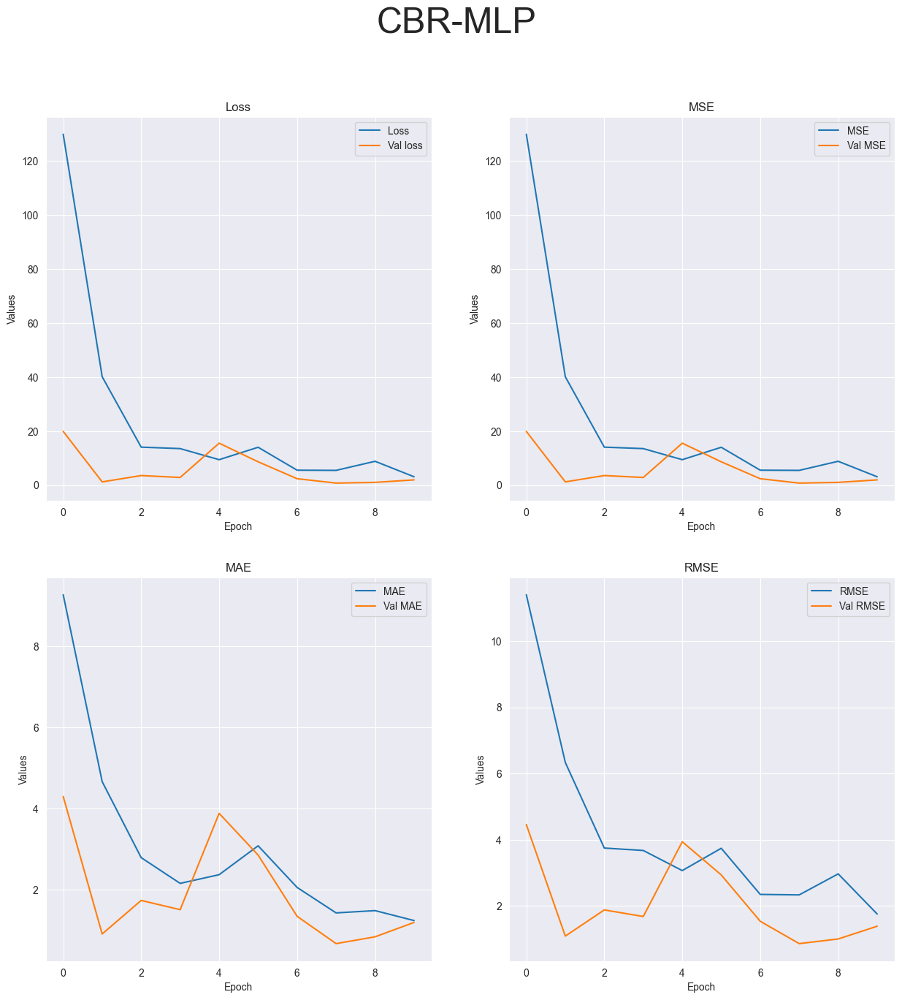

R-squared value: -4.1223


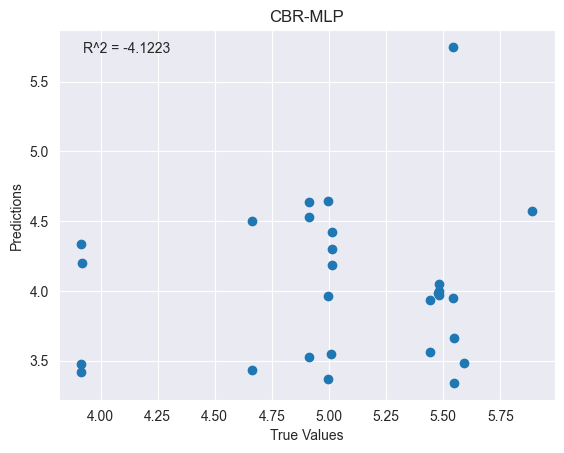

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_76"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_228 (Dense)           (None, 64)                256       
                                                                 
 dropout_56 (Dropout)        (None, 64)                0         
                                                                 
 dense_229 (Dense)           (None, 32)                2080      
                                                                 
 dropout_57 (Dropout)        (None, 32)                0         
                                                                 
 dense_230 (Dense)           (None, 1)                 33        
                                                      

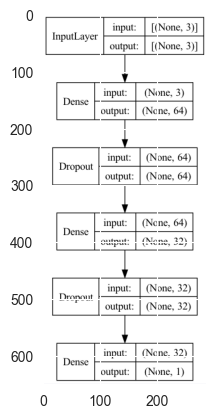

Epoch 1/20


2023-05-02 02:04:37.656804: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 201ms/step - loss: 134.4249 - mse: 134.4249 - mae: 9.0209 - root_mean_squared_error: 11.5942 - val_loss: 1.7458 - val_mse: 1.7458 - val_mae: 1.0986 - val_root_mean_squared_error: 1.3213
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 29.5543 - mse: 29.5543 - mae: 4.0905 - root_mean_squared_error: 5.4364

2023-05-02 02:04:38.437236: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 55ms/step - loss: 40.9982 - mse: 40.9982 - mae: 4.9701 - root_mean_squared_error: 6.4030 - val_loss: 22.5701 - val_mse: 22.5701 - val_mae: 4.6885 - val_root_mean_squared_error: 4.7508
Epoch 3/20
3/3 [==============================] - 0s 31ms/step - loss: 40.5406 - mse: 40.5406 - mae: 5.4644 - root_mean_squared_error: 6.3672 - val_loss: 4.4012 - val_mse: 4.4012 - val_mae: 1.9785 - val_root_mean_squared_error: 2.0979
Epoch 4/20
3/3 [==============================] - 0s 27ms/step - loss: 13.7291 - mse: 13.7291 - mae: 2.7549 - root_mean_squared_error: 3.7053 - val_loss: 0.5448 - val_mse: 0.5448 - val_mae: 0.6289 - val_root_mean_squared_error: 0.7381
Epoch 5/20
3/3 [==============================] - 0s 22ms/step - loss: 5.3272 - mse: 5.3272 - mae: 1.8207 - root_mean_squared_error: 2.3081 - val_loss: 0.5301 - val_mse: 0.5301 - val_mae: 0.6181 - val_root_mean_squared_error: 0.7281
Epoch 6/20
3/3 [==============================] - 0s 19ms/step - loss: 

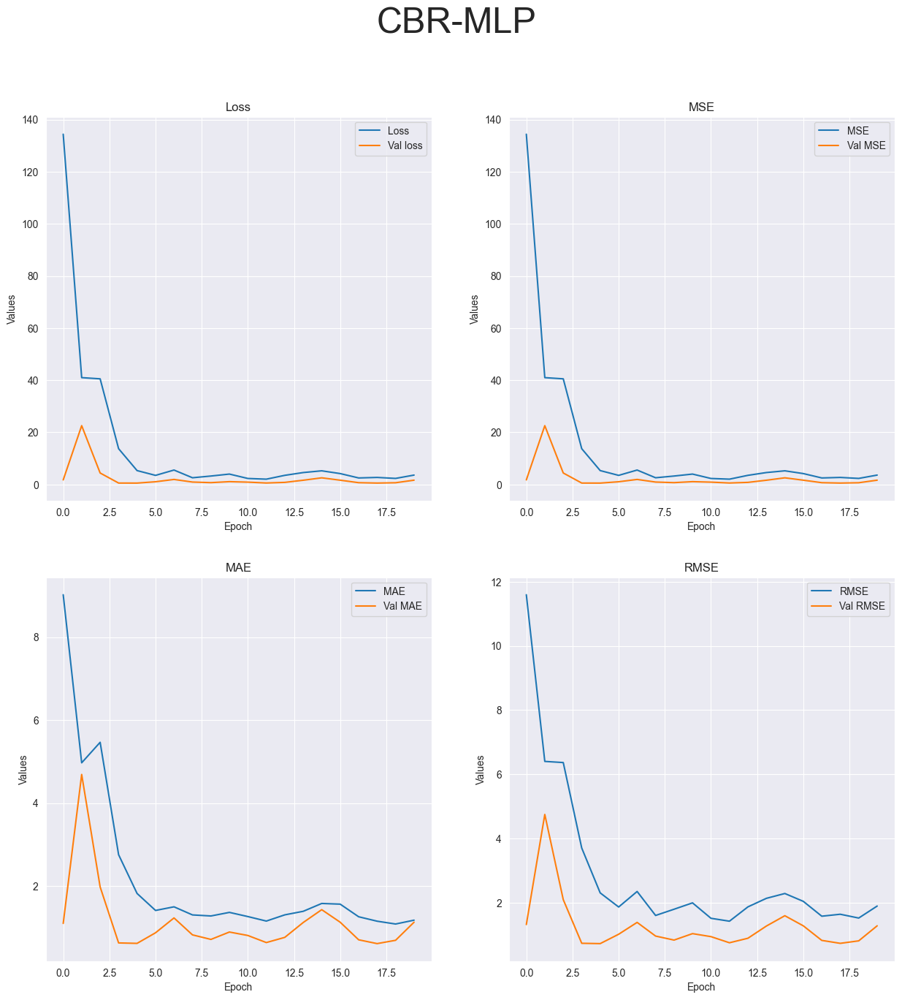

R-squared value: -2.2552


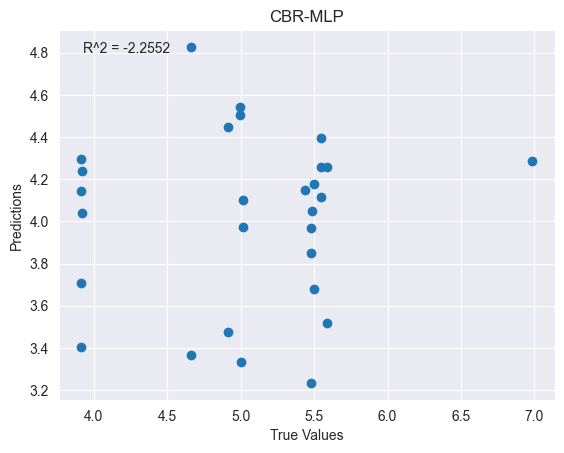

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_77"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_231 (Dense)           (None, 64)                256       
                                                                 
 dense_232 (Dense)           (None, 32)                2080      
                                                                 
 dense_233 (Dense)           (None, 16)                528       
                                                                 
 dense_234 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
_________________________

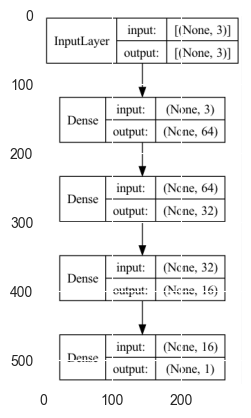

2023-05-02 02:04:41.030468: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 171ms/step - loss: 164.9819 - mse: 164.9819 - mae: 10.2415 - root_mean_squared_error: 12.8445 - val_loss: 64.3261 - val_mse: 64.3261 - val_mae: 8.0011 - val_root_mean_squared_error: 8.0204


2023-05-02 02:04:41.583506: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 63ms/step - loss: 63.5348 - mse: 63.5348 - mae: 7.9337 - root_mean_squared_error: 7.9709
Test loss: [63.534793853759766, 63.534793853759766, 7.933653831481934, 7.970871448516846]
['loss', 'mse', 'mae', 'root_mean_squared_error']


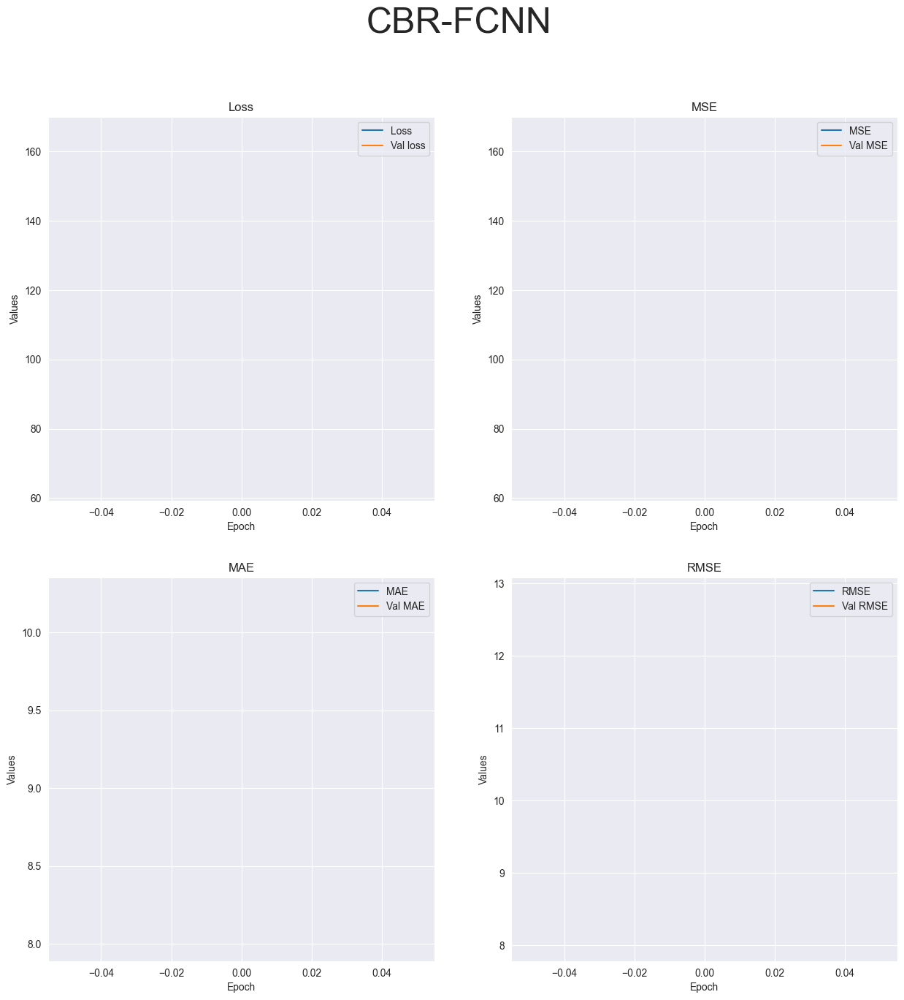

R-squared value: -184.5736


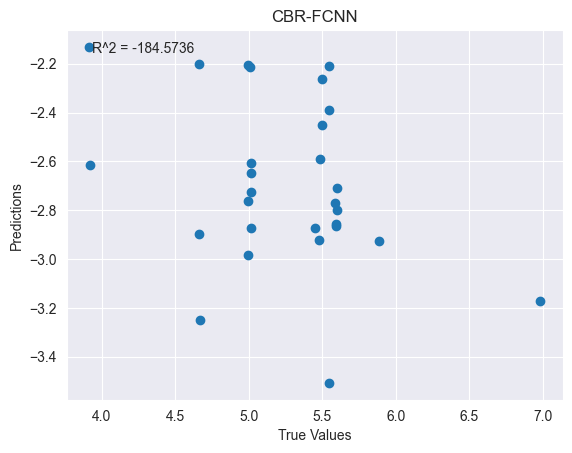

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_78"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_235 (Dense)           (None, 64)                256       
                                                                 
 dense_236 (Dense)           (None, 32)                2080      
                                                                 
 dense_237 (Dense)           (None, 16)                528       
                                                                 
 dense_238 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
_____________________________________________________

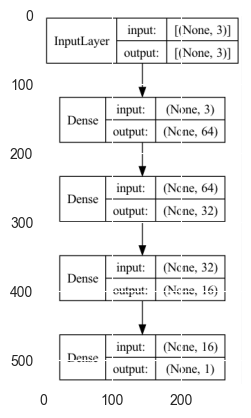

Epoch 1/4


2023-05-02 02:04:42.993952: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 175ms/step - loss: 252.3723 - mse: 252.3723 - mae: 10.6037 - root_mean_squared_error: 15.8862 - val_loss: 47.8520 - val_mse: 47.8520 - val_mae: 6.8930 - val_root_mean_squared_error: 6.9175
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 48.3972 - mse: 48.3972 - mae: 6.9137 - root_mean_squared_error: 6.9568

2023-05-02 02:04:43.564398: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 31ms/step - loss: 122.2798 - mse: 122.2798 - mae: 10.3596 - root_mean_squared_error: 11.0580 - val_loss: 75.4609 - val_mse: 75.4609 - val_mae: 8.6587 - val_root_mean_squared_error: 8.6868
Epoch 3/4
3/3 [==============================] - 0s 44ms/step - loss: 41.4716 - mse: 41.4716 - mae: 5.9050 - root_mean_squared_error: 6.4398 - val_loss: 0.7535 - val_mse: 0.7535 - val_mae: 0.7155 - val_root_mean_squared_error: 0.8681
Epoch 4/4
1/1 [==============================] - 0s 59ms/step - loss: 2.0126 - mse: 2.0126 - mae: 1.2170 - root_mean_squared_error: 1.4187
Test loss: [2.0126430988311768, 2.0126430988311768, 1.2170456647872925, 1.418676495552063]
['loss', 'mse', 'mae', 'root_mean_squared_error']


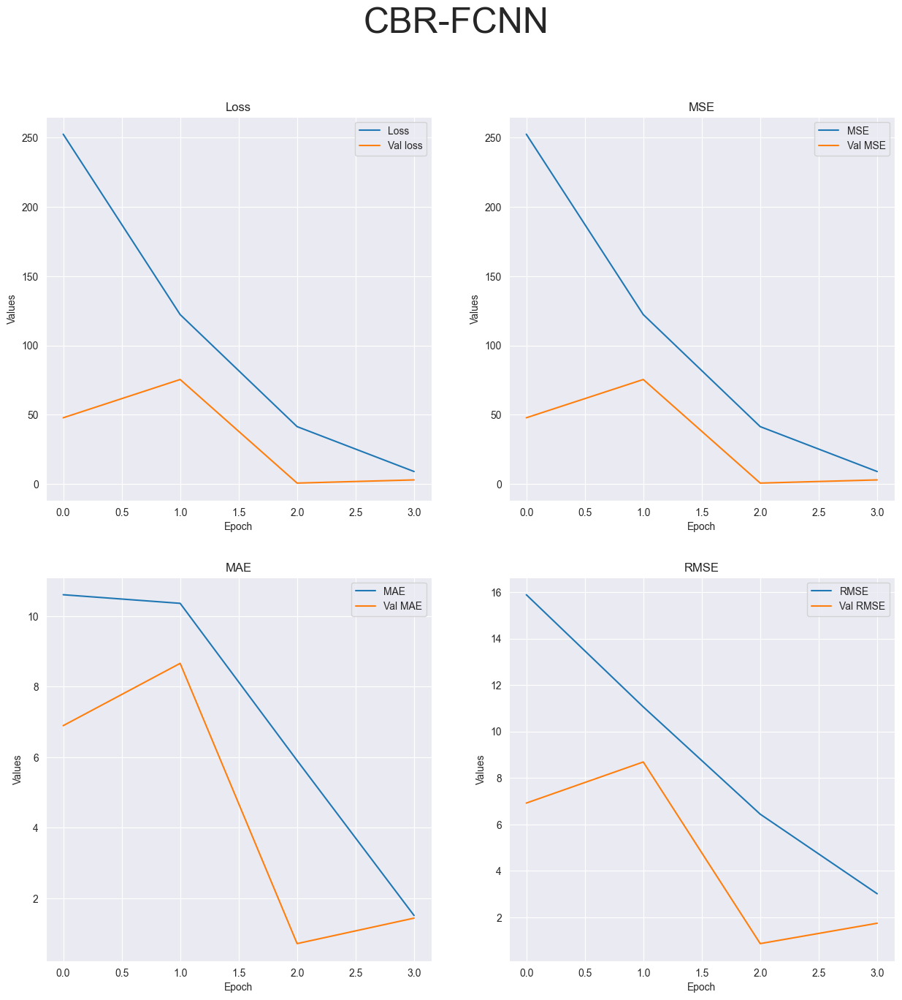

R-squared value: -2.6217


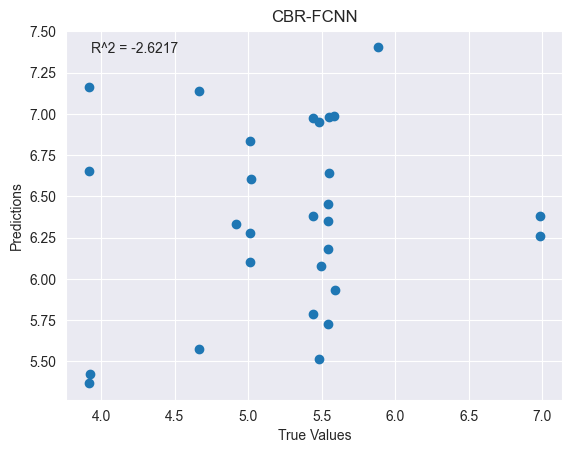

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_79"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_239 (Dense)           (None, 64)                256       
                                                                 
 dense_240 (Dense)           (None, 32)                2080      
                                                                 
 dense_241 (Dense)           (None, 16)                528       
                                                                 
 dense_242 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
____________________________________________________

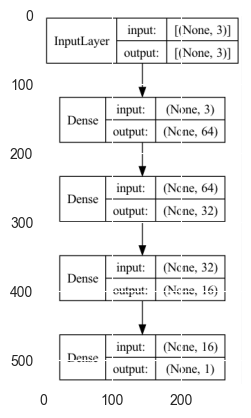

Epoch 1/10


2023-05-02 02:04:45.244572: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 164ms/step - loss: 152.6994 - mse: 152.6994 - mae: 9.9689 - root_mean_squared_error: 12.3572 - val_loss: 35.1262 - val_mse: 35.1262 - val_mae: 5.8482 - val_root_mean_squared_error: 5.9267
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 32.5568 - mse: 32.5568 - mae: 5.6524 - root_mean_squared_error: 5.7059

2023-05-02 02:04:45.755080: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 35ms/step - loss: 77.8590 - mse: 77.8590 - mae: 8.5107 - root_mean_squared_error: 8.8238 - val_loss: 55.9672 - val_mse: 55.9672 - val_mae: 7.2872 - val_root_mean_squared_error: 7.4811
Epoch 3/10
3/3 [==============================] - 0s 44ms/step - loss: 23.6194 - mse: 23.6194 - mae: 4.0752 - root_mean_squared_error: 4.8600 - val_loss: 28.0190 - val_mse: 28.0190 - val_mae: 2.6015 - val_root_mean_squared_error: 5.2933
Epoch 4/10
3/3 [==============================] - 0s 19ms/step - loss: 7.4338 - mse: 7.4338 - mae: 2.5055 - root_mean_squared_error: 2.7265 - val_loss: 34.6449 - val_mse: 34.6449 - val_mae: 2.9184 - val_root_mean_squared_error: 5.8860
Epoch 5/10
3/3 [==============================] - 0s 22ms/step - loss: 2.9789 - mse: 2.9789 - mae: 1.4718 - root_mean_squared_error: 1.7259 - val_loss: 8.0944 - val_mse: 8.0944 - val_mae: 2.2775 - val_root_mean_squared_error: 2.8451
Epoch 6/10
3/3 [==============================] - 0s 17ms/step - loss

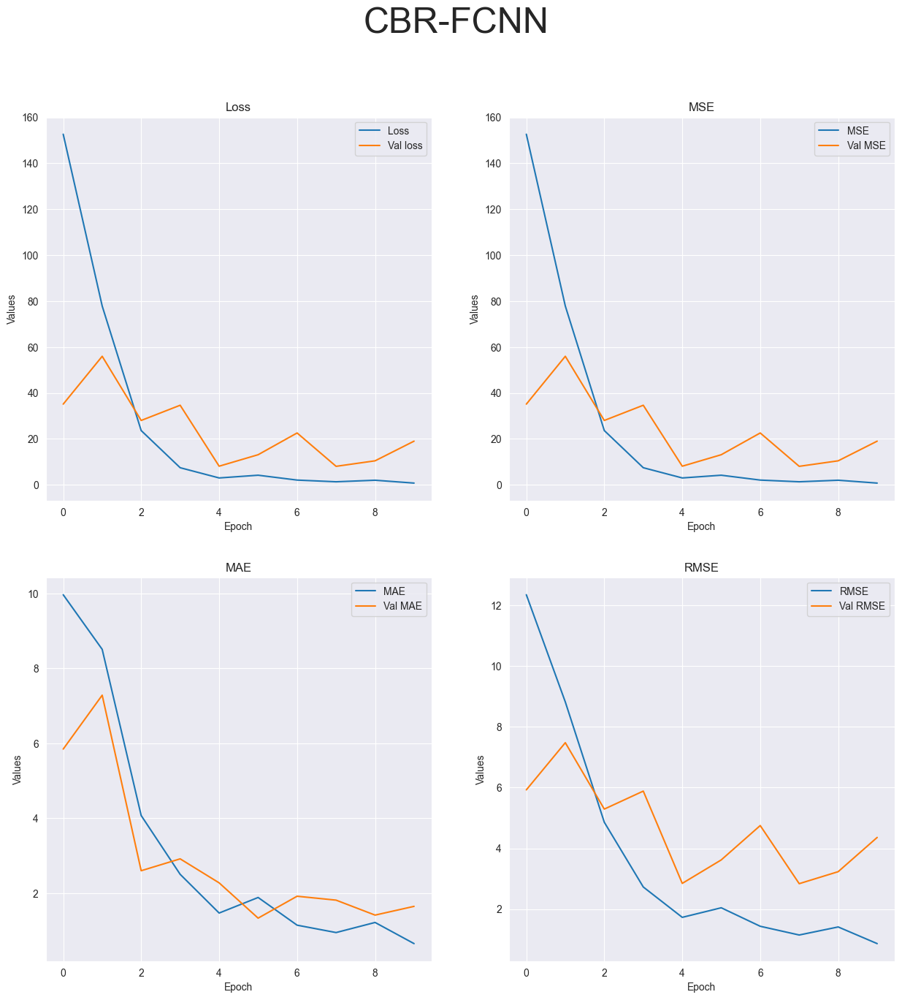

R-squared value: -6.1060


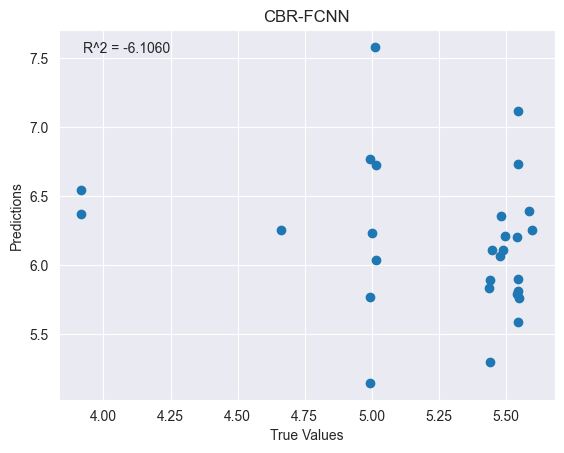

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_80"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_243 (Dense)           (None, 64)                256       
                                                                 
 dense_244 (Dense)           (None, 32)                2080      
                                                                 
 dense_245 (Dense)           (None, 16)                528       
                                                                 
 dense_246 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
____________________________________________________

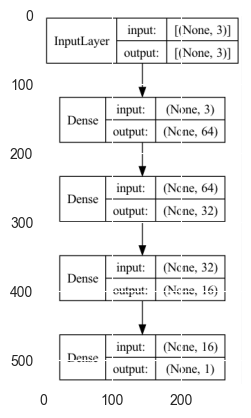

Epoch 1/20


2023-05-02 02:04:48.491364: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 163ms/step - loss: 140.7673 - mse: 140.7673 - mae: 9.8555 - root_mean_squared_error: 11.8645 - val_loss: 28.9376 - val_mse: 28.9376 - val_mae: 5.3455 - val_root_mean_squared_error: 5.3794
Epoch 2/20
3/3 [==============================] - 0s 26ms/step - loss: 78.5425 - mse: 78.5425 - mae: 8.3722 - root_mean_squared_error: 8.8624 - val_loss: 39.6236 - val_mse: 39.6236 - val_mae: 6.2629 - val_root_mean_squared_error: 6.2947
Epoch 3/20


2023-05-02 02:04:49.147524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 54ms/step - loss: 17.6477 - mse: 17.6477 - mae: 3.4718 - root_mean_squared_error: 4.2009 - val_loss: 12.8443 - val_mse: 12.8443 - val_mae: 3.4569 - val_root_mean_squared_error: 3.5839
Epoch 4/20
3/3 [==============================] - 0s 34ms/step - loss: 24.8407 - mse: 24.8407 - mae: 3.7718 - root_mean_squared_error: 4.9840 - val_loss: 12.7607 - val_mse: 12.7607 - val_mae: 3.4444 - val_root_mean_squared_error: 3.5722
Epoch 5/20
3/3 [==============================] - 0s 20ms/step - loss: 12.2977 - mse: 12.2977 - mae: 2.2692 - root_mean_squared_error: 3.5068 - val_loss: 0.5100 - val_mse: 0.5100 - val_mae: 0.5897 - val_root_mean_squared_error: 0.7142
Epoch 6/20
3/3 [==============================] - 0s 19ms/step - loss: 4.9730 - mse: 4.9730 - mae: 1.5103 - root_mean_squared_error: 2.2300 - val_loss: 6.5106 - val_mse: 6.5106 - val_mae: 2.4777 - val_root_mean_squared_error: 2.5516
Epoch 7/20
3/3 [==============================] - 0s 21ms/step - loss

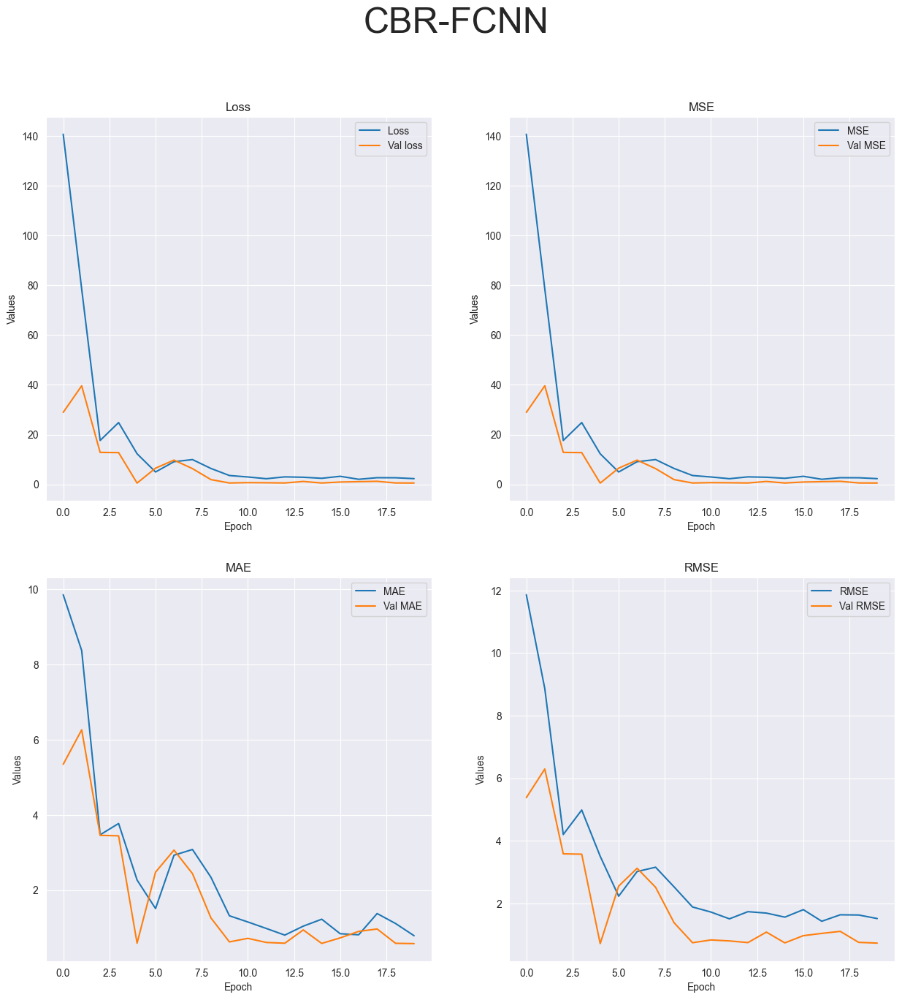

R-squared value: -0.6224


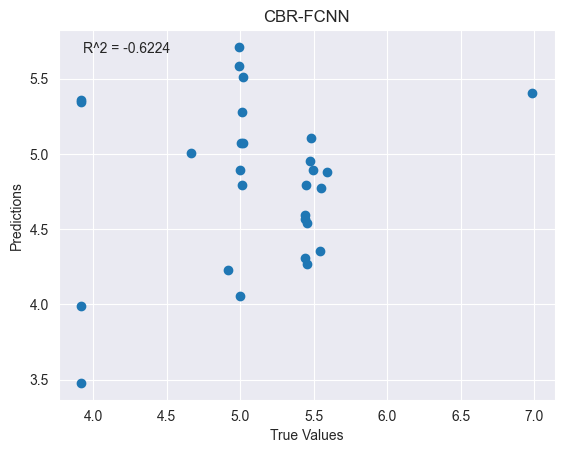

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_81"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_247 (Dense)           (None, 128)               512       
                                                                 
 dense_248 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


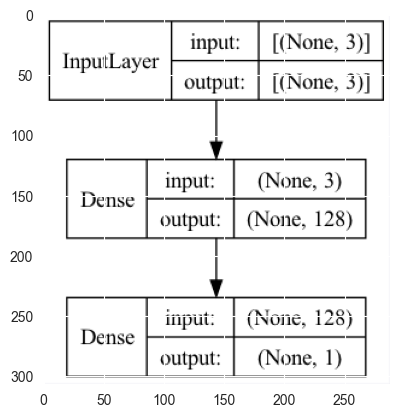

2023-05-02 02:04:51.724201: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 174ms/step - loss: 3875.0144 - mse: 3874.9585 - mae: 55.4921 - root_mean_squared_error: 62.2492 - val_loss: 28.3174 - val_mse: 28.2636 - val_mae: 4.6922 - val_root_mean_squared_error: 5.3164


2023-05-02 02:04:52.246703: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 62ms/step - loss: 22.2829 - mse: 22.2291 - mae: 4.0695 - root_mean_squared_error: 4.7148
Test loss: [22.282949447631836, 22.229127883911133, 4.069454193115234, 4.71477746963501]
['loss', 'mse', 'mae', 'root_mean_squared_error']


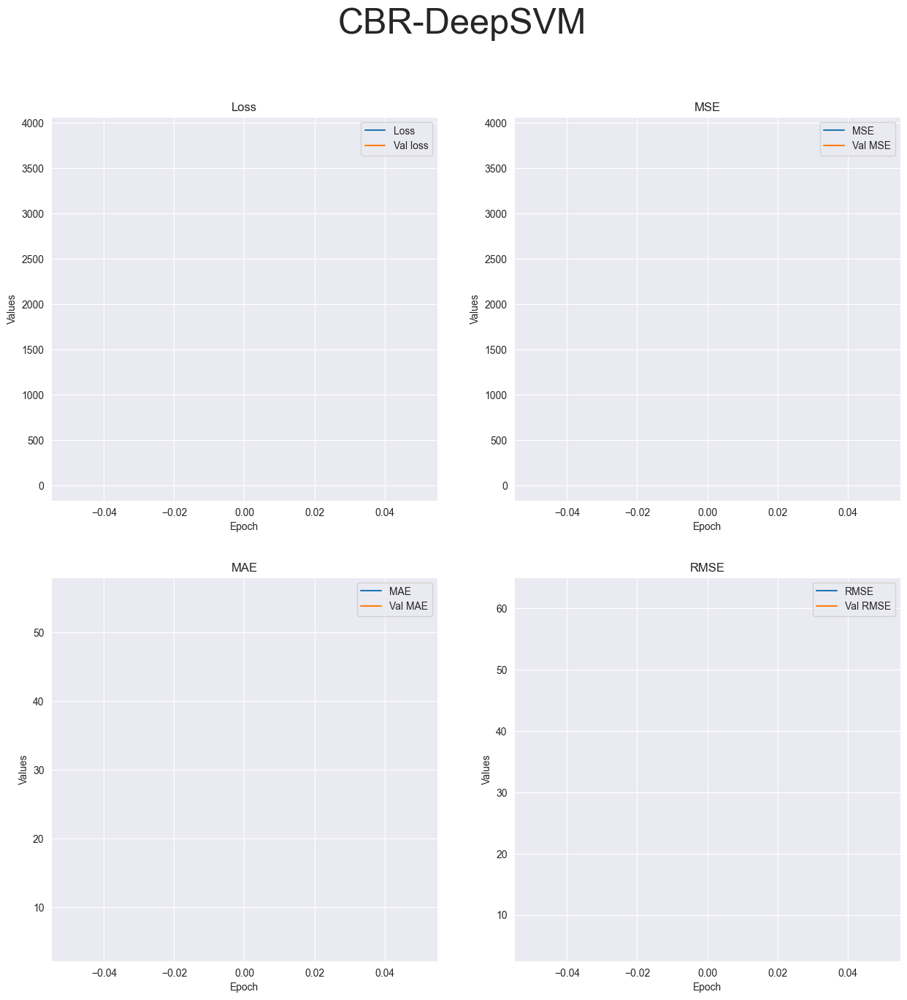

R-squared value: -61.3931


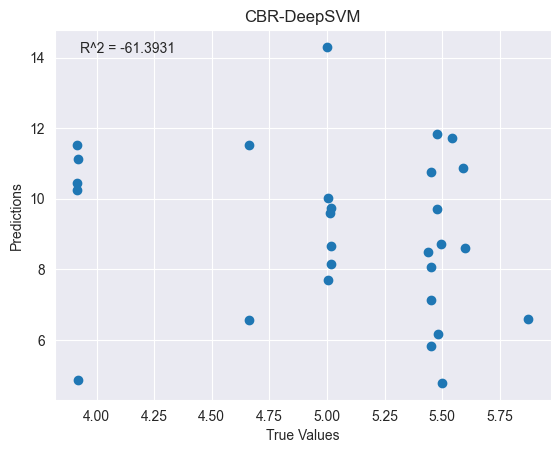

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_82"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_249 (Dense)           (None, 128)               512       
                                                                 
 dense_250 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


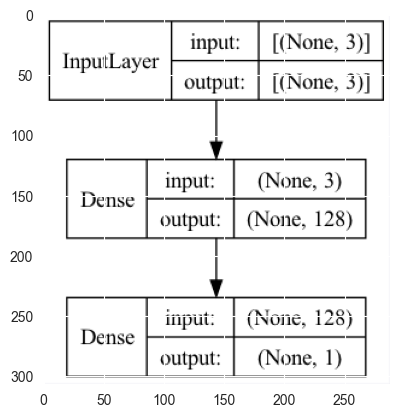

Epoch 1/4


2023-05-02 02:04:53.910642: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 198ms/step - loss: 3470.3342 - mse: 3470.2788 - mae: 54.5748 - root_mean_squared_error: 58.9091 - val_loss: 27.7542 - val_mse: 27.7003 - val_mae: 4.5802 - val_root_mean_squared_error: 5.2631
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 34.7012 - mse: 34.6473 - mae: 5.0265 - root_mean_squared_error: 5.8862

2023-05-02 02:04:54.536072: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 33ms/step - loss: 292.4812 - mse: 292.4269 - mae: 14.4530 - root_mean_squared_error: 17.1005 - val_loss: 1093.1348 - val_mse: 1093.0802 - val_mae: 32.8916 - val_root_mean_squared_error: 33.0618
Epoch 3/4
3/3 [==============================] - 0s 46ms/step - loss: 1111.1985 - mse: 1111.1444 - mae: 33.2453 - root_mean_squared_error: 33.3338 - val_loss: 685.8392 - val_mse: 685.7865 - val_mae: 26.0635 - val_root_mean_squared_error: 26.1875
Epoch 4/4
1/1 [==============================] - 0s 62ms/step - loss: 51.8546 - mse: 51.8039 - mae: 6.3571 - root_mean_squared_error: 7.1975
Test loss: [51.85462188720703, 51.80385971069336, 6.357132911682129, 7.1974897384643555]
['loss', 'mse', 'mae', 'root_mean_squared_error']


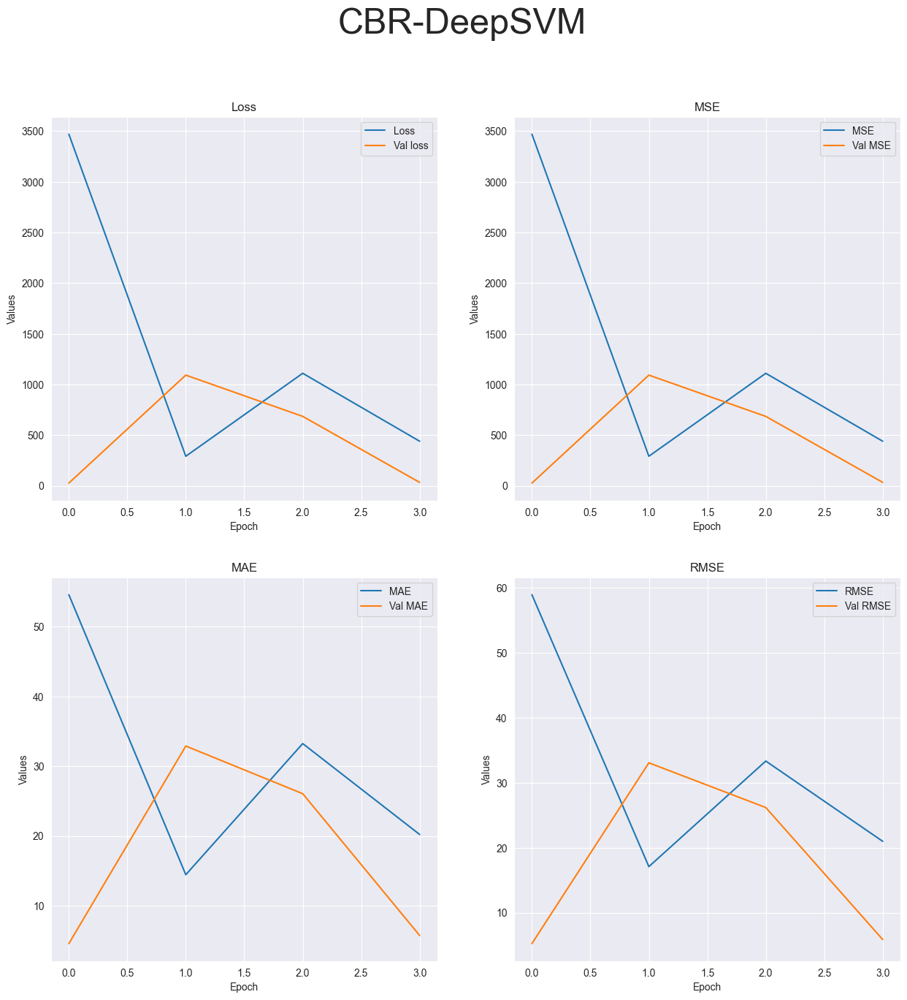

R-squared value: -99.4342


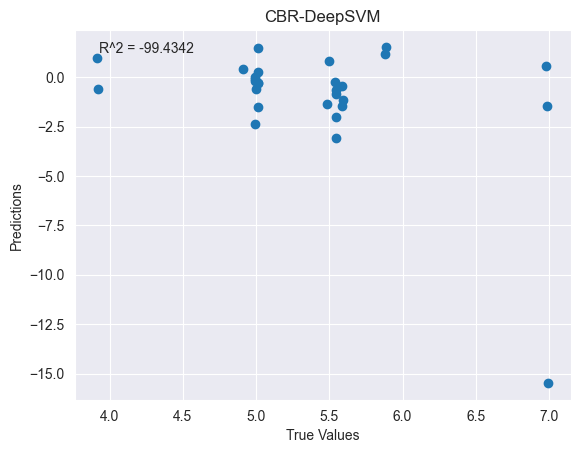

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_83"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_251 (Dense)           (None, 128)               512       
                                                                 
 dense_252 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


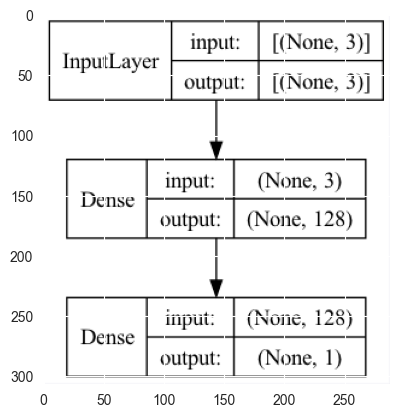

Epoch 1/10


2023-05-02 02:04:56.426549: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 217ms/step - loss: 3453.9199 - mse: 3453.8645 - mae: 54.4424 - root_mean_squared_error: 58.7696 - val_loss: 44.3491 - val_mse: 44.2952 - val_mae: 5.2656 - val_root_mean_squared_error: 6.6555
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 33.9135 - mse: 33.8596 - mae: 4.8598 - root_mean_squared_error: 5.8189

2023-05-02 02:04:57.081716: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 38ms/step - loss: 287.9579 - mse: 287.9037 - mae: 14.2616 - root_mean_squared_error: 16.9677 - val_loss: 1995.5178 - val_mse: 1995.4633 - val_mae: 38.3445 - val_root_mean_squared_error: 44.6706
Epoch 3/10
3/3 [==============================] - 0s 48ms/step - loss: 1110.4843 - mse: 1110.4299 - mae: 33.2306 - root_mean_squared_error: 33.3231 - val_loss: 1249.9945 - val_mse: 1249.9418 - val_mae: 30.4719 - val_root_mean_squared_error: 35.3545
Epoch 4/10
3/3 [==============================] - 0s 29ms/step - loss: 443.6797 - mse: 443.6276 - mae: 20.3377 - root_mean_squared_error: 21.0625 - val_loss: 57.0785 - val_mse: 57.0278 - val_mae: 6.5596 - val_root_mean_squared_error: 7.5517
Epoch 5/10
3/3 [==============================] - 0s 20ms/step - loss: 29.1443 - mse: 29.0939 - mae: 4.5298 - root_mean_squared_error: 5.3939 - val_loss: 236.6834 - val_mse: 236.6335 - val_mae: 12.6118 - val_root_mean_squared_error: 15.3829
Epoch 6/10
3/3 [=================

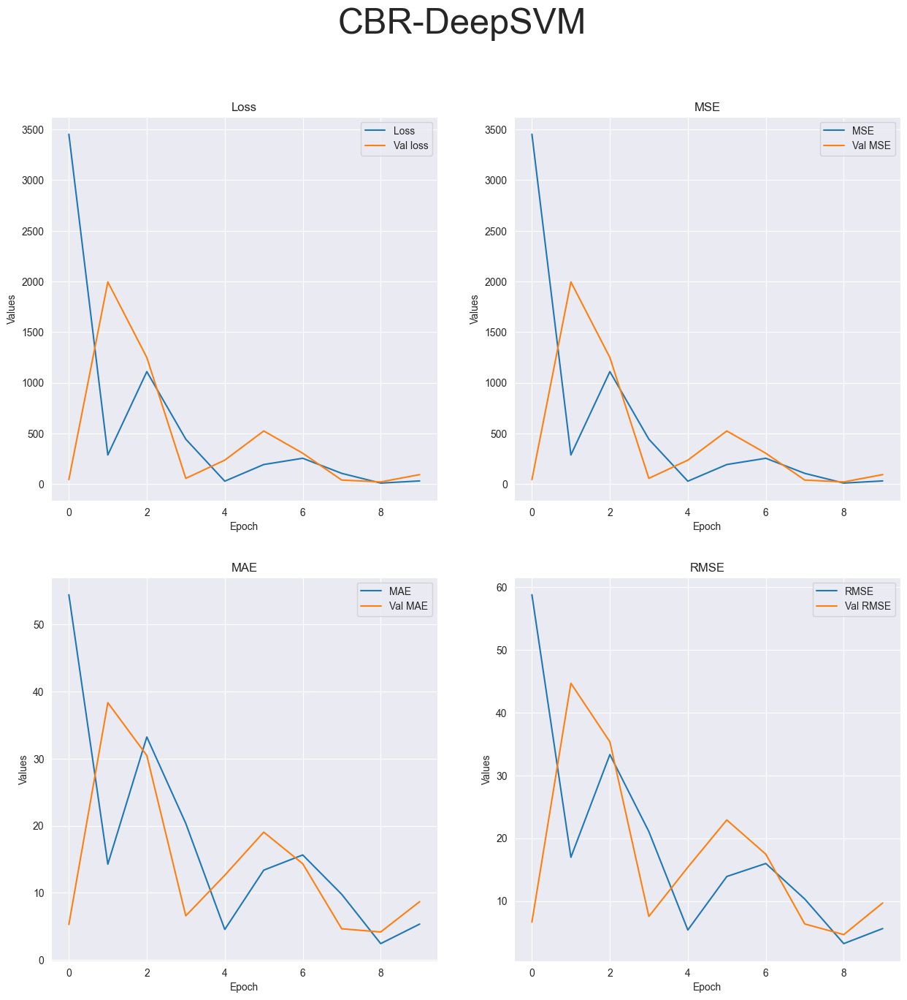

R-squared value: -102.7055


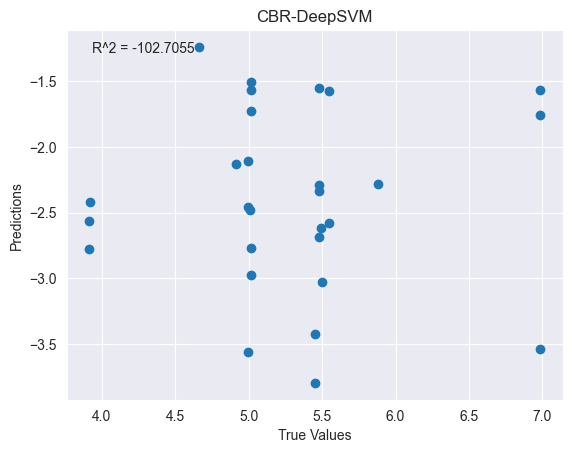

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_84"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_253 (Dense)           (None, 128)               512       
                                                                 
 dense_254 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


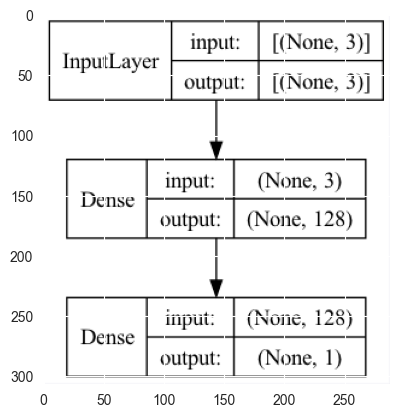

Epoch 1/20


2023-05-02 02:04:59.869099: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 165ms/step - loss: 3698.4409 - mse: 3698.3853 - mae: 56.2949 - root_mean_squared_error: 60.8144 - val_loss: 11.0699 - val_mse: 11.0160 - val_mae: 2.7638 - val_root_mean_squared_error: 3.3190
Epoch 2/20
3/3 [==============================] - ETA: 0s - loss: 517.4990 - mse: 517.4448 - mae: 16.3743 - root_mean_squared_error: 22.7474

2023-05-02 02:05:00.407544: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 45ms/step - loss: 517.4990 - mse: 517.4448 - mae: 16.3743 - root_mean_squared_error: 22.7474 - val_loss: 1156.0406 - val_mse: 1155.9862 - val_mae: 33.9369 - val_root_mean_squared_error: 33.9998
Epoch 3/20
3/3 [==============================] - 0s 62ms/step - loss: 1213.8911 - mse: 1213.8372 - mae: 32.4891 - root_mean_squared_error: 34.8402 - val_loss: 519.9707 - val_mse: 519.9184 - val_mae: 22.7597 - val_root_mean_squared_error: 22.8017
Epoch 4/20
3/3 [==============================] - 0s 34ms/step - loss: 313.4000 - mse: 313.3483 - mae: 16.6106 - root_mean_squared_error: 17.7016 - val_loss: 15.2219 - val_mse: 15.1712 - val_mae: 3.6400 - val_root_mean_squared_error: 3.8950
Epoch 5/20
3/3 [==============================] - 0s 24ms/step - loss: 47.2997 - mse: 47.2493 - mae: 4.8527 - root_mean_squared_error: 6.8738 - val_loss: 114.1541 - val_mse: 114.1040 - val_mae: 10.4372 - val_root_mean_squared_error: 10.6819
Epoch 6/20
3/3 [===================

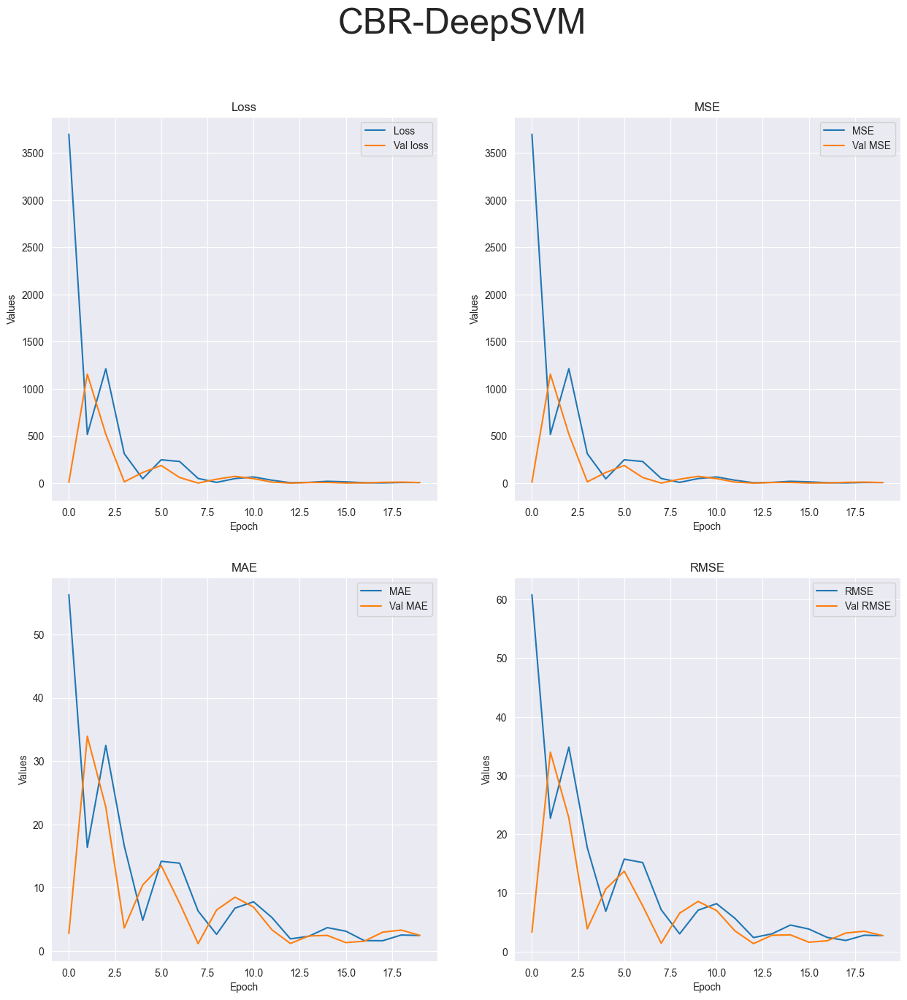

R-squared value: -11.1702


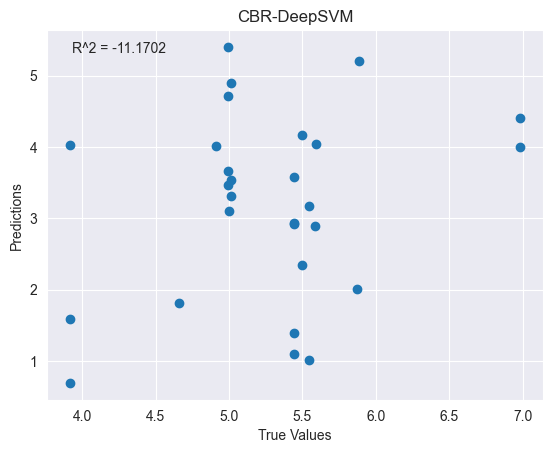

Running tests on ABR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_85"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_255 (Dense)           (None, 64)                832       
                                                                 
 dropout_58 (Dropout)        (None, 64)                0         
                             

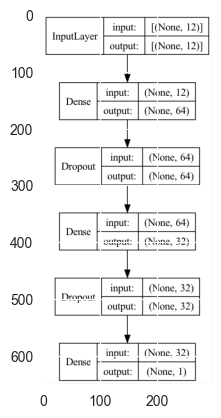

2023-05-02 02:05:02.999446: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 45ms/step - loss: 102810.7500 - mse: 102810.7500 - mae: 308.4424 - root_mean_squared_error: 320.6411


2023-05-02 02:05:03.606648: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [102810.75, 102810.75, 308.4423828125, 320.6411437988281]
['loss', 'mse', 'mae', 'root_mean_squared_error']


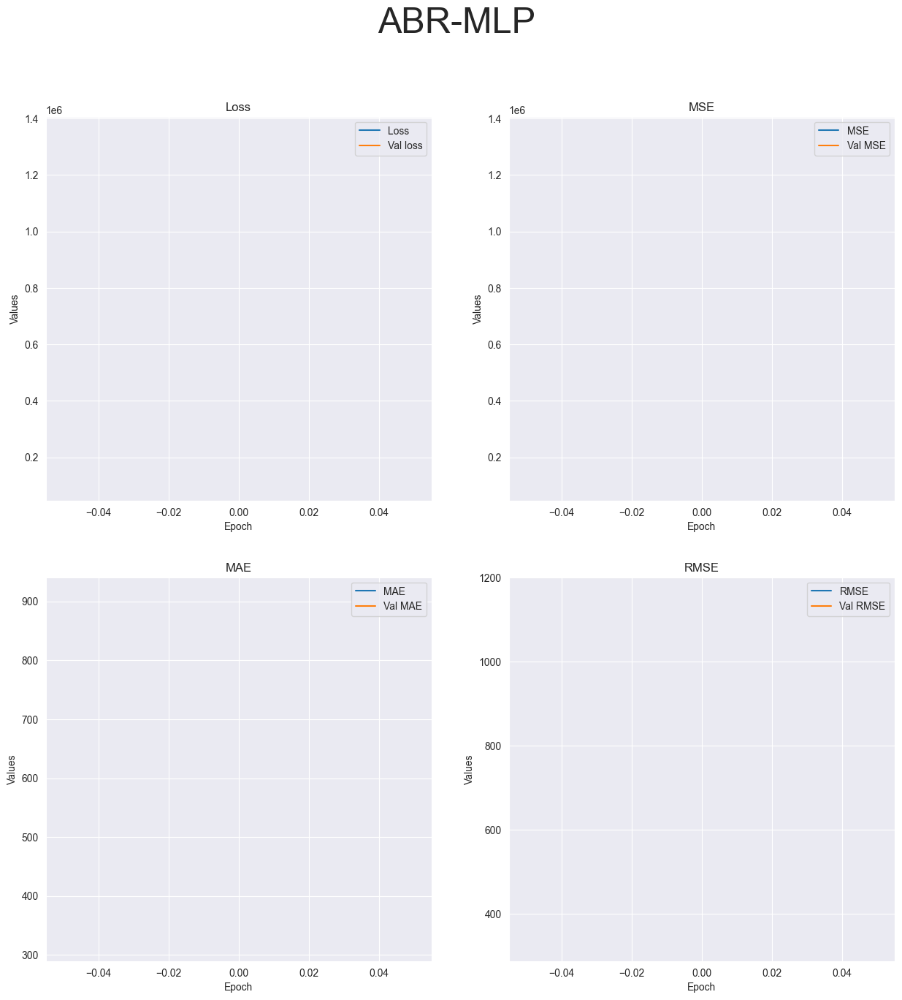

R-squared value: -180517.7263


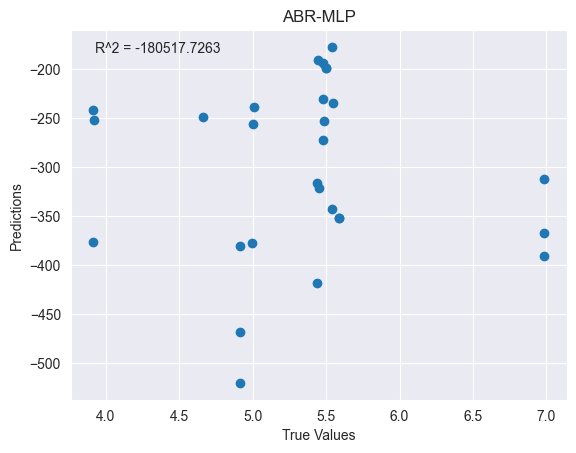

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_86"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_258 (Dense)           (None, 64)                832       
                                                                 
 dropout_60 (Dropout)        (None, 64)                0         
                                                                 
 dense_259 (Dense)        

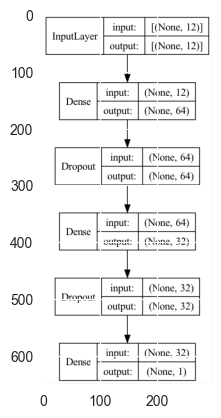

Epoch 1/4


2023-05-02 02:05:05.100513: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 207ms/step - loss: 2015960.7500 - mse: 2015960.7500 - mae: 1142.9503 - root_mean_squared_error: 1419.8453 - val_loss: 2968.9348 - val_mse: 2968.9348 - val_mae: 53.3059 - val_root_mean_squared_error: 54.4879
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 589211.1250 - mse: 589211.1250 - mae: 610.5135 - root_mean_squared_error: 767.6009

2023-05-02 02:05:05.749572: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 39ms/step - loss: 442101.2188 - mse: 442101.2188 - mae: 509.1446 - root_mean_squared_error: 664.9069 - val_loss: 70506.8047 - val_mse: 70506.8047 - val_mae: 258.9580 - val_root_mean_squared_error: 265.5312
Epoch 3/4
3/3 [==============================] - 0s 49ms/step - loss: 236807.6406 - mse: 236807.6406 - mae: 369.5032 - root_mean_squared_error: 486.6288 - val_loss: 5470.3320 - val_mse: 5470.3320 - val_mae: 71.8105 - val_root_mean_squared_error: 73.9617
Epoch 4/4
1/1 [==============================] - 0s 56ms/step - loss: 19898.1836 - mse: 19898.1836 - mae: 136.1267 - root_mean_squared_error: 141.0609
Test loss: [19898.18359375, 19898.18359375, 136.12672424316406, 141.06092834472656]
['loss', 'mse', 'mae', 'root_mean_squared_error']


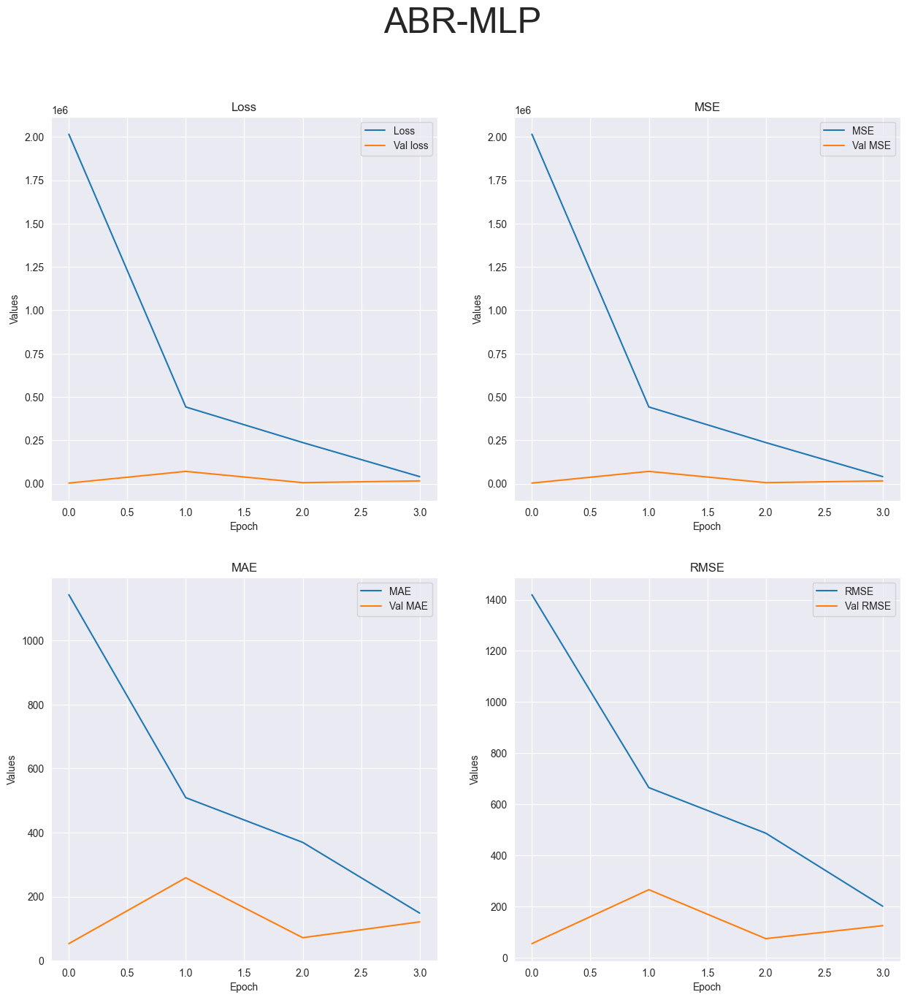

R-squared value: -33299.8030


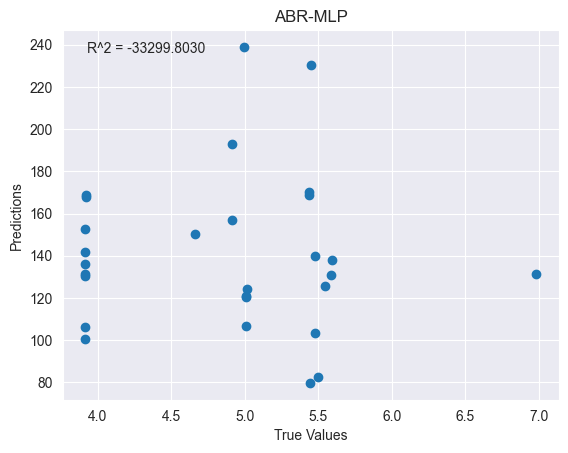

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_87"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_261 (Dense)           (None, 64)                832       
                                                                 
 dropout_62 (Dropout)        (None, 64)                0         
                                                                 
 dense_262 (Dense)       

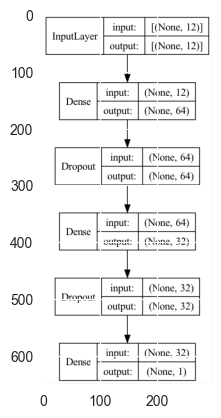

Epoch 1/10


2023-05-02 02:05:07.691264: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 248ms/step - loss: 1463678.3750 - mse: 1463678.3750 - mae: 908.3332 - root_mean_squared_error: 1209.8258 - val_loss: 805942.8125 - val_mse: 805942.8125 - val_mae: 869.2146 - val_root_mean_squared_error: 897.7432
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 936300.7500 - mse: 936300.7500 - mae: 799.4069 - root_mean_squared_error: 967.6263

2023-05-02 02:05:08.455058: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 46ms/step - loss: 682614.4375 - mse: 682614.4375 - mae: 675.5753 - root_mean_squared_error: 826.2048 - val_loss: 14388.8604 - val_mse: 14388.8604 - val_mae: 116.0791 - val_root_mean_squared_error: 119.9536
Epoch 3/10
3/3 [==============================] - 0s 41ms/step - loss: 149194.7969 - mse: 149194.7969 - mae: 325.1599 - root_mean_squared_error: 386.2574 - val_loss: 164792.5156 - val_mse: 164792.5156 - val_mae: 392.8112 - val_root_mean_squared_error: 405.9464
Epoch 4/10
3/3 [==============================] - 0s 39ms/step - loss: 166359.0625 - mse: 166359.0625 - mae: 340.8320 - root_mean_squared_error: 407.8714 - val_loss: 54197.1094 - val_mse: 54197.1094 - val_mae: 224.9735 - val_root_mean_squared_error: 232.8027
Epoch 5/10
3/3 [==============================] - 0s 27ms/step - loss: 60296.6641 - mse: 60296.6641 - mae: 195.9217 - root_mean_squared_error: 245.5538 - val_loss: 11199.8164 - val_mse: 11199.8164 - val_mae: 102.0891 - val_root_mean

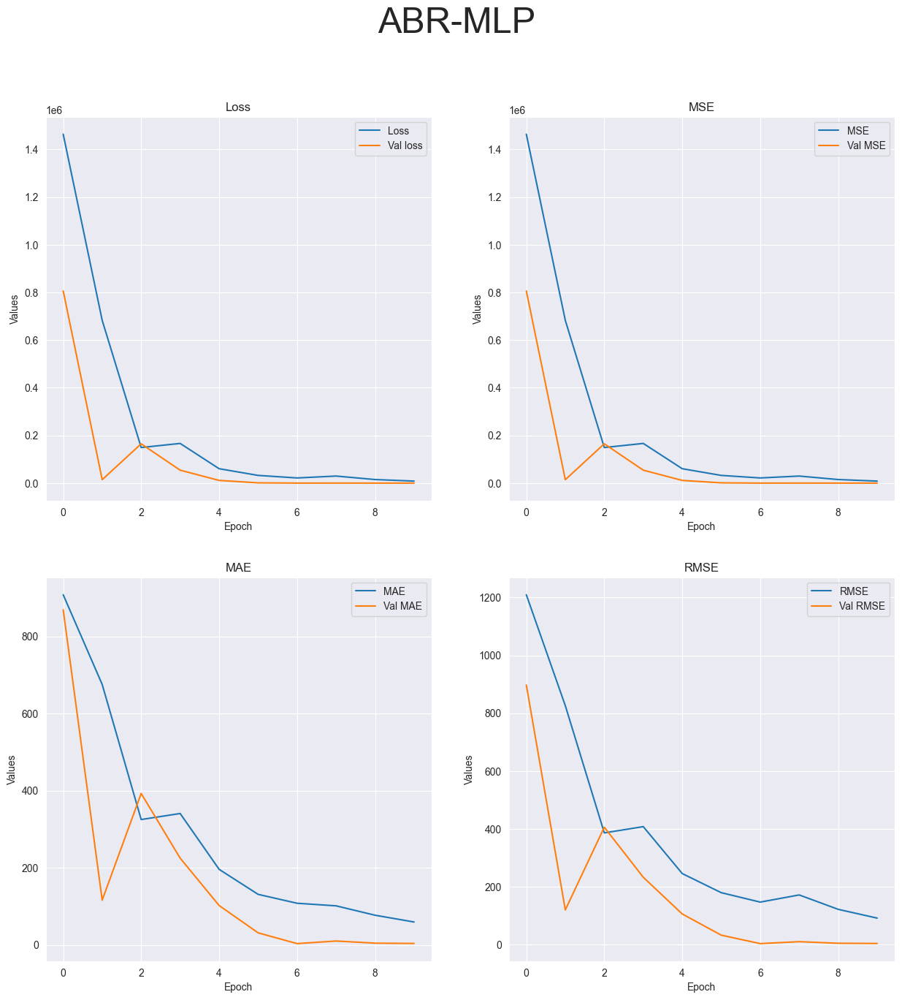

R-squared value: -41.8530


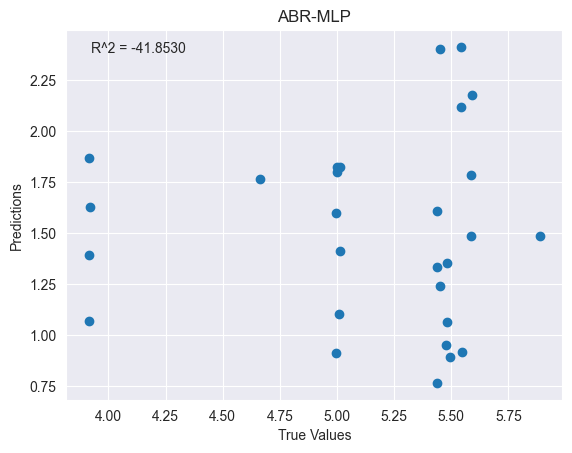

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_88"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_264 (Dense)           (None, 64)                832       
                                                                 
 dropout_64 (Dropout)        (None, 64)                0         
                                                                 
 dense_265 (Dense)       

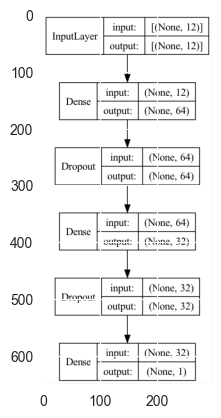

Epoch 1/20


2023-05-02 02:05:11.833606: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 231ms/step - loss: 2627191.7500 - mse: 2627191.7500 - mae: 1246.3931 - root_mean_squared_error: 1620.8615 - val_loss: 81539.9766 - val_mse: 81539.9766 - val_mae: 271.9901 - val_root_mean_squared_error: 285.5521
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 377323.7500 - mse: 377323.7500 - mae: 492.6178 - root_mean_squared_error: 614.2668

2023-05-02 02:05:12.635189: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 58ms/step - loss: 446536.6250 - mse: 446536.6250 - mae: 514.7441 - root_mean_squared_error: 668.2339 - val_loss: 109390.1328 - val_mse: 109390.1328 - val_mae: 314.5762 - val_root_mean_squared_error: 330.7418
Epoch 3/20
3/3 [==============================] - 0s 26ms/step - loss: 249588.3594 - mse: 249588.3594 - mae: 396.4016 - root_mean_squared_error: 499.5882 - val_loss: 6250.4717 - val_mse: 6250.4717 - val_mae: 74.5658 - val_root_mean_squared_error: 79.0599
Epoch 4/20
3/3 [==============================] - 0s 54ms/step - loss: 49905.2148 - mse: 49905.2188 - mae: 171.1884 - root_mean_squared_error: 223.3948 - val_loss: 14786.7461 - val_mse: 14786.7461 - val_mae: 114.9707 - val_root_mean_squared_error: 121.6008
Epoch 5/20
3/3 [==============================] - 0s 23ms/step - loss: 21835.6660 - mse: 21835.6660 - mae: 121.5032 - root_mean_squared_error: 147.7690 - val_loss: 17538.7852 - val_mse: 17538.7852 - val_mae: 125.2695 - val_root_mean_squar

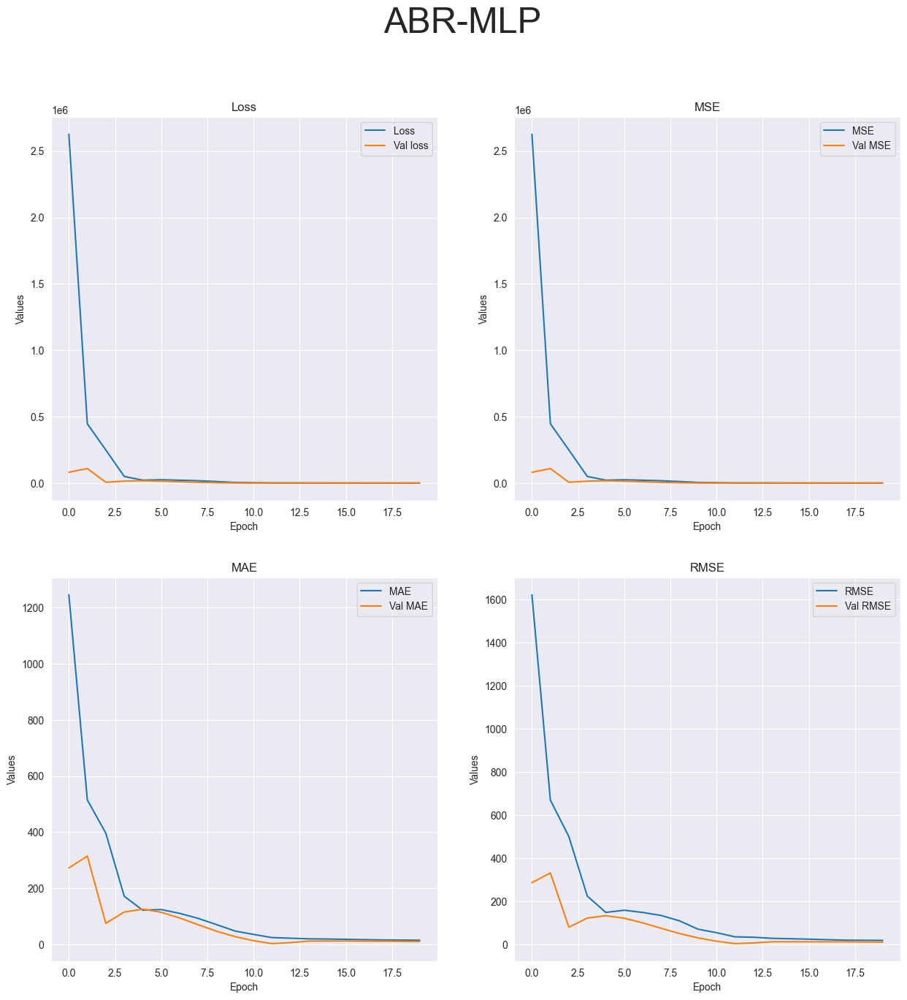

R-squared value: -205.3381


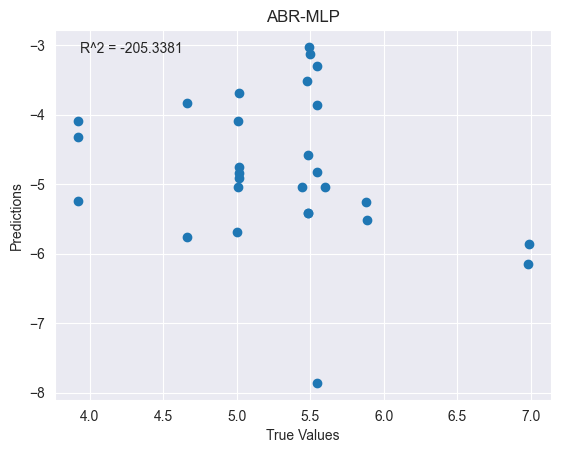

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_89"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_267 (Dense)           (None, 64)                832       
                                                                 
 dense_268 (Dense)           (None, 32)                2080      
                                                                

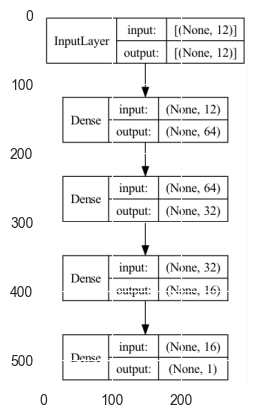

2023-05-02 02:05:15.632027: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - ETA: 0s - loss: 208739.5156 - mse: 208739.5156 - mae: 434.0688 - root_mean_squared_error: 456.8802

2023-05-02 02:05:16.222827: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 53ms/step - loss: 208739.5156 - mse: 208739.5156 - mae: 434.0688 - root_mean_squared_error: 456.8802
Test loss: [208739.515625, 208739.515625, 434.06884765625, 456.88018798828125]
['loss', 'mse', 'mae', 'root_mean_squared_error']


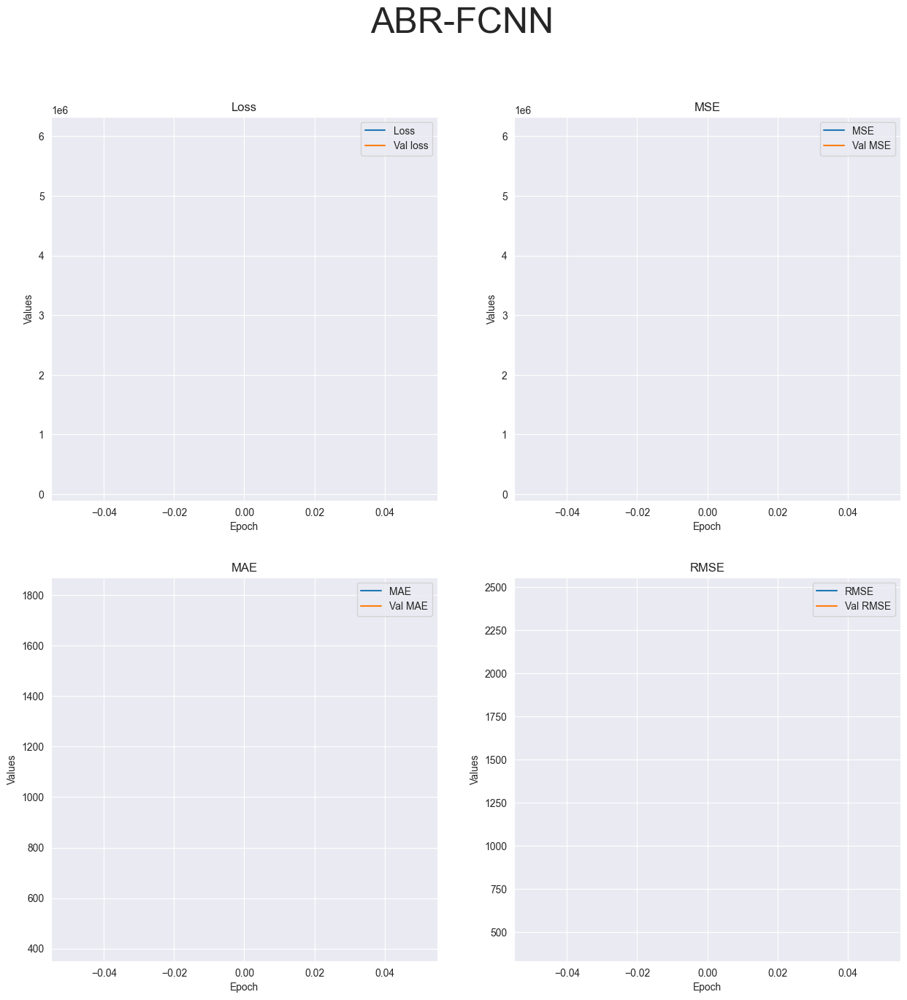

R-squared value: -491244.5054


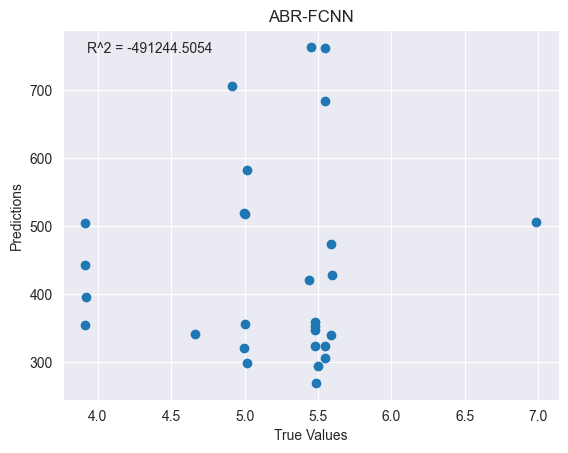

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_90"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_271 (Dense)           (None, 64)                832       
                                                                 
 dense_272 (Dense)           (None, 32)                2080      
                                                                 
 dense_273 (Dense)        

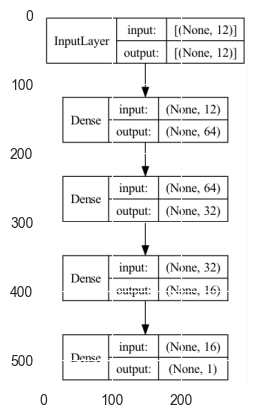

Epoch 1/4


2023-05-02 02:05:17.731157: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 184ms/step - loss: 4958484.5000 - mse: 4958484.5000 - mae: 1689.2443 - root_mean_squared_error: 2226.7654 - val_loss: 229283.2812 - val_mse: 229283.2812 - val_mae: 461.4793 - val_root_mean_squared_error: 478.8353
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 212441.5938 - mse: 212441.5938 - mae: 443.4957 - root_mean_squared_error: 460.9139

2023-05-02 02:05:18.298981: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 32ms/step - loss: 1382017.1250 - mse: 1382017.1250 - mae: 1027.0918 - root_mean_squared_error: 1175.5923 - val_loss: 2165759.2500 - val_mse: 2165759.2500 - val_mae: 1418.5591 - val_root_mean_squared_error: 1471.6519
Epoch 3/4
3/3 [==============================] - 0s 78ms/step - loss: 1136890.1250 - mse: 1136890.1250 - mae: 952.2368 - root_mean_squared_error: 1066.2505 - val_loss: 3094.5989 - val_mse: 3094.5989 - val_mae: 52.9597 - val_root_mean_squared_error: 55.6291
Epoch 4/4
1/1 [==============================] - 0s 88ms/step - loss: 449831.0000 - mse: 449831.0000 - mae: 652.2523 - root_mean_squared_error: 670.6944
Test loss: [449831.0, 449831.0, 652.2523193359375, 670.6943969726562]
['loss', 'mse', 'mae', 'root_mean_squared_error']


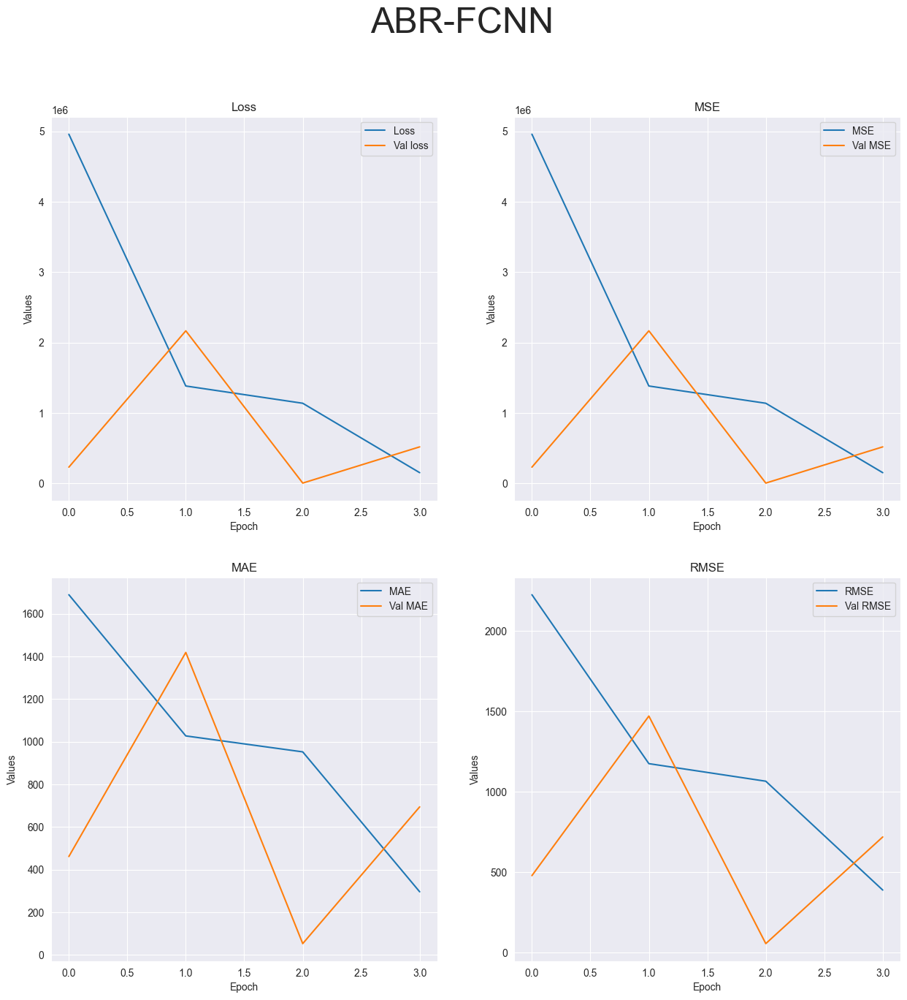

R-squared value: -1185136.1511


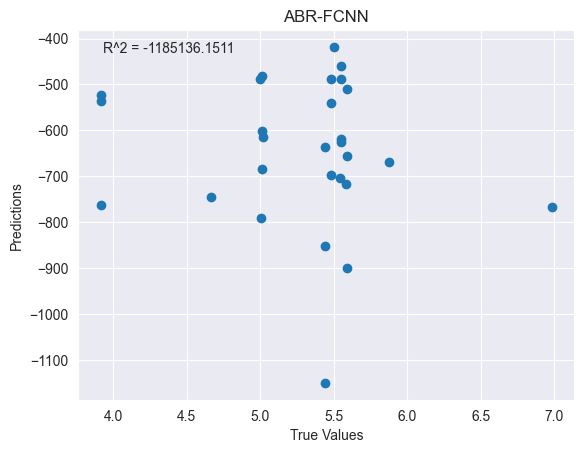

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_91"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_275 (Dense)           (None, 64)                832       
                                                                 
 dense_276 (Dense)           (None, 32)                2080      
                                                                 
 dense_277 (Dense)       

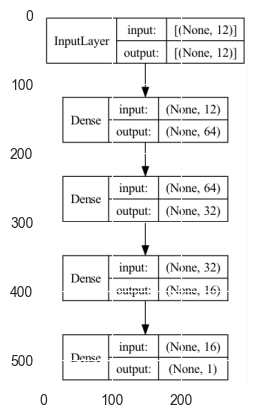

Epoch 1/10


2023-05-02 02:05:20.361756: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 225ms/step - loss: 5683874.5000 - mse: 5683874.5000 - mae: 1765.0155 - root_mean_squared_error: 2384.0879 - val_loss: 174232.8594 - val_mse: 174232.8594 - val_mae: 399.6036 - val_root_mean_squared_error: 417.4121
Epoch 2/10


2023-05-02 02:05:20.941047: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 72ms/step - loss: 1319676.3750 - mse: 1319676.3750 - mae: 1008.1998 - root_mean_squared_error: 1148.7717 - val_loss: 2013789.8750 - val_mse: 2013789.8750 - val_mae: 1359.5405 - val_root_mean_squared_error: 1419.0807
Epoch 3/10
3/3 [==============================] - 0s 36ms/step - loss: 1178806.2500 - mse: 1178806.2500 - mae: 965.6382 - root_mean_squared_error: 1085.7284 - val_loss: 183.5127 - val_mse: 183.5127 - val_mae: 11.8127 - val_root_mean_squared_error: 13.5467
Epoch 4/10
3/3 [==============================] - 0s 26ms/step - loss: 188107.7812 - mse: 188107.7812 - mae: 323.5575 - root_mean_squared_error: 433.7139 - val_loss: 575723.8125 - val_mse: 575723.8125 - val_mae: 728.0990 - val_root_mean_squared_error: 758.7646
Epoch 5/10
3/3 [==============================] - 0s 24ms/step - loss: 479714.2812 - mse: 479714.2812 - mae: 662.2122 - root_mean_squared_error: 692.6141 - val_loss: 205182.1719 - val_mse: 205182.1719 - val_mae: 434.9200 - va

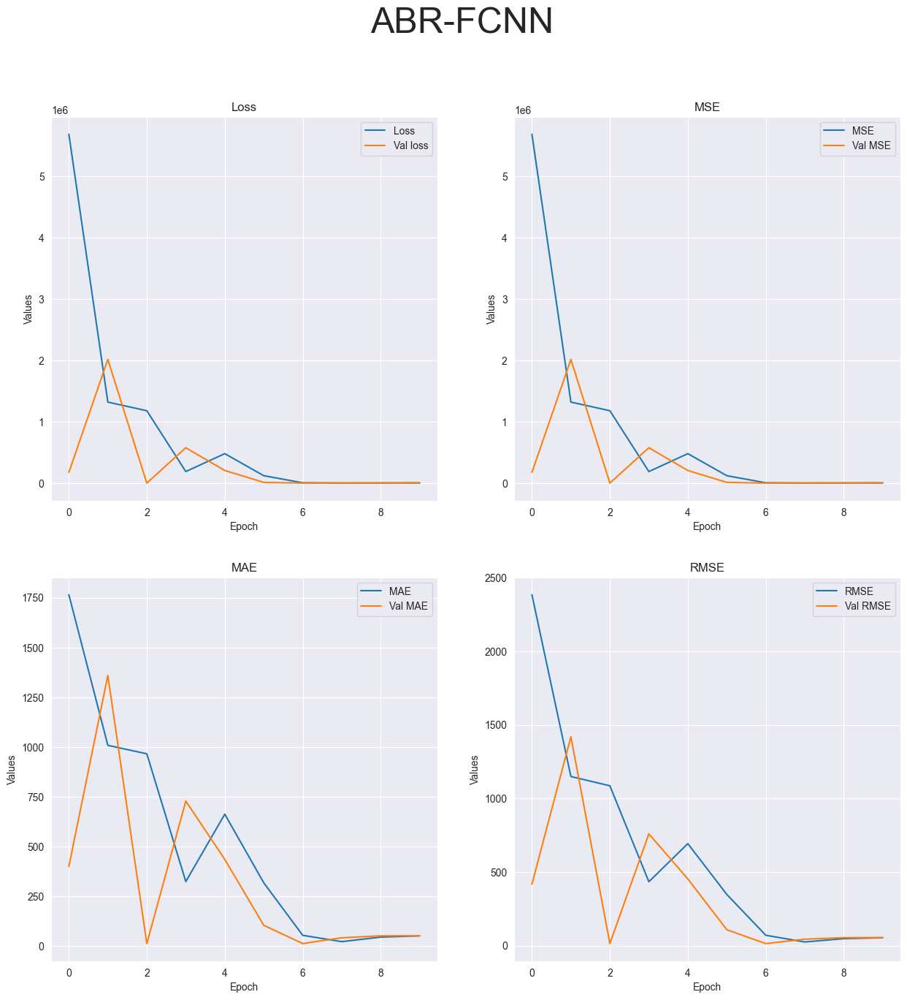

R-squared value: -4480.4222


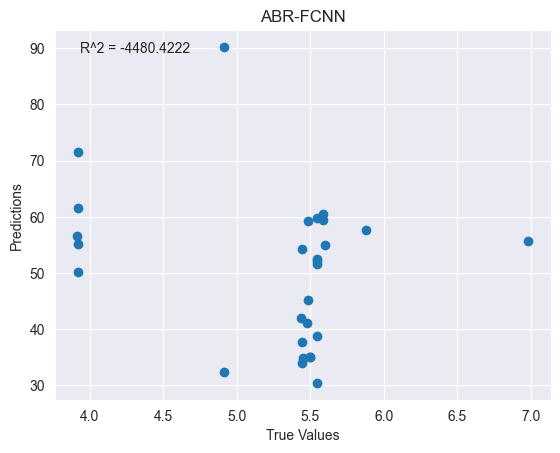

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_92"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_279 (Dense)           (None, 64)                832       
                                                                 
 dense_280 (Dense)           (None, 32)                2080      
                                                                 
 dense_281 (Dense)       

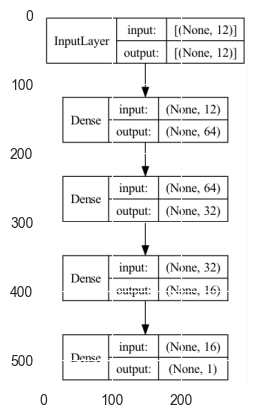

Epoch 1/20


2023-05-02 02:05:23.985977: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 231ms/step - loss: 6132293.0000 - mse: 6132293.0000 - mae: 1822.9740 - root_mean_squared_error: 2476.3467 - val_loss: 183998.2656 - val_mse: 183998.2656 - val_mae: 415.2896 - val_root_mean_squared_error: 428.9502
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 162192.8125 - mse: 162192.8125 - mae: 393.0190 - root_mean_squared_error: 402.7317

2023-05-02 02:05:24.767274: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 44ms/step - loss: 1622137.8750 - mse: 1622137.8750 - mae: 1091.6122 - root_mean_squared_error: 1273.6317 - val_loss: 2034748.8750 - val_mse: 2034748.8750 - val_mae: 1381.5250 - val_root_mean_squared_error: 1426.4463
Epoch 3/20
3/3 [==============================] - 0s 29ms/step - loss: 1196029.6250 - mse: 1196029.6250 - mae: 998.4368 - root_mean_squared_error: 1093.6313 - val_loss: 6460.9814 - val_mse: 6460.9814 - val_mae: 77.1629 - val_root_mean_squared_error: 80.3802
Epoch 4/20
3/3 [==============================] - 0s 31ms/step - loss: 167257.8906 - mse: 167257.8906 - mae: 324.1953 - root_mean_squared_error: 408.9717 - val_loss: 517906.3438 - val_mse: 517906.3438 - val_mae: 697.9416 - val_root_mean_squared_error: 719.6571
Epoch 5/20
3/3 [==============================] - 0s 39ms/step - loss: 468353.6250 - mse: 468353.6250 - mae: 654.8959 - root_mean_squared_error: 684.3636 - val_loss: 219083.7031 - val_mse: 219083.7031 - val_mae: 454.1410 - 

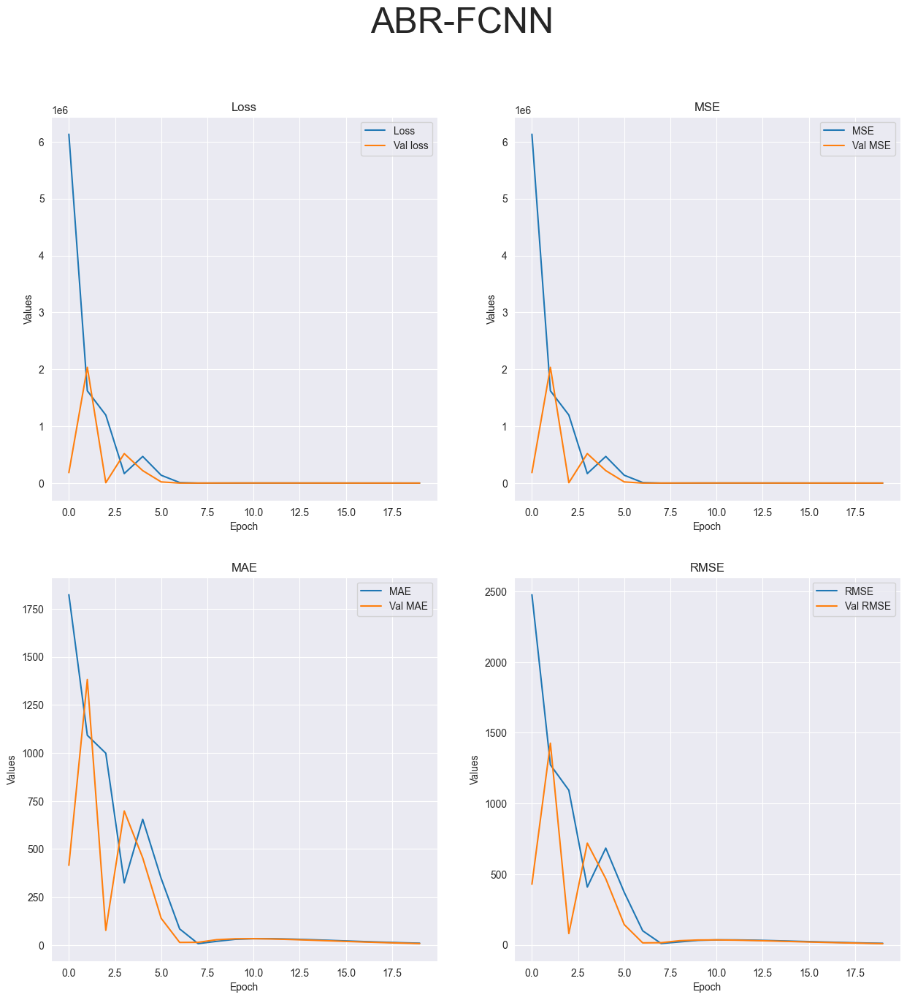

R-squared value: -157.0518


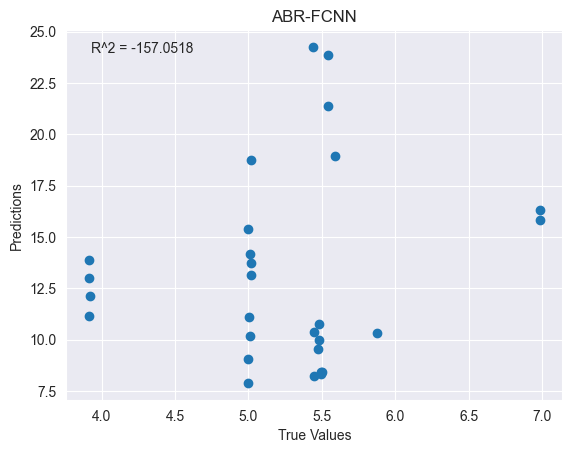

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_93"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_283 (Dense)           (None, 128)               1664      
                                                                 
 dense_284 (Dense)           (None, 1)                 129       
                                                             

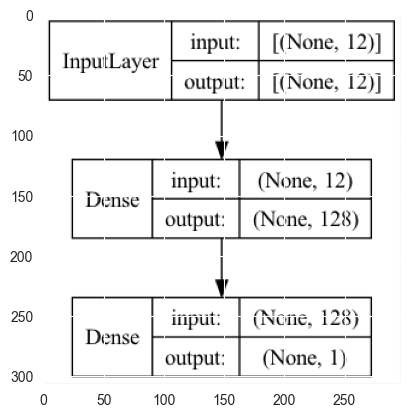

2023-05-02 02:05:27.557326: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 65ms/step - loss: 292395616.0000 - mse: 292395616.0000 - mae: 16621.9824 - root_mean_squared_error: 17099.5801


2023-05-02 02:05:28.094005: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Test loss: [292395616.0, 292395616.0, 16621.982421875, 17099.580078125]
['loss', 'mse', 'mae', 'root_mean_squared_error']


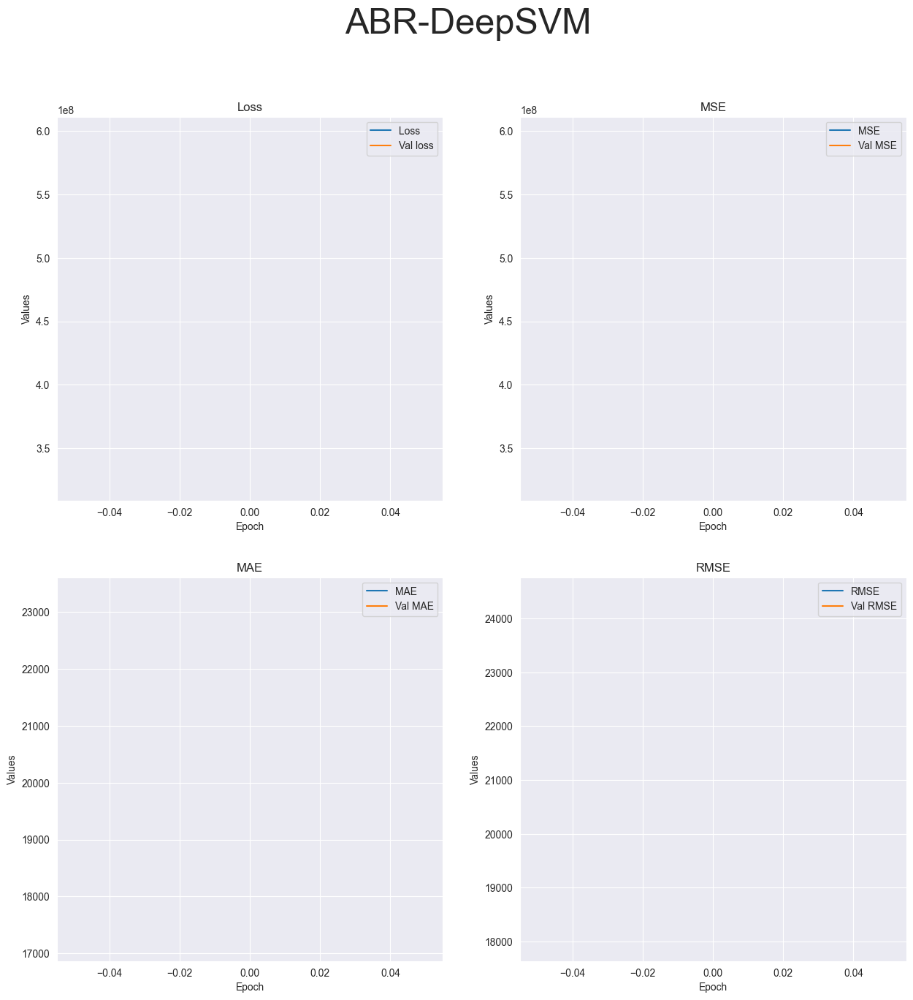

R-squared value: -435392905.0500


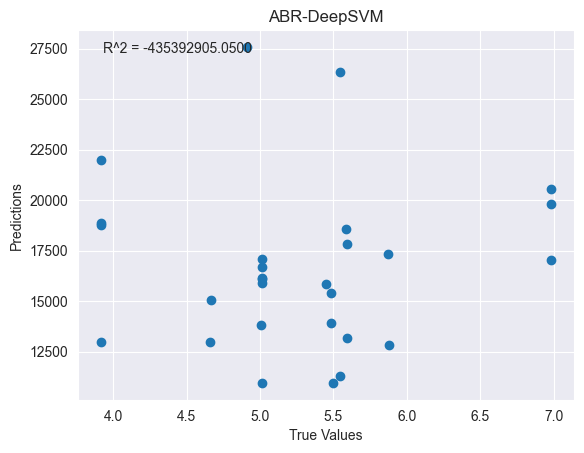

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_94"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_285 (Dense)           (None, 128)               1664      
                                                                 
 dense_286 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Traina

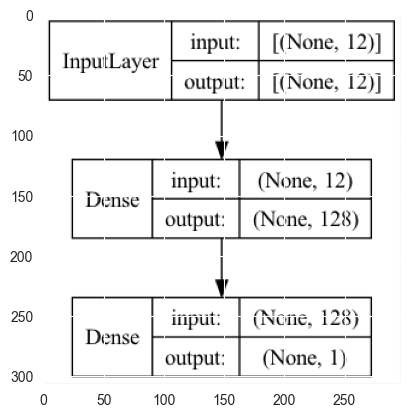

Epoch 1/4


2023-05-02 02:05:29.661780: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 157ms/step - loss: 615660992.0000 - mse: 615660992.0000 - mae: 23674.3281 - root_mean_squared_error: 24812.5176 - val_loss: 272648096.0000 - val_mse: 272648096.0000 - val_mae: 16092.8477 - val_root_mean_squared_error: 16512.0586
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 310520448.0000 - mse: 310520448.0000 - mae: 16817.8828 - root_mean_squared_error: 17621.5898

2023-05-02 02:05:30.172734: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 36ms/step - loss: 239873520.0000 - mse: 239873520.0000 - mae: 14781.0537 - root_mean_squared_error: 15487.8506 - val_loss: 102694064.0000 - val_mse: 102694064.0000 - val_mae: 9874.6670 - val_root_mean_squared_error: 10133.8076
Epoch 3/4
3/3 [==============================] - 0s 31ms/step - loss: 91779864.0000 - mse: 91779864.0000 - mae: 9087.6406 - root_mean_squared_error: 9580.1807 - val_loss: 37594948.0000 - val_mse: 37594948.0000 - val_mae: 5973.3032 - val_root_mean_squared_error: 6131.4722
Epoch 4/4
1/1 [==============================] - 0s 69ms/step - loss: 15529589.0000 - mse: 15529589.0000 - mae: 3725.1624 - root_mean_squared_error: 3940.7600
Test loss: [15529589.0, 15529589.0, 3725.162353515625, 3940.760009765625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


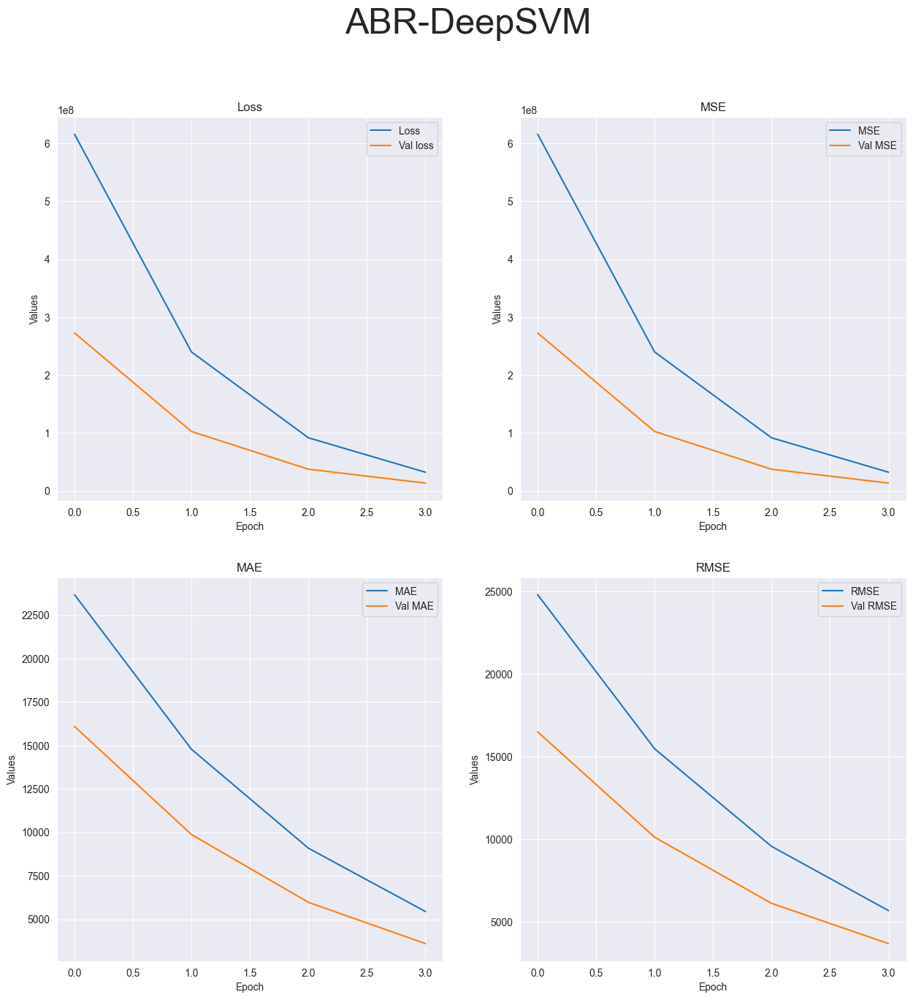

R-squared value: -32782904.5380


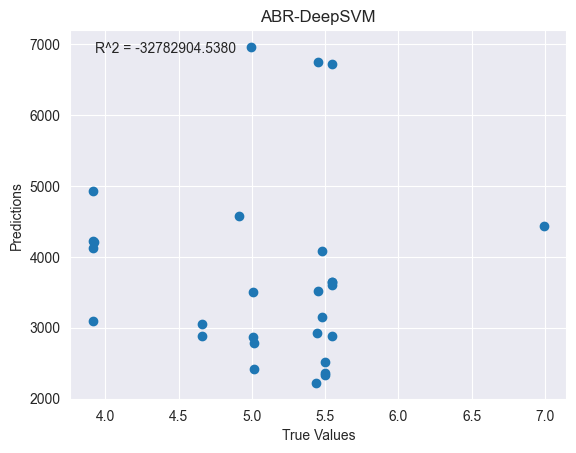

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_95"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_287 (Dense)           (None, 128)               1664      
                                                                 
 dense_288 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Train

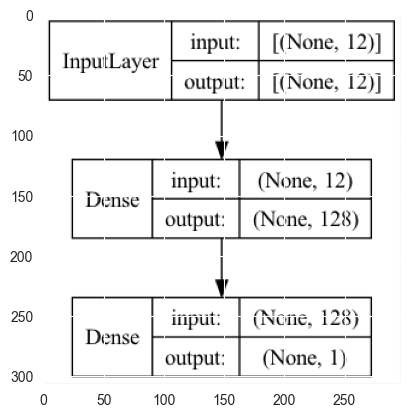

Epoch 1/10


2023-05-02 02:05:31.931955: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 167ms/step - loss: 652082944.0000 - mse: 652082944.0000 - mae: 24334.4551 - root_mean_squared_error: 25535.9141 - val_loss: 244674544.0000 - val_mse: 244674544.0000 - val_mae: 15162.9238 - val_root_mean_squared_error: 15642.0762
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 301474880.0000 - mse: 301474880.0000 - mae: 16685.9980 - root_mean_squared_error: 17363.0312

2023-05-02 02:05:32.458126: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 37ms/step - loss: 252905584.0000 - mse: 252905584.0000 - mae: 15192.1533 - root_mean_squared_error: 15903.0059 - val_loss: 91637072.0000 - val_mse: 91637072.0000 - val_mae: 9278.9590 - val_root_mean_squared_error: 9572.7256
Epoch 3/10
3/3 [==============================] - 0s 50ms/step - loss: 99096840.0000 - mse: 99096840.0000 - mae: 9357.5439 - root_mean_squared_error: 9954.7393 - val_loss: 33190706.0000 - val_mse: 33190706.0000 - val_mae: 5583.9077 - val_root_mean_squared_error: 5761.1377
Epoch 4/10
3/3 [==============================] - 0s 24ms/step - loss: 34756516.0000 - mse: 34756516.0000 - mae: 5591.7754 - root_mean_squared_error: 5895.4658 - val_loss: 11982200.0000 - val_mse: 11982200.0000 - val_mae: 3354.6895 - val_root_mean_squared_error: 3461.5315
Epoch 5/10
3/3 [==============================] - 0s 20ms/step - loss: 12383702.0000 - mse: 12383702.0000 - mae: 3335.9111 - root_mean_squared_error: 3519.0483 - val_loss: 3973113.5000 - v

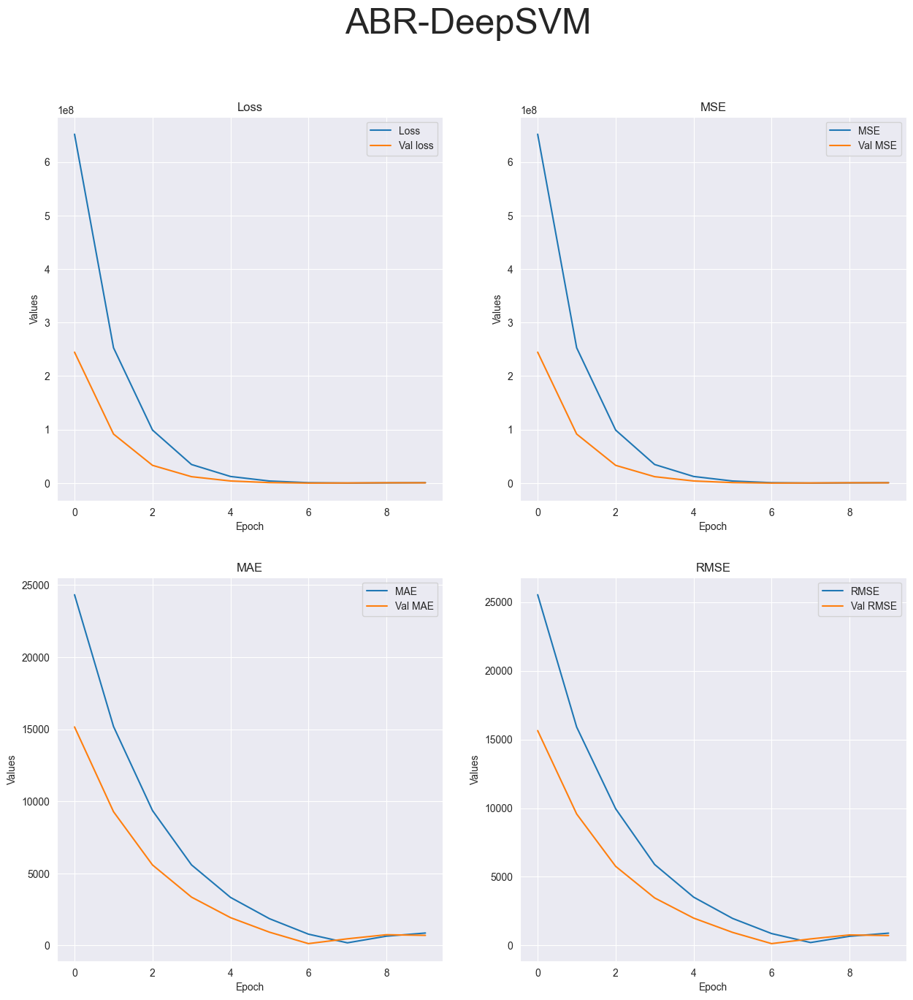

R-squared value: -818060.7043


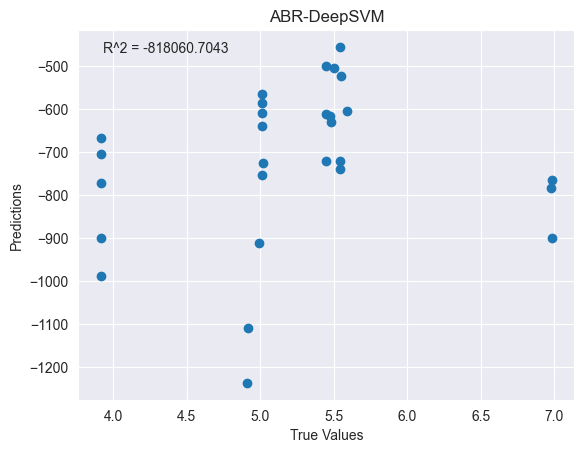

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_96"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_289 (Dense)           (None, 128)               1664      
                                                                 
 dense_290 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Train

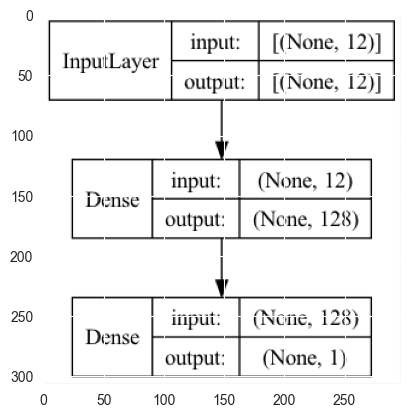

Epoch 1/20


2023-05-02 02:05:35.290279: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 164ms/step - loss: 599190976.0000 - mse: 599190976.0000 - mae: 23420.2246 - root_mean_squared_error: 24478.3770 - val_loss: 313511264.0000 - val_mse: 313511264.0000 - val_mae: 17126.4395 - val_root_mean_squared_error: 17706.2500
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 356684608.0000 - mse: 356684608.0000 - mae: 17972.0957 - root_mean_squared_error: 18886.0957

2023-05-02 02:05:35.752682: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 40ms/step - loss: 240771632.0000 - mse: 240771632.0000 - mae: 14635.2725 - root_mean_squared_error: 15516.8174 - val_loss: 115205512.0000 - val_mse: 115205512.0000 - val_mae: 10379.5596 - val_root_mean_squared_error: 10733.3828
Epoch 3/20
3/3 [==============================] - 0s 60ms/step - loss: 87668152.0000 - mse: 87668152.0000 - mae: 8822.7236 - root_mean_squared_error: 9363.1270 - val_loss: 41659720.0000 - val_mse: 41659720.0000 - val_mae: 6239.9546 - val_root_mean_squared_error: 6454.4341
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 31638050.0000 - mse: 31638050.0000 - mae: 5302.9644 - root_mean_squared_error: 5624.7710 - val_loss: 14783914.0000 - val_mse: 14783914.0000 - val_mae: 3715.9060 - val_root_mean_squared_error: 3844.9856
Epoch 5/20
3/3 [==============================] - 0s 23ms/step - loss: 11125181.0000 - mse: 11125181.0000 - mae: 3135.0515 - root_mean_squared_error: 3335.4431 - val_loss: 4673012.0000

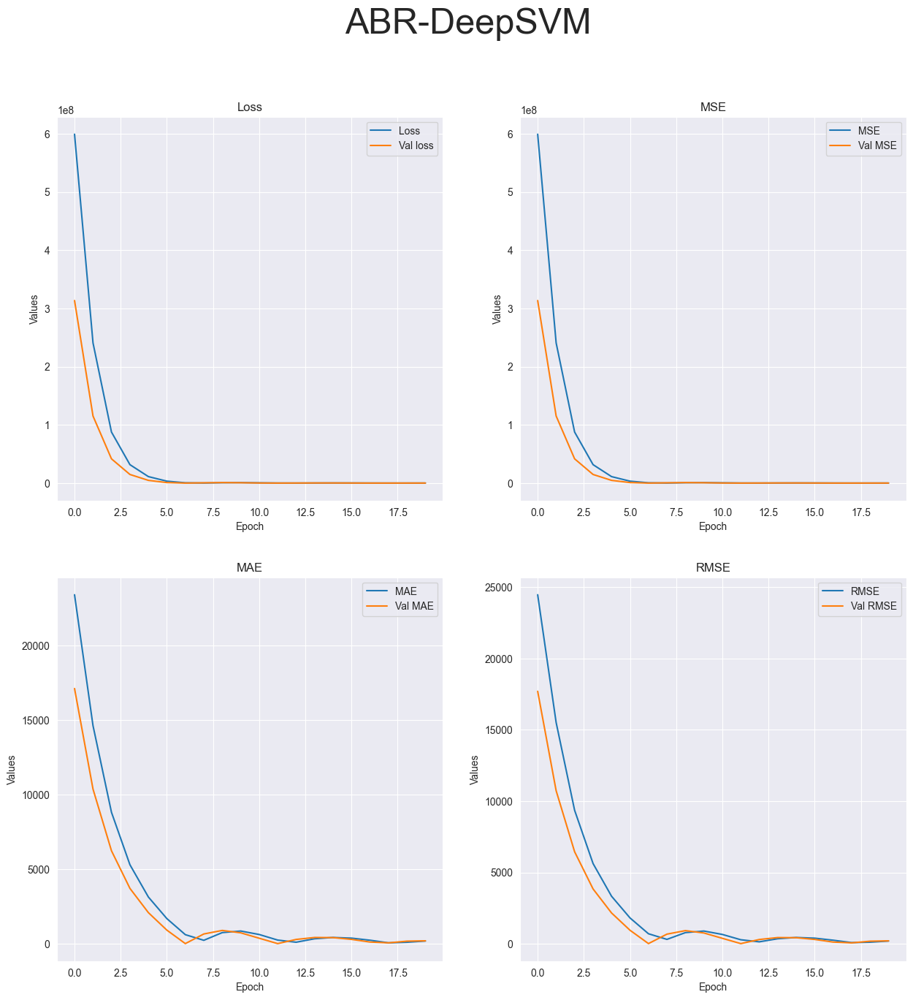

R-squared value: -61781.5542


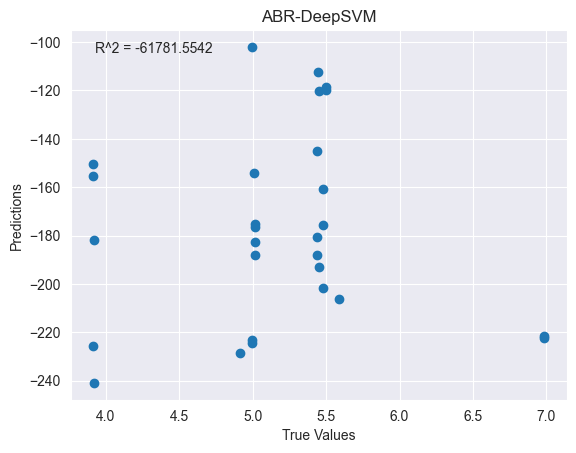

Running MachineLearning tests...
Running tests on CGBR.csv dataset...
Running Linear model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Running SVR model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
plotting linear


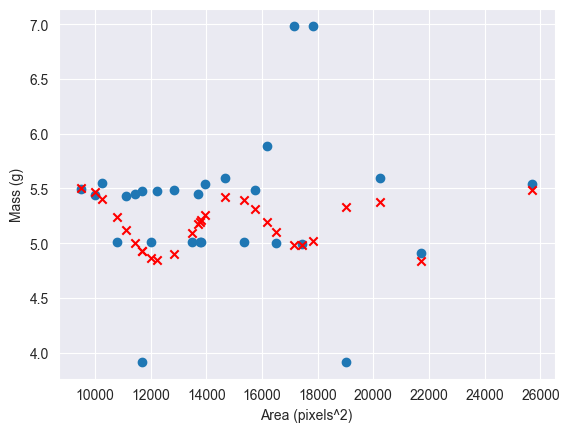

R-squared value: -0.1846


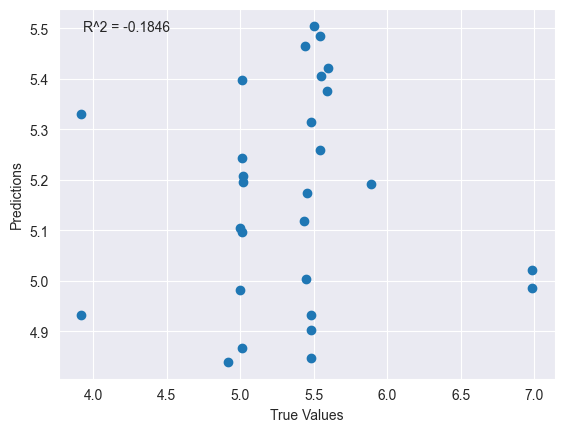

Running Images tests...
Running tests on CIBR.pkl dataset...
Running CNN model tests...
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_97"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 69, 69, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 33, 33, 

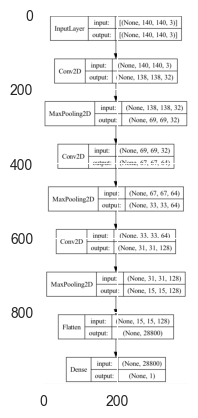

Epoch 1/2


2023-05-02 02:05:40.331813: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2383.8804 - mse: 2383.8804 - mae: 32.2217 - root_mean_squared_error: 48.8250

2023-05-02 02:05:41.563601: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 428ms/step - loss: 2383.8804 - mse: 2383.8804 - mae: 32.2217 - root_mean_squared_error: 48.8250 - val_loss: 34.7236 - val_mse: 34.7236 - val_mae: 5.8303 - val_root_mean_squared_error: 5.8927
Epoch 2/2
1/1 [==============================] - 0s 187ms/step - loss: 6.7277 - mse: 6.7277 - mae: 2.4757 - root_mean_squared_error: 2.5938
Test loss: [6.727710247039795, 6.727710247039795, 2.4757368564605713, 2.593782901763916]
['loss', 'mse', 'mae', 'root_mean_squared_error']


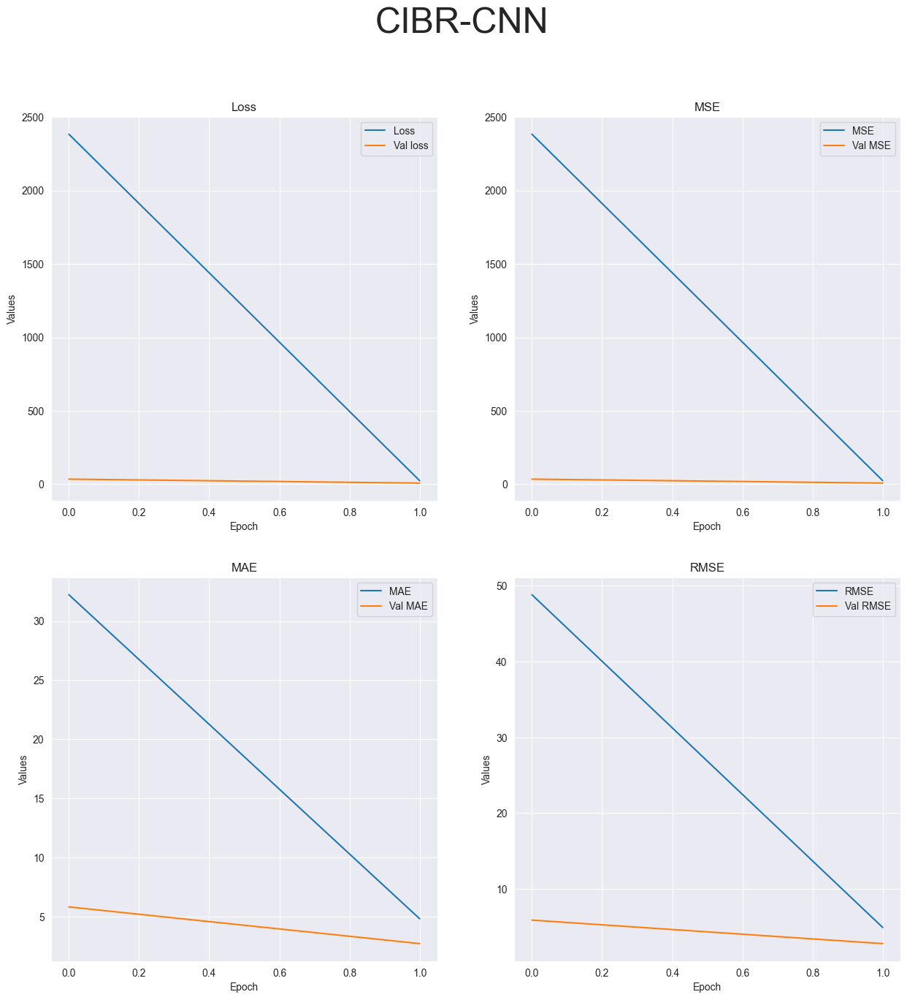

R-squared value: -9.6542


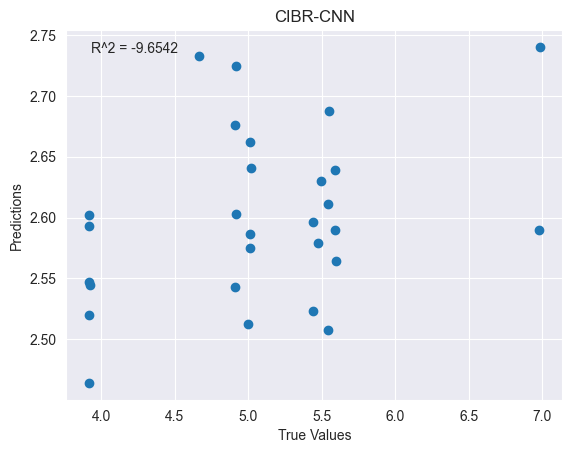

Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_98"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 69, 69, 32)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 33, 33, 64)       0         
 2D)                                                             
 

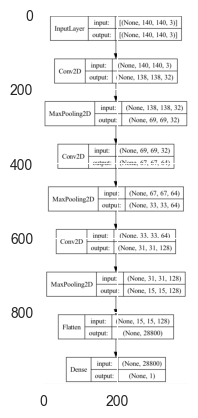

Epoch 1/2


2023-05-02 02:05:45.216822: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 328ms/step - loss: 3178.7402 - mse: 3178.7402 - mae: 34.0248 - root_mean_squared_error: 56.3803 - val_loss: 34.2973 - val_mse: 34.2973 - val_mae: 5.8128 - val_root_mean_squared_error: 5.8564
Epoch 2/2


2023-05-02 02:05:46.111105: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 137ms/step - loss: 11.5937 - mse: 11.5937 - mae: 3.3592 - root_mean_squared_error: 3.4050
Test loss: [11.593728065490723, 11.593728065490723, 3.35923433303833, 3.404956340789795]
['loss', 'mse', 'mae', 'root_mean_squared_error']


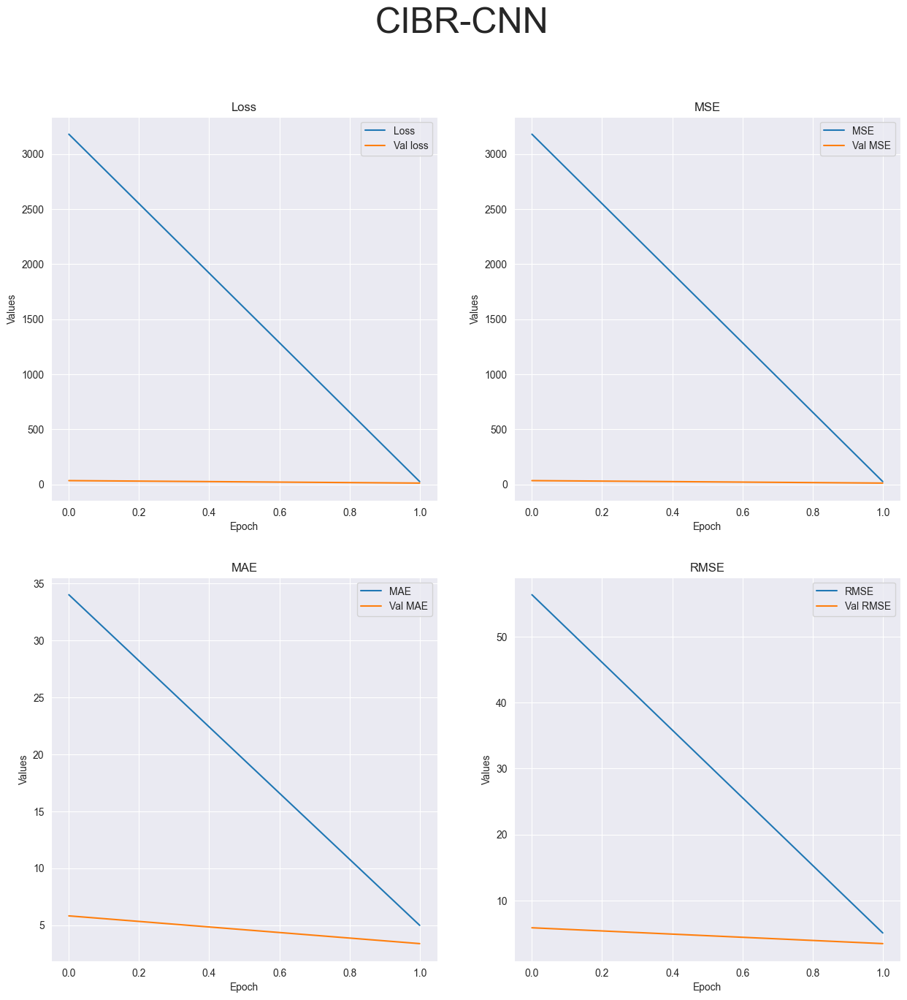

R-squared value: -36.5397


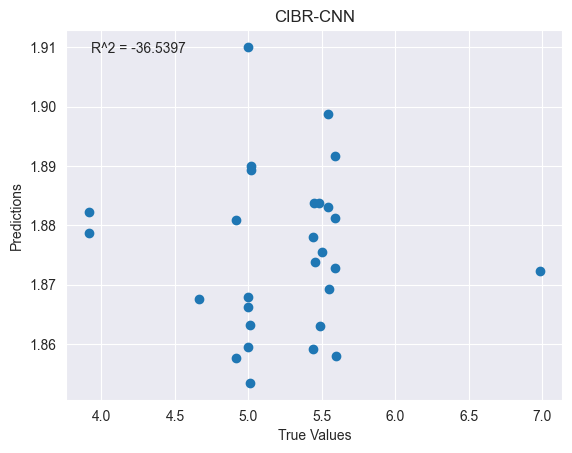

Running tests with 1 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_99"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 69, 69, 32)       0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 33, 33, 64)       0         
 2D)                                                             
 

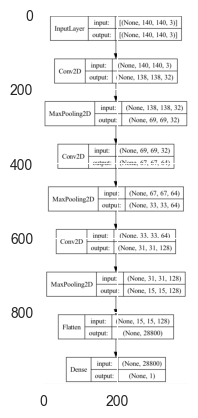

2023-05-02 02:05:49.534265: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2957.4495 - mse: 2957.4495 - mae: 33.1737 - root_mean_squared_error: 54.3824

2023-05-02 02:05:51.067661: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 128ms/step - loss: 29.6431 - mse: 29.6431 - mae: 5.4117 - root_mean_squared_error: 5.4445
Test loss: [29.643102645874023, 29.643102645874023, 5.411708354949951, 5.4445481300354]
['loss', 'mse', 'mae', 'root_mean_squared_error']


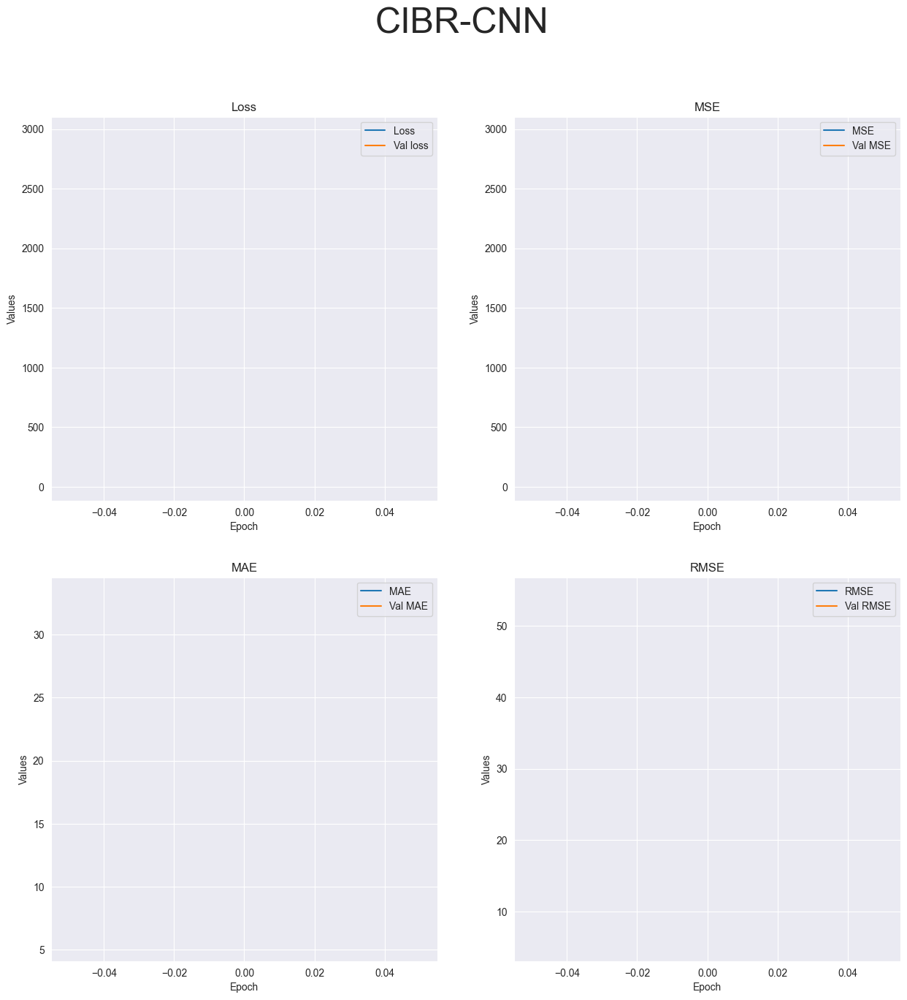

R-squared value: -80.7629


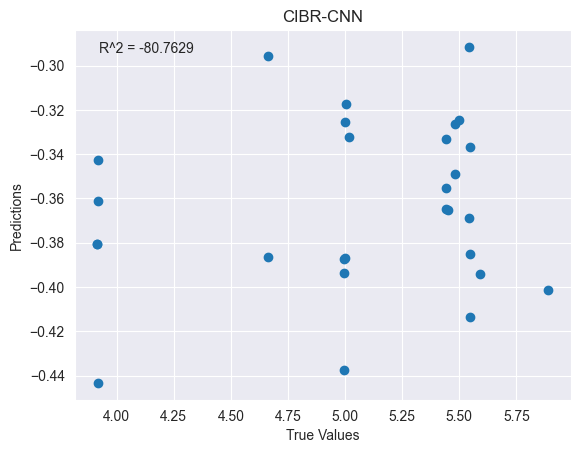

Running tests with 4 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_100"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 69, 69, 32)       0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


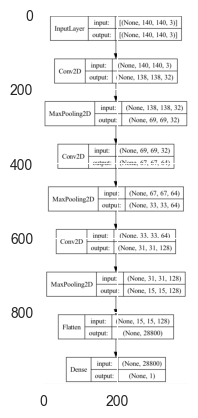

Epoch 1/4


2023-05-02 02:05:54.393660: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2056.4548 - mse: 2056.4548 - mae: 29.8800 - root_mean_squared_error: 45.3482

2023-05-02 02:05:55.526218: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 402ms/step - loss: 2056.4548 - mse: 2056.4548 - mae: 29.8800 - root_mean_squared_error: 45.3482 - val_loss: 26.1473 - val_mse: 26.1473 - val_mae: 5.0733 - val_root_mean_squared_error: 5.1134
Epoch 2/4
3/3 [==============================] - 0s 100ms/step - loss: 20.5813 - mse: 20.5813 - mae: 4.4497 - root_mean_squared_error: 4.5367 - val_loss: 1.4068 - val_mse: 1.4068 - val_mae: 1.0394 - val_root_mean_squared_error: 1.1861
Epoch 3/4
3/3 [==============================] - 0s 96ms/step - loss: 20.4411 - mse: 20.4411 - mae: 3.2610 - root_mean_squared_error: 4.5212 - val_loss: 4.3170 - val_mse: 4.3170 - val_mae: 1.9703 - val_root_mean_squared_error: 2.0777
Epoch 4/4
1/1 [==============================] - 0s 153ms/step - loss: 12.7704 - mse: 12.7704 - mae: 3.5273 - root_mean_squared_error: 3.5736
Test loss: [12.770406723022461, 12.770406723022461, 3.5272974967956543, 3.573570489883423]
['loss', 'mse', 'mae', 'root_mean_squared_error']


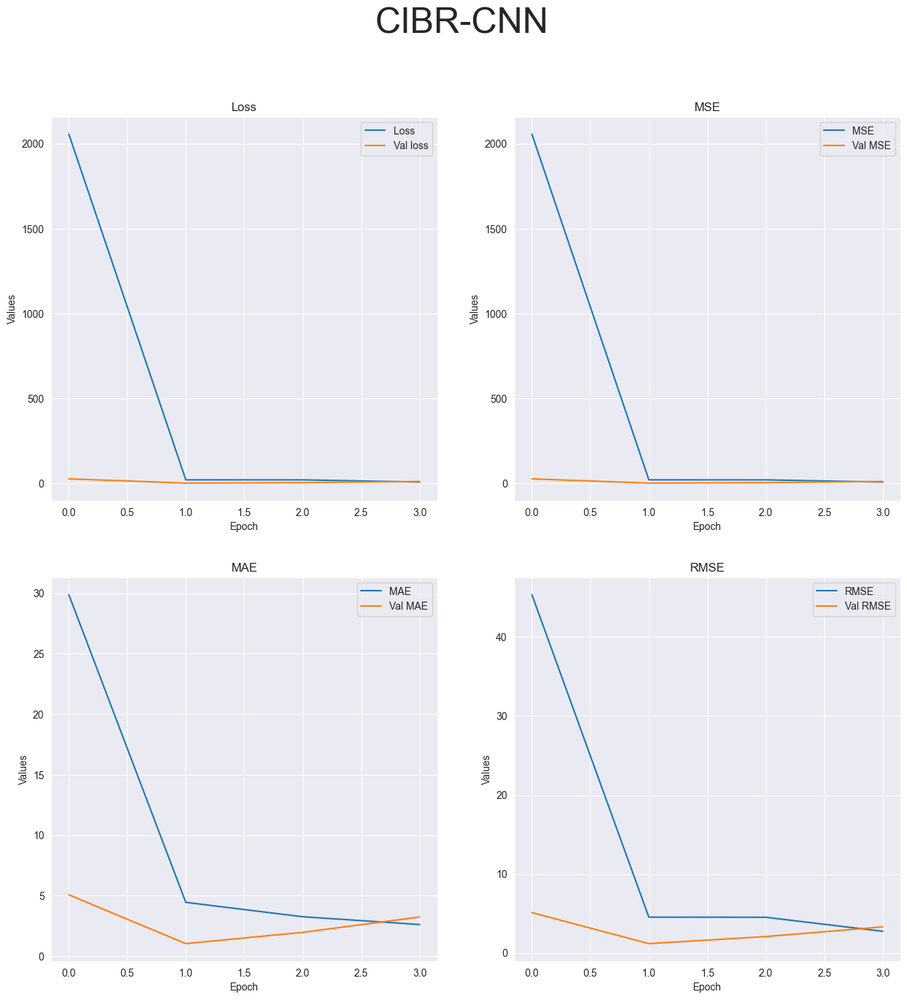

R-squared value: -36.3548


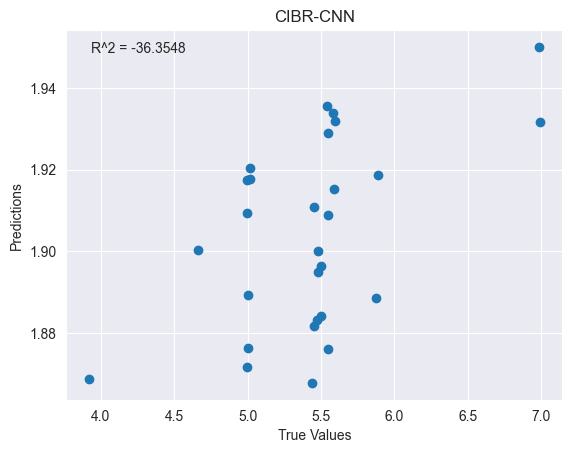

Running RestNet model tests...
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
Running tests with 1 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
Running tests with 4 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
Runni

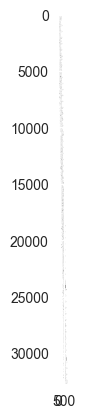

ValueError: Failed to convert a NumPy array to a Tensor (Unsupported object type numpy.ndarray).

In [38]:
for experiment_name, experiment_data in RawExperiments.items():
    print(f"Running experiments for {experiment_name}...")
    for test_name, test_data in experiment_data["Tests"].items():
        print(f"Running {test_name} tests...")
        for dataset in test_data["Datasets"]:
            print(f"Running tests on {dataset + test_data['Extention']} dataset...")
            for model in test_data["Models"]:
                print(f"Running {model} model tests...")
                if "Epochs" in test_data:
                    for epochs in test_data["Epochs"]:
                        print(f"Running tests with {epochs} epochs...")

                        # Call the function that runs the test with the given dataset, model, and epoch

                        dataframe = None
                        if(test_data["Extention"] == '.pkl'):
                            dataframe = pd.read_pickle(dataset + test_data['Extention'])
                        else:
                            dataframe = pd.read_csv(dataset + test_data['Extention'])
                        test = AutomaticLearning(dataframe, dataset + "-" + model, model)
                        test.buildData()
                        test.buildModel()
                        test.train(epochs)
                        test.plot()


In [ ]:

testcnn = AutomaticLearning(pd.read_pickle("croppedimagesRaspberriesRaw.pkl"), "CIRR-ResNet", "ResNet")
testcnn.buildData()
testcnn.buildModel()
testcnn.train(40)
testcnn.plot()

   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
plotting linear


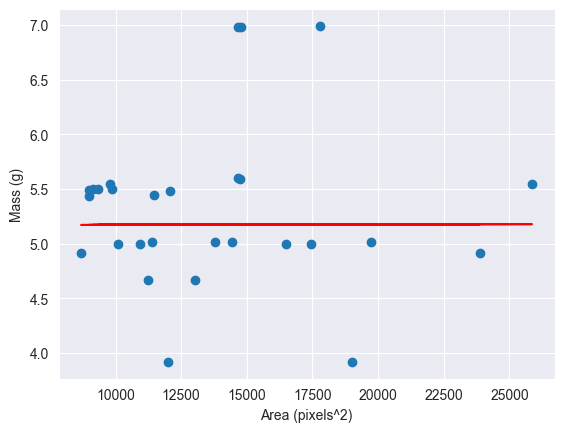

R-squared value: -0.0347


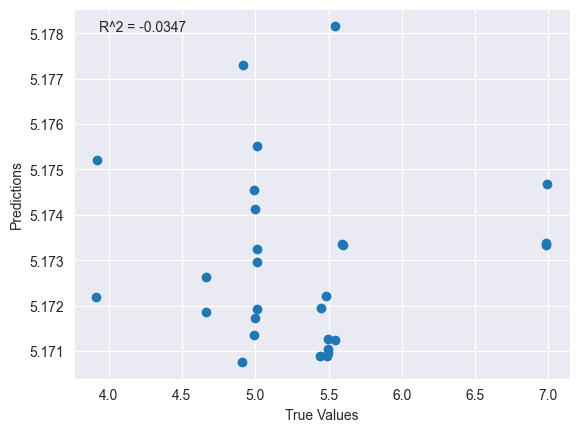

In [39]:
testcnn = AutomaticLearning(pd.read_csv("CGBR.csv"), "CGBR-Linear", "linear")
testcnn.buildData()
testcnn.buildModel()
testcnn.train(40)
testcnn.plot()


plotting linear


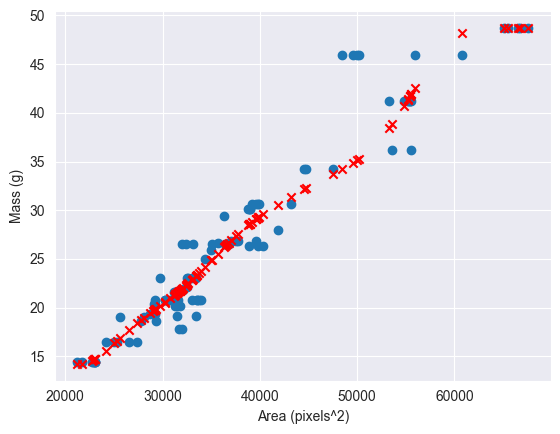

R-squared value: 0.9178


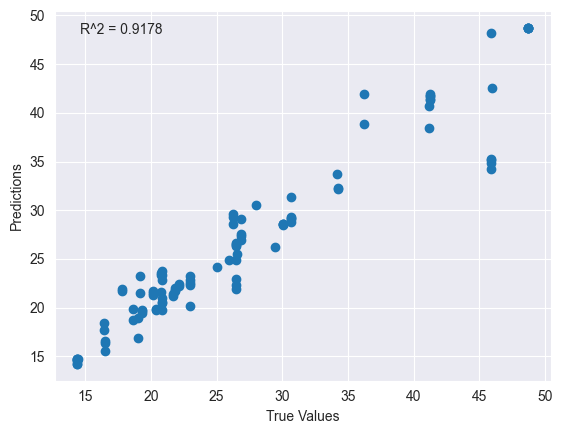

In [8]:

testsvr = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaSVR")
testsvr.buildData()
testsvr.buildModel("SVR")
testsvr.train(2200)
testsvr.plot()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 64)                832       
                                                                 
 dense_9 (Dense)             (None, 32)                2080      
                                                                 
 dense_10 (Dense)            (None, 16)                528       
                                                                 
 dense_11 (Dense)            (None, 1)                 17        
                                                                 
Total params: 3,457
Trainable params: 3,457
Non-trainable params: 0
_________________________________________________________________
None


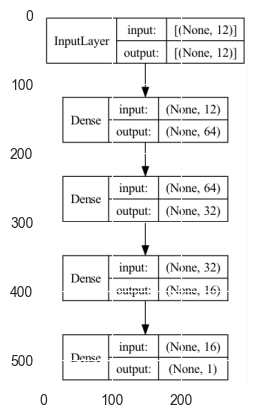

Epoch 1/10
 1/11 [=>............................] - ETA: 5s - loss: 377022.3750 - mse: 377022.3750 - mae: 587.8816 - root_mean_squared_error: 614.0215

2023-04-29 04:02:14.868265: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 31ms/step - loss: 15895854.0000 - mse: 15895854.0000 - mae: 2913.8459 - root_mean_squared_error: 3986.9604 - val_loss: 101860.9062 - val_mse: 101860.9062 - val_mae: 307.9383 - val_root_mean_squared_error: 319.1566
Epoch 2/10
 8/11 [====================>.........] - ETA: 0s - loss: 976481.5000 - mse: 976481.5000 - mae: 914.2033 - root_mean_squared_error: 988.1708

2023-04-29 04:02:15.240663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 0s 11ms/step - loss: 946390.3125 - mse: 946390.3125 - mae: 904.1191 - root_mean_squared_error: 972.8259 - val_loss: 377234.4062 - val_mse: 377234.4062 - val_mae: 592.2183 - val_root_mean_squared_error: 614.1941
Epoch 3/10
11/11 [==============================] - 0s 11ms/step - loss: 122046.0703 - mse: 122046.0703 - mae: 296.6097 - root_mean_squared_error: 349.3509 - val_loss: 3624.8376 - val_mse: 3624.8376 - val_mae: 57.6960 - val_root_mean_squared_error: 60.2066
Epoch 4/10
11/11 [==============================] - 0s 11ms/step - loss: 737.0602 - mse: 737.0602 - mae: 19.2511 - root_mean_squared_error: 27.1489 - val_loss: 249.6129 - val_mse: 249.6129 - val_mae: 15.3938 - val_root_mean_squared_error: 15.7991
Epoch 5/10
11/11 [==============================] - 0s 10ms/step - loss: 384.6152 - mse: 384.6152 - mae: 18.9756 - root_mean_squared_error: 19.6116 - val_loss: 388.4864 - val_mse: 388.4864 - val_mae: 19.1997 - val_root_mean_squared_error: 19.71

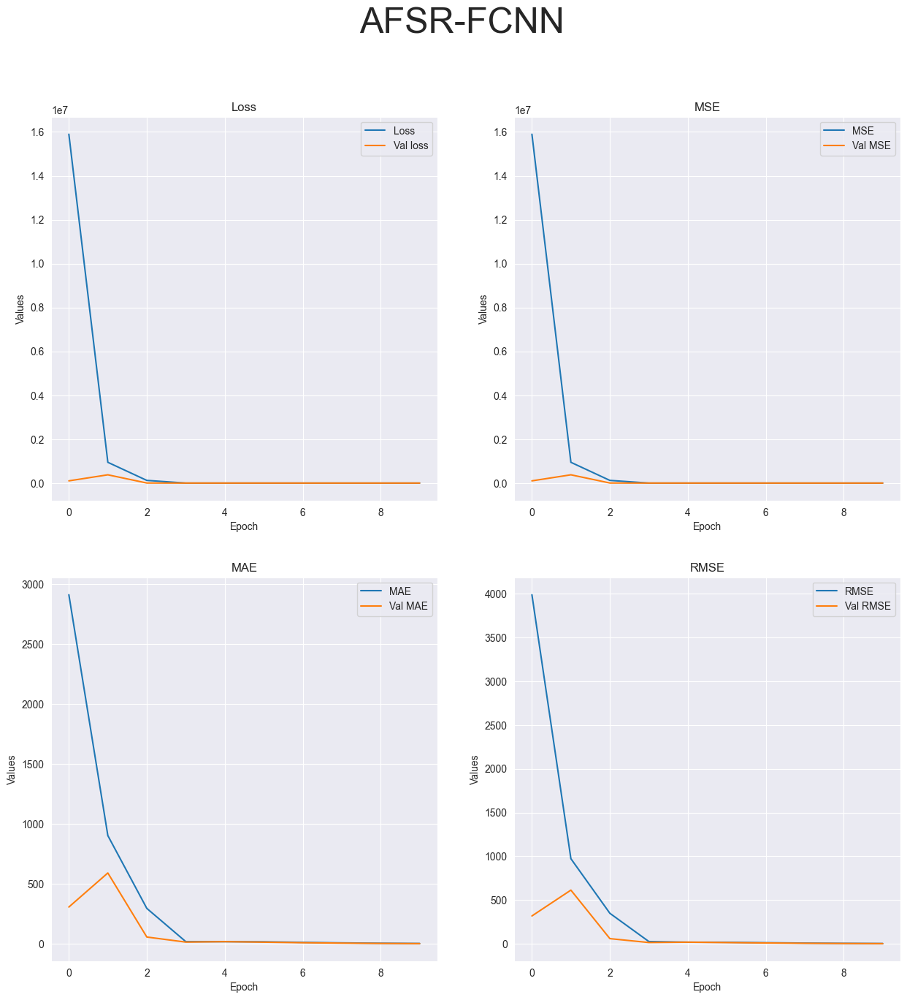

R-squared value: 0.8525


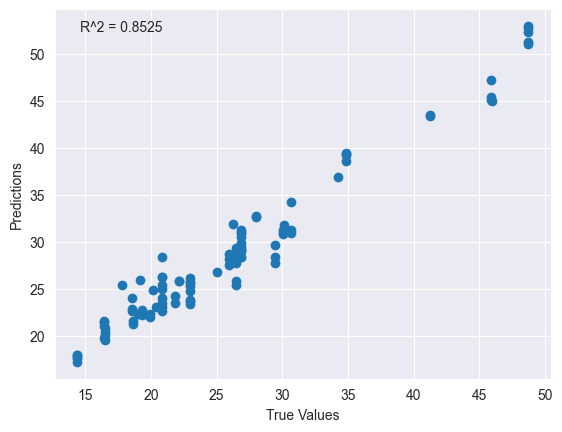

In [13]:

muchas = AutomaticLearning(pd.read_csv("allfeaturesStrawberriesRaw.csv"), "AFSR-FCNN")
muchas.buildData()
muchas.buildModel("FCNN")
muchas.train(10)
muchas.plot()

plotting linear


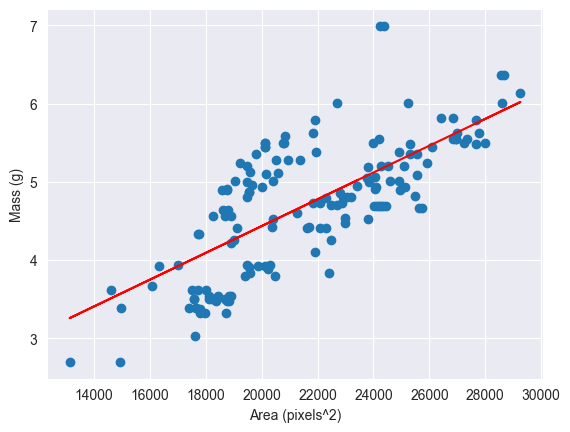

R-squared value: 0.5422


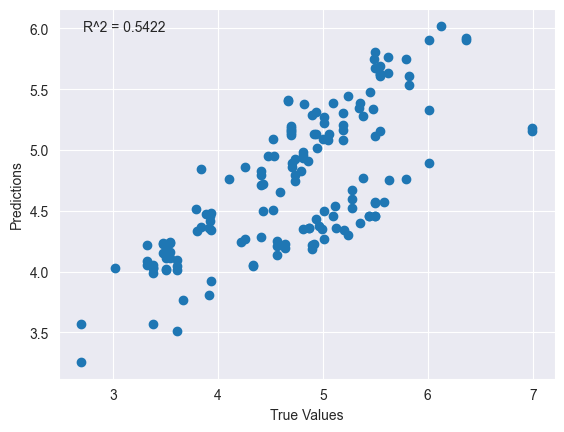

plotting linear


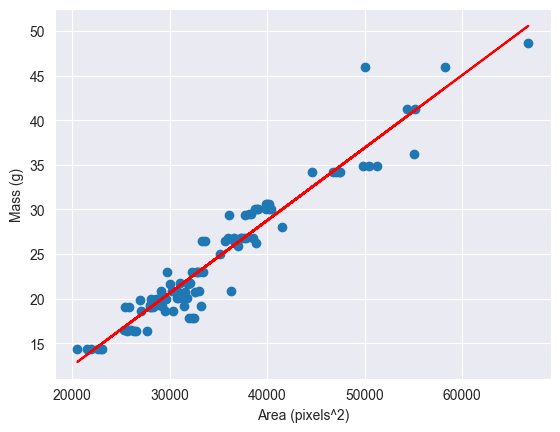

R-squared value: 0.9251


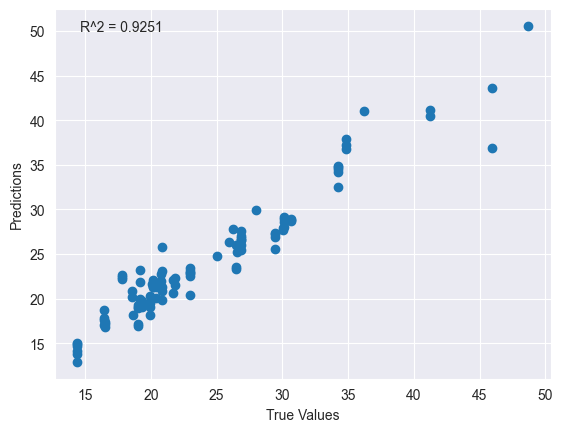

plotting linear


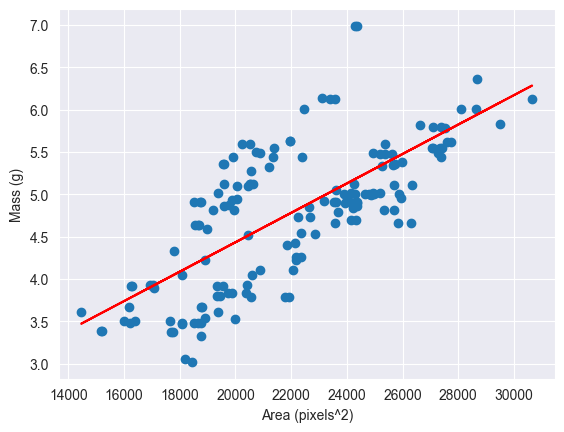

R-squared value: 0.5080


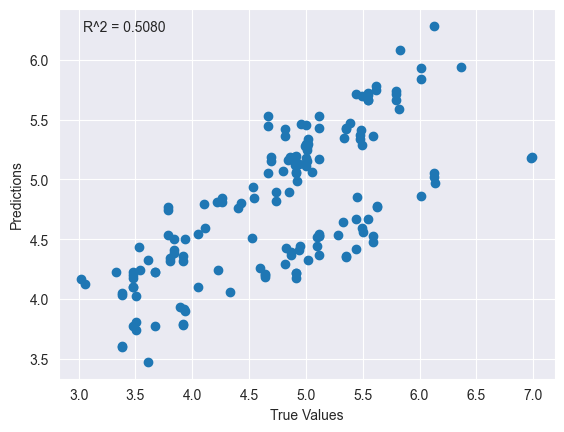

plotting linear


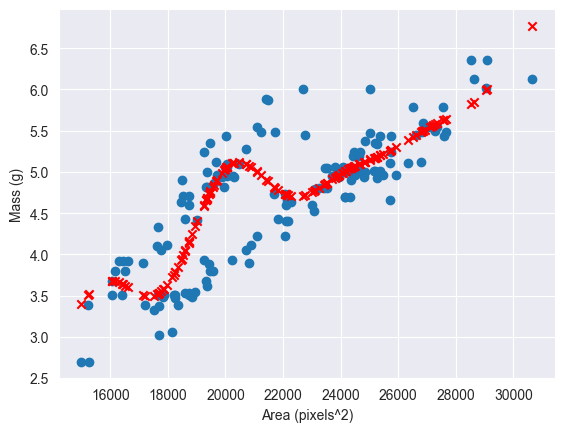

R-squared value: 0.6757


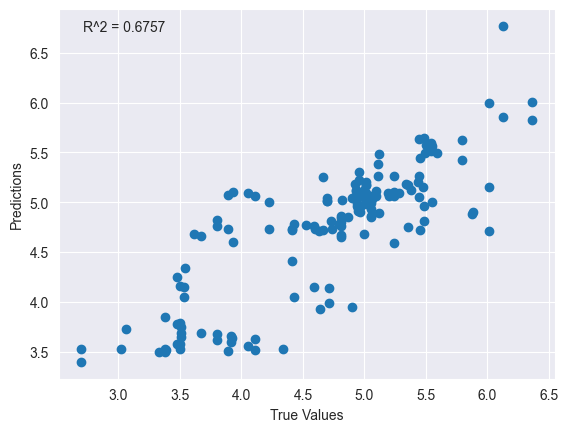

Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_369 (Dense)           (None, 64)                192       
                                                                 
 dropout_112 (Dropout)       (None, 64)                0         
                                                                 
 dense_370 (Dense)           (None, 32)                2080      
                                                                 
 dropout_113 (Dropout)       (None, 32)                0         
                                                                 
 dense_371 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:10.454677: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664

2023-04-29 03:39:11.773911: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 64ms/step - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664 - val_loss: 57952.4336 - val_mse: 57952.4336 - val_mae: 237.5029 - val_root_mean_squared_error: 240.7331
Epoch 2/5
16/16 [==============================] - 0s 16ms/step - loss: 50696.3398 - mse: 50696.3398 - mae: 166.3529 - root_mean_squared_error: 225.1585 - val_loss: 920.8993 - val_mse: 920.8993 - val_mae: 29.9157 - val_root_mean_squared_error: 30.3463
Epoch 3/5
16/16 [==============================] - 0s 18ms/step - loss: 4578.2466 - mse: 4578.2466 - mae: 48.7814 - root_mean_squared_error: 67.6627 - val_loss: 107.3159 - val_mse: 107.3159 - val_mae: 10.2257 - val_root_mean_squared_error: 10.3593
Epoch 4/5
16/16 [==============================] - 0s 14ms/step - loss: 2107.4727 - mse: 2107.4727 - mae: 35.8980 - root_mean_squared_error: 45.9072 - val_loss: 133.2910 - val_mse: 133.2910 - val_mae: 11.3972 - val_root_mean_squared_error: 11.5452

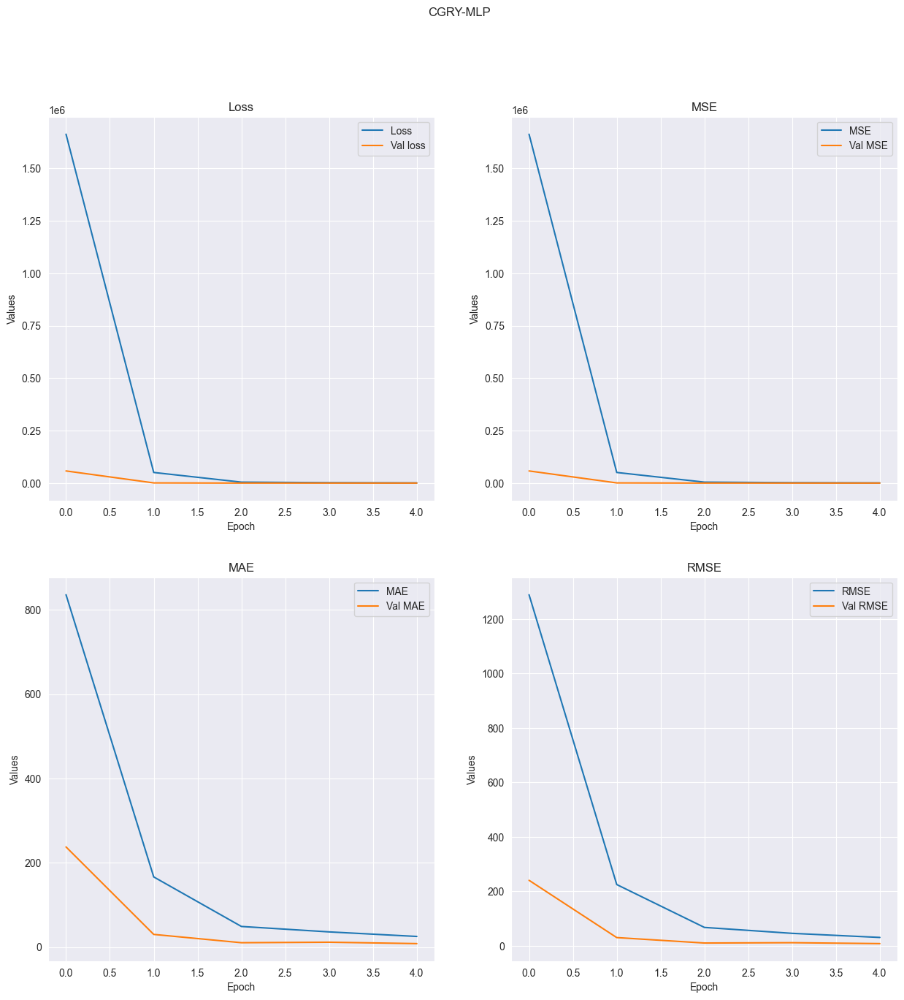

R-squared value: -122.9209


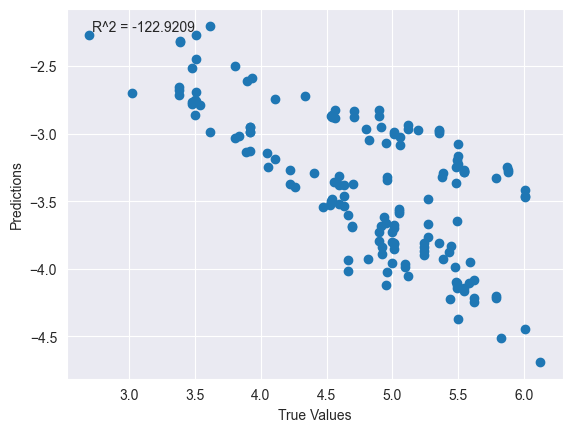

Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_372 (Dense)           (None, 64)                192       
                                                                 
 dropout_114 (Dropout)       (None, 64)                0         
                                                                 
 dense_373 (Dense)           (None, 32)                2080      
                                                                 
 dropout_115 (Dropout)       (None, 32)                0         
                                                                 
 dense_374 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:20.399078: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 

2023-04-29 03:39:21.810632: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 91ms/step - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 - val_loss: 166090.0469 - val_mse: 166090.0469 - val_mae: 389.9341 - val_root_mean_squared_error: 407.5415
Epoch 2/5
11/11 [==============================] - 0s 24ms/step - loss: 511054.8125 - mse: 511054.8125 - mae: 509.3962 - root_mean_squared_error: 714.8810 - val_loss: 57024.1289 - val_mse: 57024.1289 - val_mae: 228.5861 - val_root_mean_squared_error: 238.7973
Epoch 3/5
11/11 [==============================] - 0s 17ms/step - loss: 108829.0156 - mse: 108829.0156 - mae: 242.5318 - root_mean_squared_error: 329.8924 - val_loss: 6094.3706 - val_mse: 6094.3701 - val_mae: 74.8816 - val_root_mean_squared_error: 78.0664
Epoch 4/5
11/11 [==============================] - 0s 18ms/step - loss: 35150.0625 - mse: 35150.0625 - mae: 128.3465 - root_mean_squared_error: 187.4835 - val_loss: 115.6760 - val_mse: 115.6760 - val_mae: 10.3060 - val_root_mean

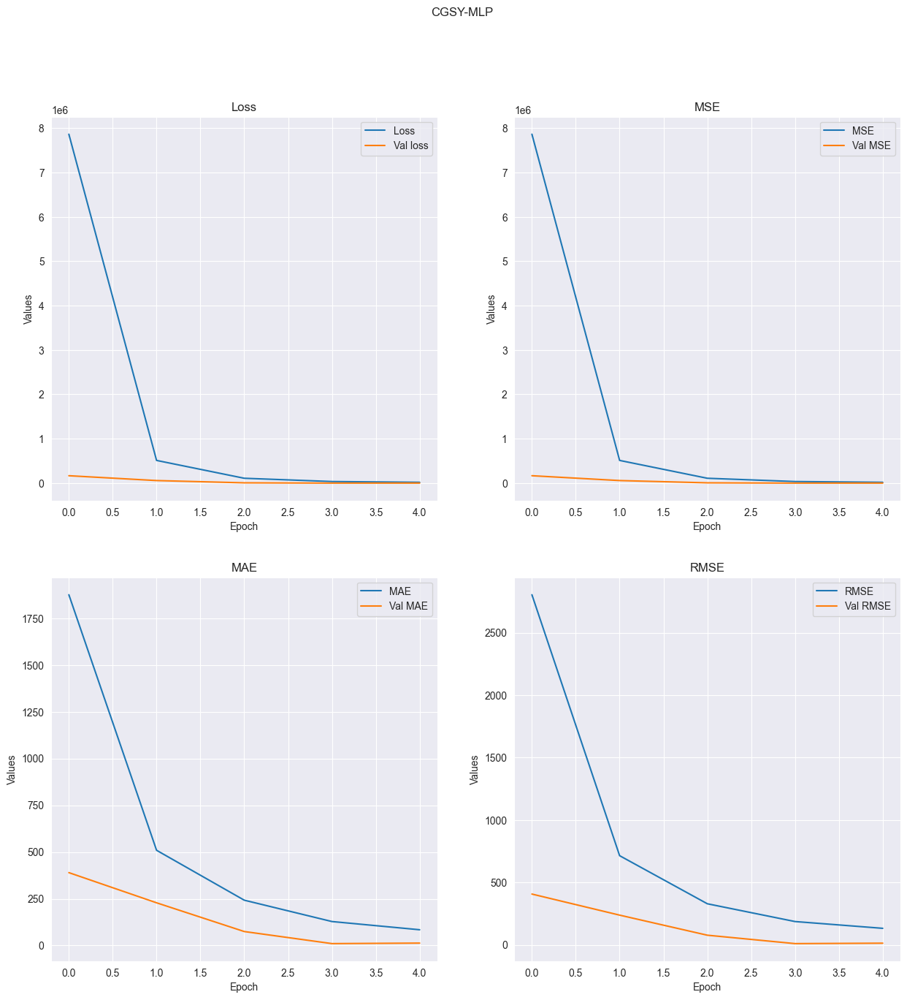

R-squared value: -0.7915


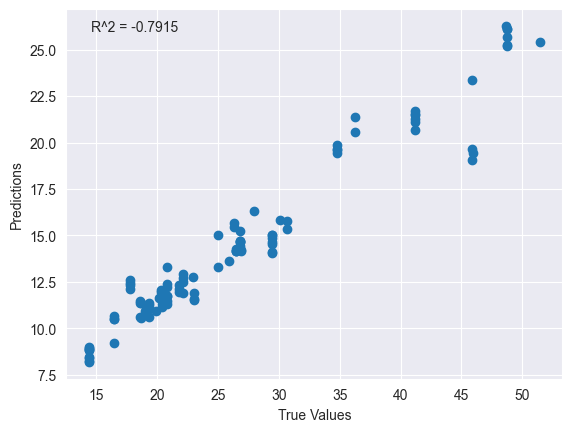

Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_375 (Dense)           (None, 64)                192       
                                                                 
 dense_376 (Dense)           (None, 32)                2080      
                                                                 
 dense_377 (Dense)           (None, 16)                528       
                                                                 
 dense_378 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:23.873785: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986

2023-04-29 03:39:24.804380: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 1s 56ms/step - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986 - val_loss: 555599.4375 - val_mse: 555599.4375 - val_mae: 735.9260 - val_root_mean_squared_error: 745.3854
Epoch 2/5
16/16 [==============================] - 0s 13ms/step - loss: 168030.3438 - mse: 168030.3438 - mae: 328.9428 - root_mean_squared_error: 409.9150 - val_loss: 46.6384 - val_mse: 46.6384 - val_mae: 6.6897 - val_root_mean_squared_error: 6.8292
Epoch 3/5
16/16 [==============================] - 0s 15ms/step - loss: 4408.6826 - mse: 4408.6826 - mae: 61.4353 - root_mean_squared_error: 66.3979 - val_loss: 6530.2080 - val_mse: 6530.2080 - val_mae: 79.7497 - val_root_mean_squared_error: 80.8097
Epoch 4/5
16/16 [==============================] - 0s 10ms/step - loss: 4162.0752 - mse: 4162.0752 - mae: 62.9008 - root_mean_squared_error: 64.5141 - val_loss: 1974.3805 - val_mse: 1974.3805 - val_mae: 43.8345 - val_root_mean_squared_error: 44

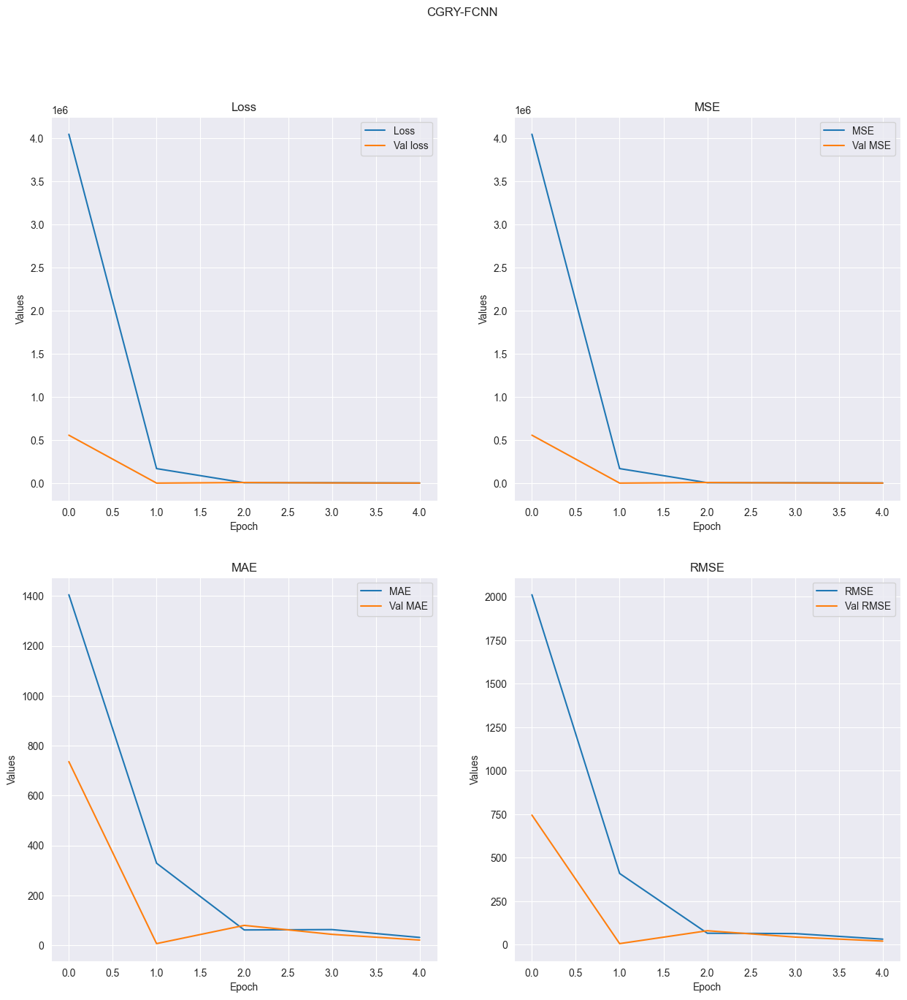

R-squared value: -738.7749


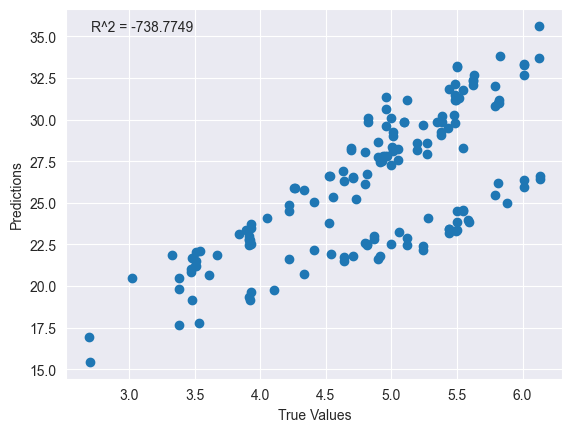

Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_379 (Dense)           (None, 64)                192       
                                                                 
 dense_380 (Dense)           (None, 32)                2080      
                                                                 
 dense_381 (Dense)           (None, 16)                528       
                                                                 
 dense_382 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:26.990116: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110

2023-04-29 03:39:28.050524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 93ms/step - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110 - val_loss: 729364.1250 - val_mse: 729364.1250 - val_mae: 819.8881 - val_root_mean_squared_error: 854.0282
Epoch 2/5
11/11 [==============================] - 0s 25ms/step - loss: 168845.9531 - mse: 168845.9531 - mae: 339.4226 - root_mean_squared_error: 410.9087 - val_loss: 94275.0938 - val_mse: 94275.0938 - val_mae: 294.4102 - val_root_mean_squared_error: 307.0425
Epoch 3/5
11/11 [==============================] - 0s 15ms/step - loss: 64092.6992 - mse: 64092.6992 - mae: 240.5644 - root_mean_squared_error: 253.1654 - val_loss: 26051.3789 - val_mse: 26051.3789 - val_mae: 154.6329 - val_root_mean_squared_error: 161.4044
Epoch 4/5
11/11 [==============================] - 0s 13ms/step - loss: 11585.3242 - mse: 11585.3242 - mae: 96.6171 - root_mean_squared_error: 107.6351 - val_loss: 786.8887 - val_mse: 786.8887 - val_mae: 26.5961 - val_root_m

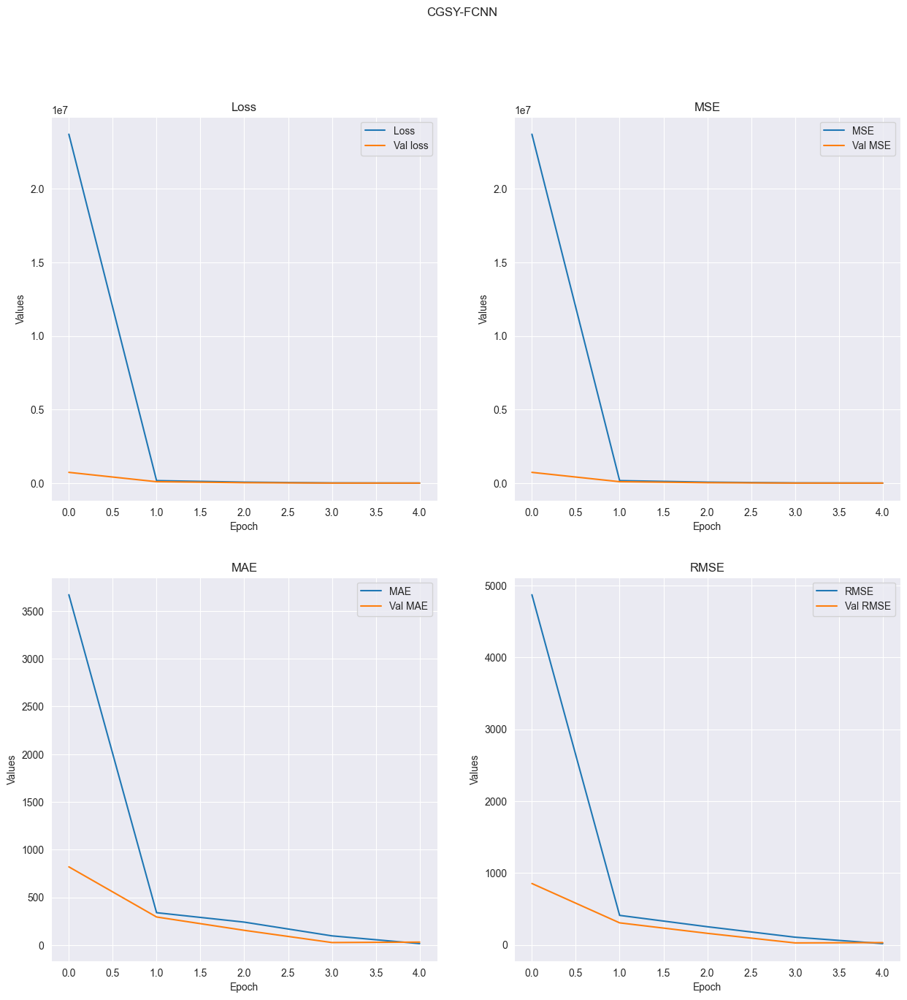

R-squared value: -14.0293


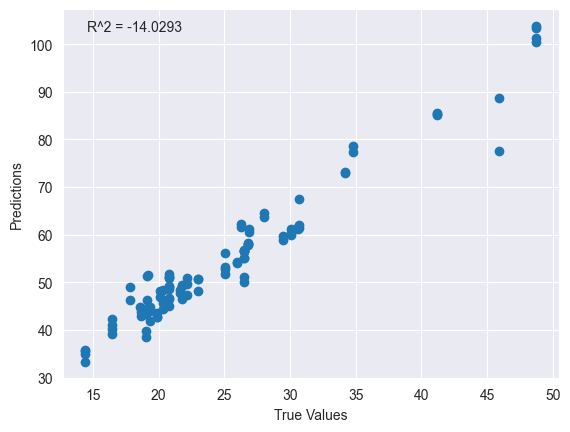

Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_383 (Dense)           (None, 64)                128       
                                                                 
 dense_384 (Dense)           (None, 32)                2080      
                                                                 
 dense_385 (Dense)           (None, 16)                528       
                                                                 
 dense_386 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/50


2023-04-29 03:39:30.141956: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521

2023-04-29 03:39:31.058009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 75ms/step - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521 - val_loss: 17714.7266 - val_mse: 17714.7266 - val_mae: 127.6721 - val_root_mean_squared_error: 133.0967
Epoch 2/50
11/11 [==============================] - 0s 17ms/step - loss: 932430.1250 - mse: 932430.1250 - mae: 873.2705 - root_mean_squared_error: 965.6242 - val_loss: 421392.2500 - val_mse: 421392.2500 - val_mae: 623.6829 - val_root_mean_squared_error: 649.1473
Epoch 3/50
11/11 [==============================] - 0s 18ms/step - loss: 122324.6250 - mse: 122324.6250 - mae: 275.8206 - root_mean_squared_error: 349.7494 - val_loss: 1564.3717 - val_mse: 1564.3717 - val_mae: 38.2025 - val_root_mean_squared_error: 39.5521
Epoch 4/50
11/11 [==============================] - 0s 16ms/step - loss: 17010.9688 - mse: 17010.9688 - mae: 118.5225 - root_mean_squared_error: 130.4261 - val_loss: 30145.5234 - val_mse: 30145.5234 - val_mae: 167.1085 - val

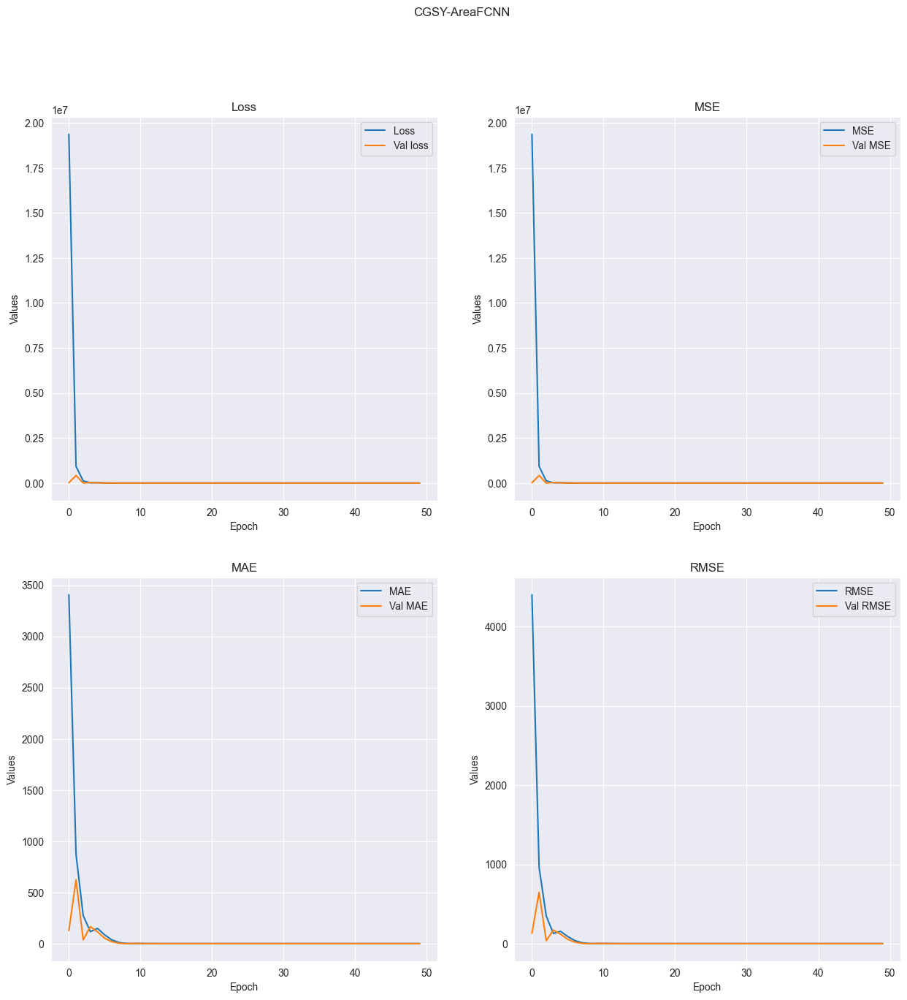

R-squared value: 0.9177


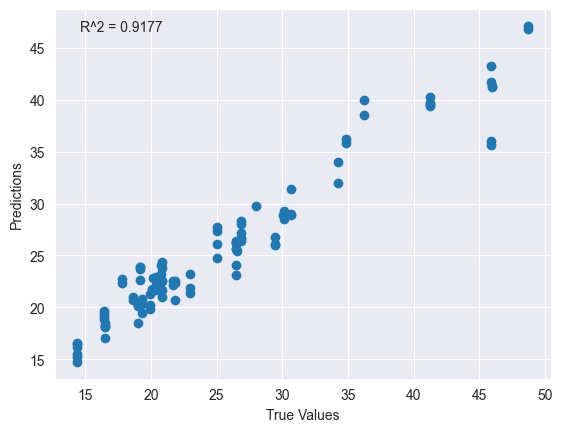

Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_387 (Dense)           (None, 64)                128       
                                                                 
 dense_388 (Dense)           (None, 32)                2080      
                                                                 
 dense_389 (Dense)           (None, 16)                528       
                                                                 
 dense_390 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/500


2023-04-29 03:39:38.776629: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674

2023-04-29 03:39:39.795213: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 77ms/step - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674 - val_loss: 210354.5625 - val_mse: 210354.5625 - val_mae: 439.0882 - val_root_mean_squared_error: 458.6443
Epoch 2/500
11/11 [==============================] - 0s 19ms/step - loss: 1217078.6250 - mse: 1217078.6250 - mae: 1023.1184 - root_mean_squared_error: 1103.2129 - val_loss: 458335.7188 - val_mse: 458335.7188 - val_mae: 648.2742 - val_root_mean_squared_error: 677.0049
Epoch 3/500
11/11 [==============================] - 0s 11ms/step - loss: 112703.7422 - mse: 112703.7422 - mae: 262.1600 - root_mean_squared_error: 335.7138 - val_loss: 812.6620 - val_mse: 812.6620 - val_mae: 27.4941 - val_root_mean_squared_error: 28.5072
Epoch 4/500
11/11 [==============================] - 0s 28ms/step - loss: 9231.3857 - mse: 9231.3857 - mae: 87.2979 - root_mean_squared_error: 96.0801 - val_loss: 18772.8359 - val_mse: 18772.8359 - val_mae: 131.5238 - 

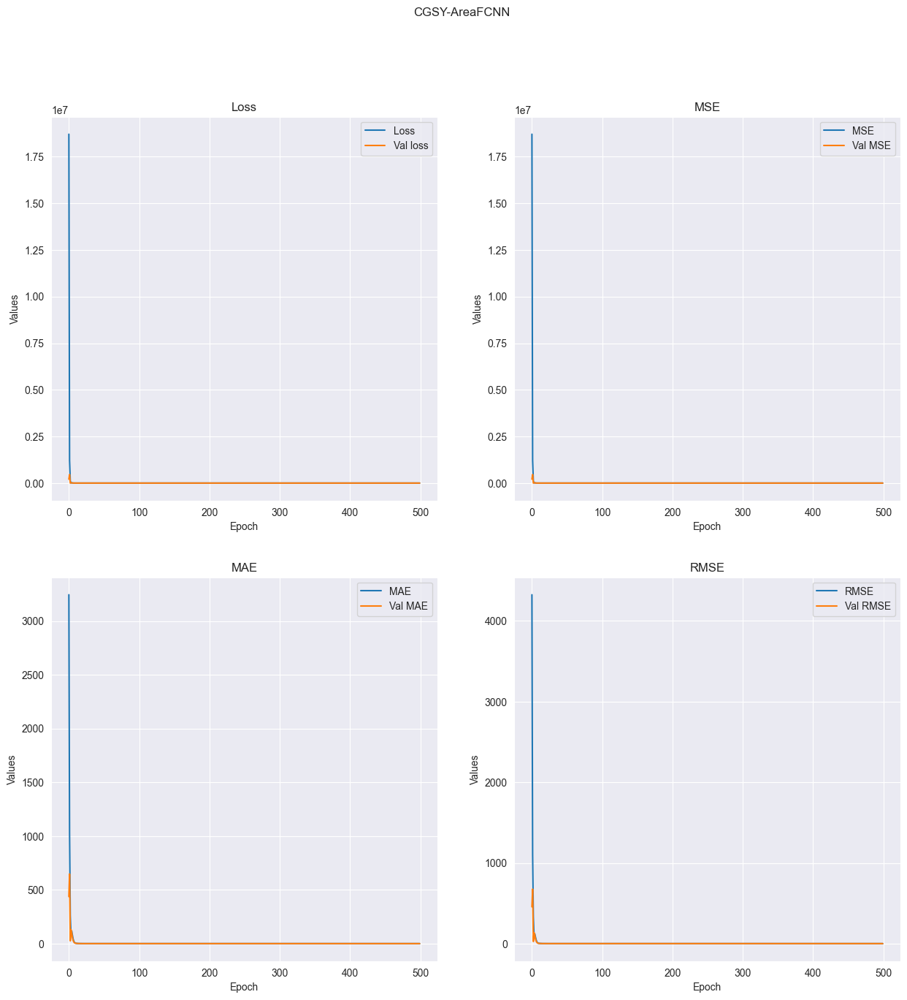

R-squared value: 0.8874


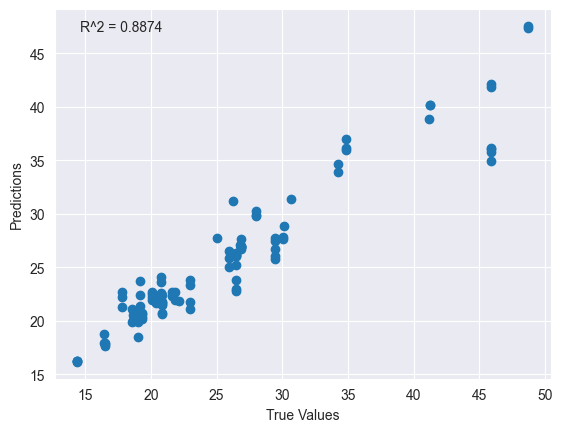

Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_391 (Dense)           (None, 64)                128       
                                                                 
 dense_392 (Dense)           (None, 32)                2080      
                                                                 
 dense_393 (Dense)           (None, 16)                528       
                                                                 
 dense_394 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/2200


2023-04-29 03:40:37.817394: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076

2023-04-29 03:40:38.868347: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 81ms/step - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076 - val_loss: 664391.3125 - val_mse: 664391.3125 - val_mae: 789.2724 - val_root_mean_squared_error: 815.1021
Epoch 2/2200
11/11 [==============================] - 0s 15ms/step - loss: 147479.4062 - mse: 147479.4062 - mae: 324.7747 - root_mean_squared_error: 384.0305 - val_loss: 90890.5234 - val_mse: 90890.5234 - val_mae: 291.6838 - val_root_mean_squared_error: 301.4806
Epoch 3/2200
11/11 [==============================] - 0s 15ms/step - loss: 62459.0117 - mse: 62459.0117 - mae: 238.3114 - root_mean_squared_error: 249.9180 - val_loss: 26080.6699 - val_mse: 26080.6699 - val_mae: 156.1575 - val_root_mean_squared_error: 161.4951
Epoch 4/2200
11/11 [==============================] - 0s 12ms/step - loss: 11361.0537 - mse: 11361.0537 - mae: 94.6271 - root_mean_squared_error: 106.5882 - val_loss: 620.5366 - val_mse: 620.5366 - val_mae: 23.8500 - v

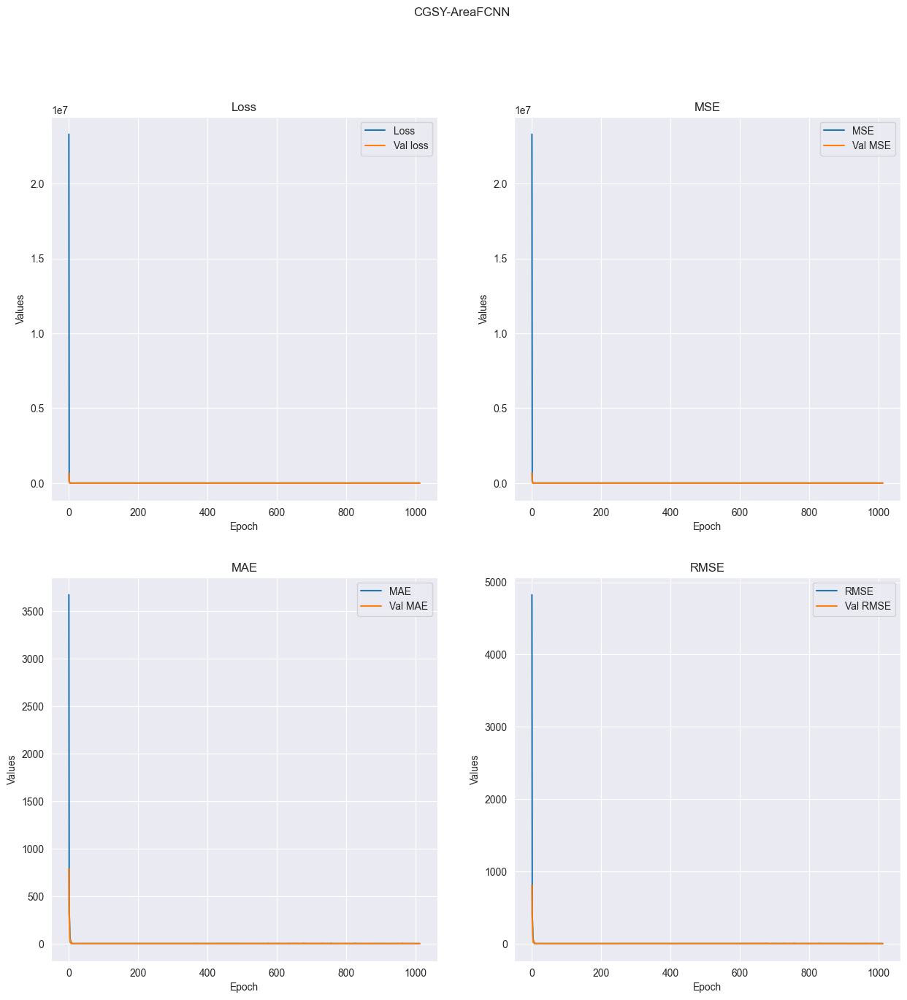

R-squared value: 0.9428


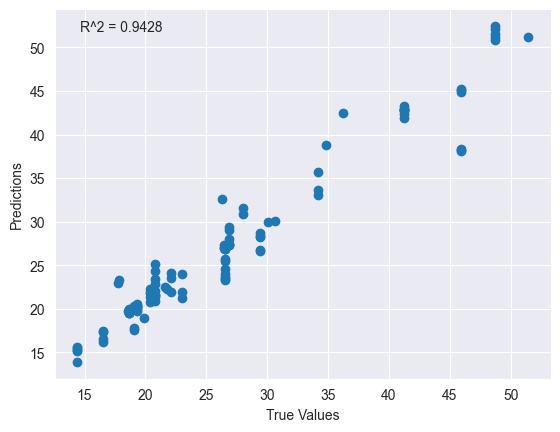

In [123]:

p3 = AutomaticLearning(pd.read_csv("classicgeometryRaspberriesRaw.csv").drop(["Roundness"], axis = 1), "CGRR-AreaLinear")
p3.buildData()
p3.buildModel("linear")
p3.train(2200)
p3.plot()

p1 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaLinear")
p1.buildData()
p1.buildModel("linear")
p1.train(2200)
p1.plot()

p2 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaLinear")
p2.buildData()
p2.buildModel("linear")
p2.train(2200)
p2.plot()


p4 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaSVR")
p4.buildData()
p4.buildModel("SVR")
p4.train(2200)
p4.plot()


p5 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-MLP")
p5.buildData()
p5.buildModel("MLP")
p5.train(5)
p5.plot()

p6 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-MLP")
p6.buildData()
p6.buildModel("MLP")
p6.train(5)
p6.plot()


p7 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-FCNN")
p7.buildData()
p7.buildModel("FCNN")
p7.train(5)
p7.plot()

p8 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-FCNN")
p8.buildData()
p8.buildModel("FCNN")
p8.train(5)
p8.plot()



p9 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p9.buildData()
p9.buildModel("FCNN")
p9.train(50)
p9.plot()


p10 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p10.buildData()
p10.buildModel("FCNN")
p10.train(500)
p10.plot()

p11 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p11.buildData()
p11.buildModel("FCNN")
p11.train(2200)
p11.plot()


